In [ ]:
# libraries
#%matplotlib notebook
import os
import pandas as pd
import numpy as np
import json
from scipy.signal import periodogram
from sklearn.metrics import confusion_matrix, average_precision_score
import matplotlib
import seaborn
import matplotlib.dates as md
from matplotlib import pyplot as plt
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dfsA1 = {}

# Loop through the range 1 to 67 (inclusive) and load data
for i in range(1, 68):
    file_path = f"/content/drive/My Drive/YAHOO/A1/Yahoo_A1real_{i}_data.out"
    dfsA1[i] = pd.read_csv(file_path, sep=",", names=[f"value_{i}", "label"])

## Exponential Smoothing

## A1A

## static

Dataset 1: Best k=3, MAE=0.05, Precision=0.09, Recall=1.00, F1=0.16


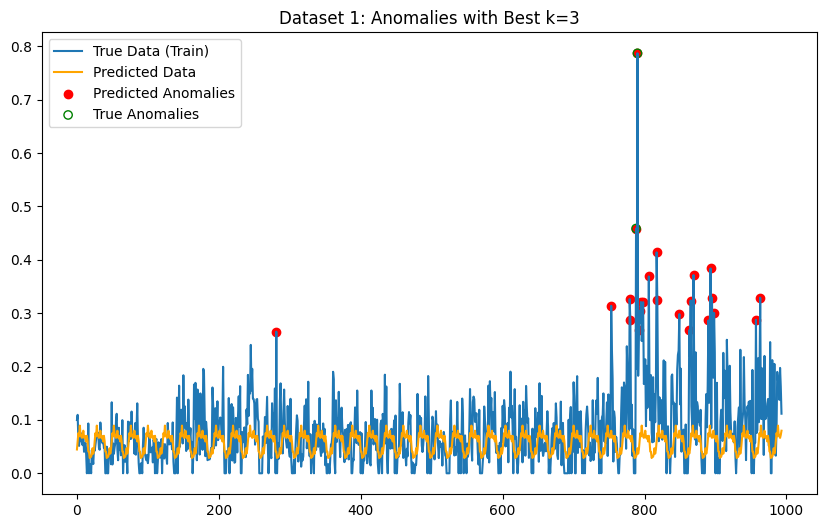

Dataset 2: Best k=1.5, MAE=4321.01, Precision=1.00, Recall=0.44, F1=0.81


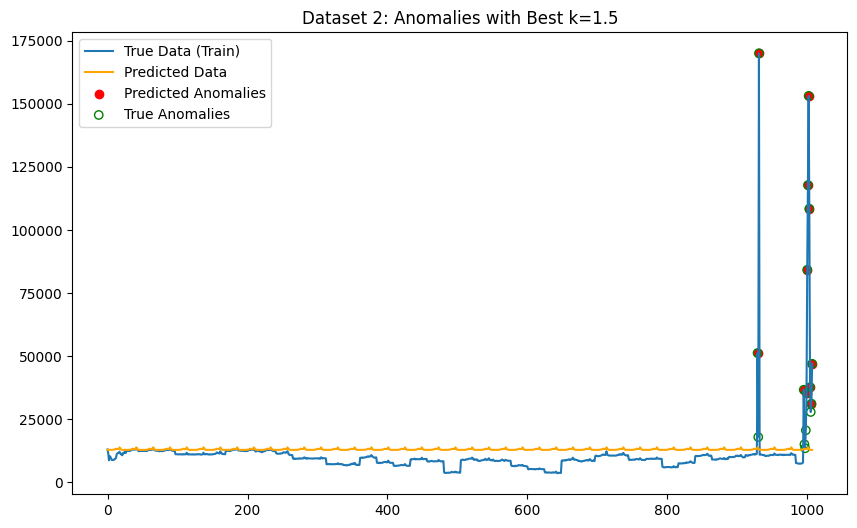

Dataset 3: Best k=1.5, MAE=0.23, Precision=1.00, Recall=0.93, F1=0.97


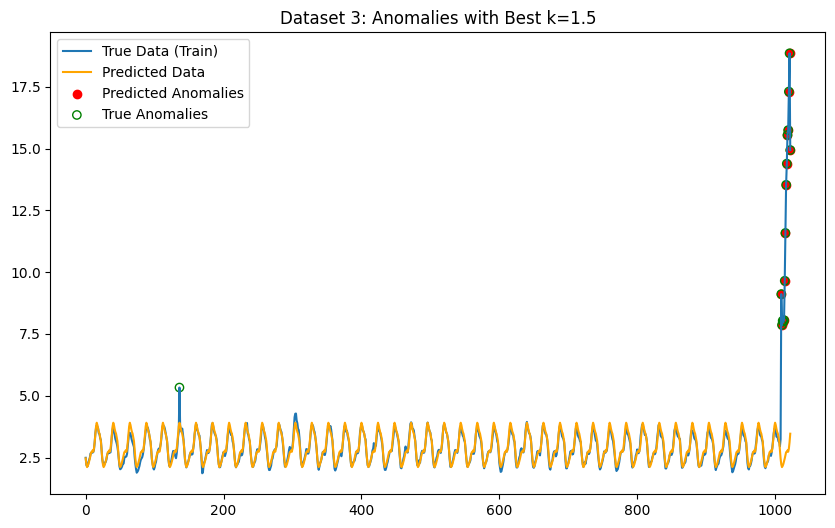

Dataset 8: Best k=3, MAE=104.82, Precision=0.77, Recall=1.00, F1=0.87


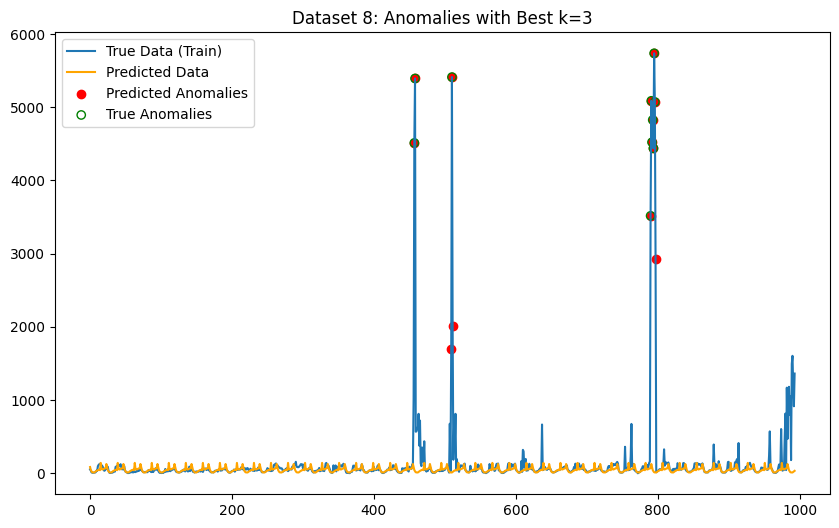

Dataset 9: Best k=1.5, MAE=0.01, Precision=0.75, Recall=0.38, F1=0.71


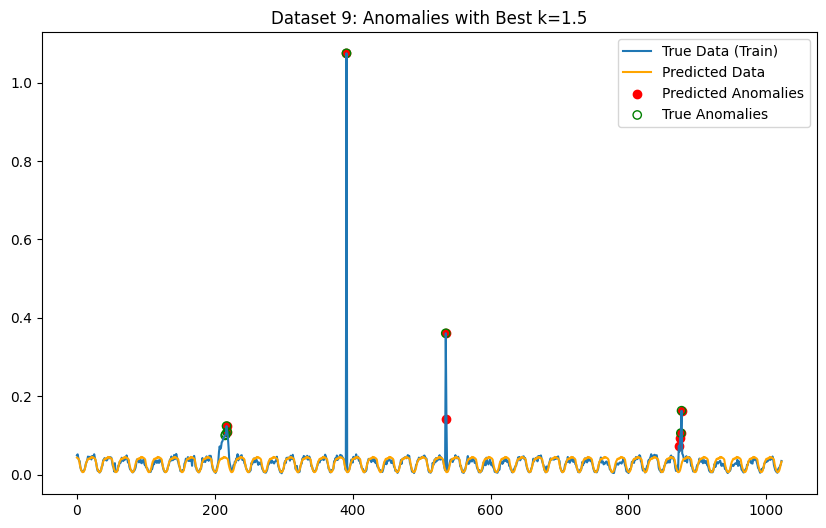

Dataset 10: Best k=3, MAE=0.51, Precision=0.93, Recall=1.00, F1=0.96


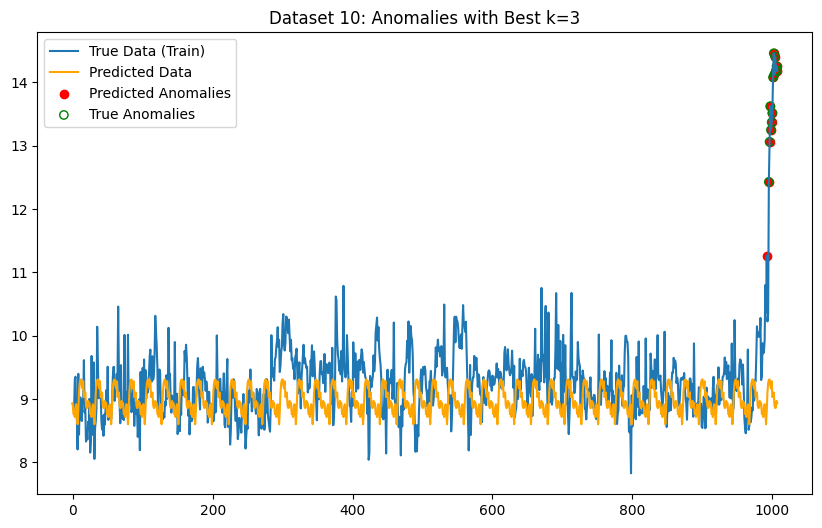

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 13: Best k=2.5, MAE=2529.05, Precision=1.00, Recall=0.44, F1=0.62


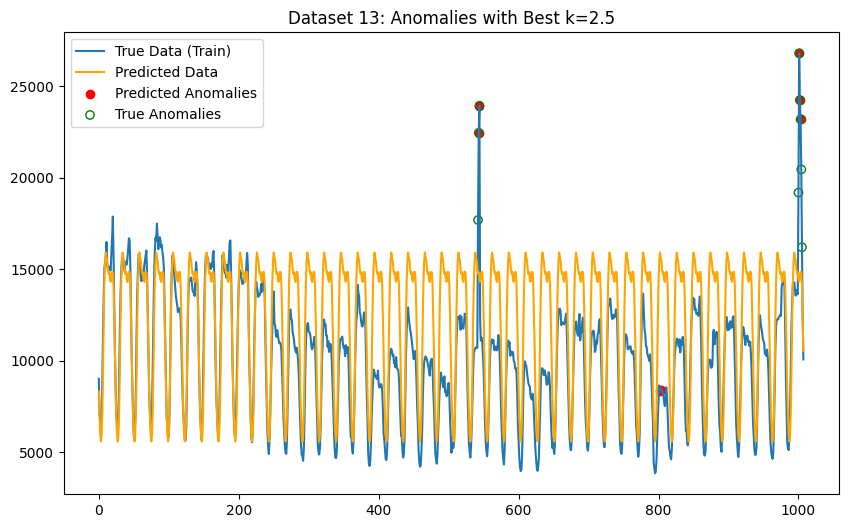

Dataset 23: Best k=3, MAE=0.07, Precision=0.50, Recall=1.00, F1=0.67


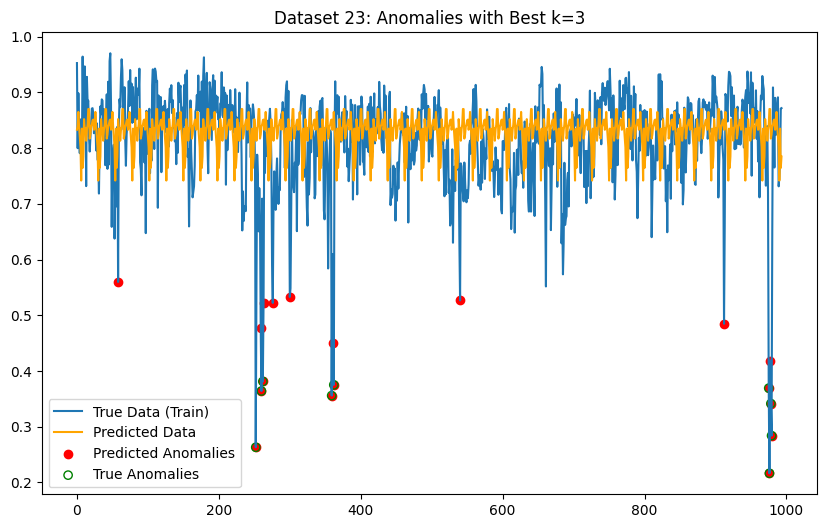

Dataset 24: Best k=3, MAE=0.95, Precision=1.00, Recall=1.00, F1=1.00


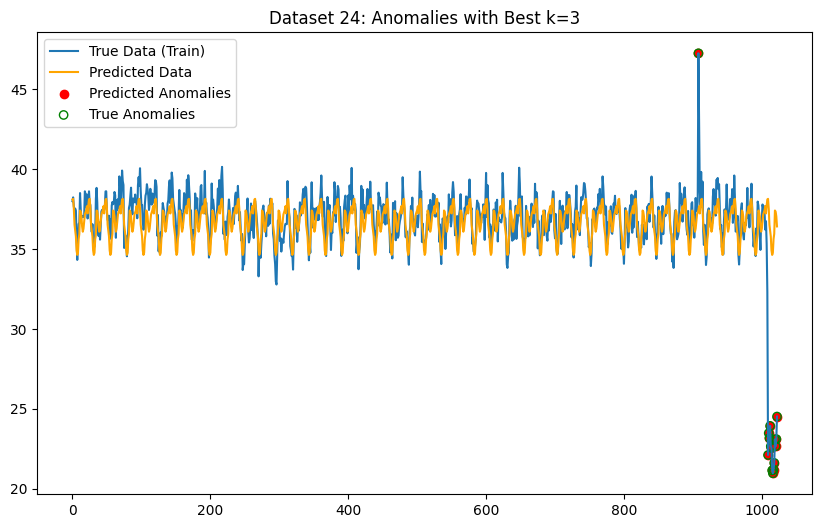

Dataset 27: Best k=3, MAE=86.06, Precision=0.40, Recall=1.00, F1=0.57


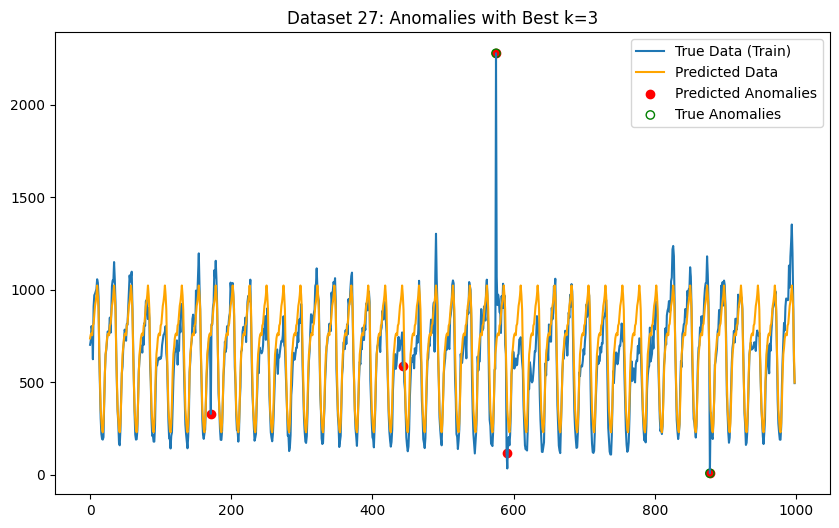

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 34: Best k=3, MAE=2969.64, Precision=0.67, Recall=0.86, F1=0.75


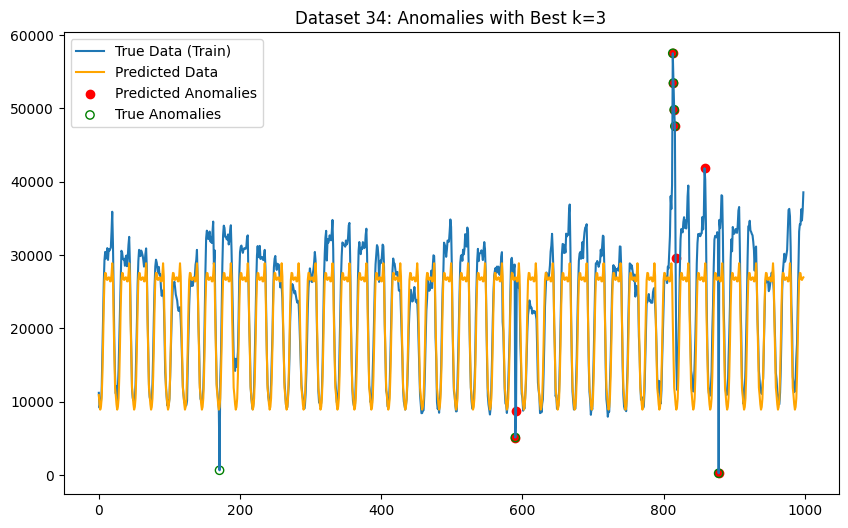

Dataset 41: Best k=3, MAE=53.72, Precision=0.17, Recall=1.00, F1=0.29


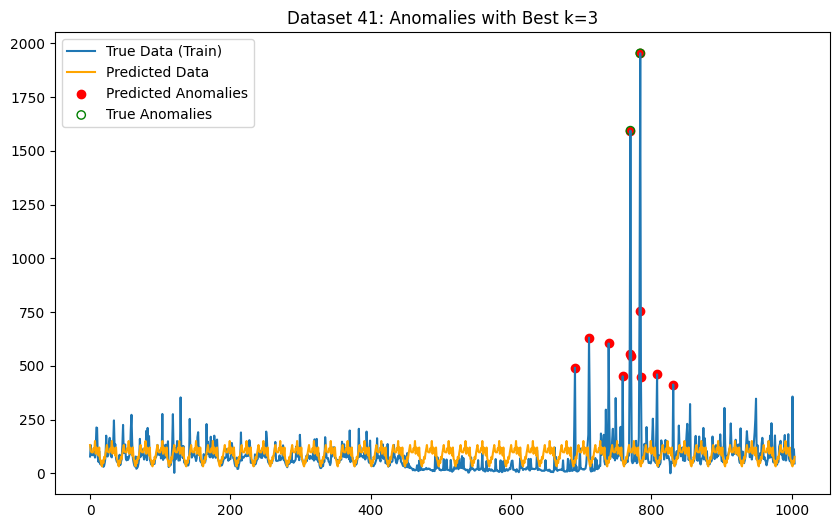

Dataset 66: Best k=3, MAE=50.68, Precision=0.90, Recall=0.90, F1=0.90


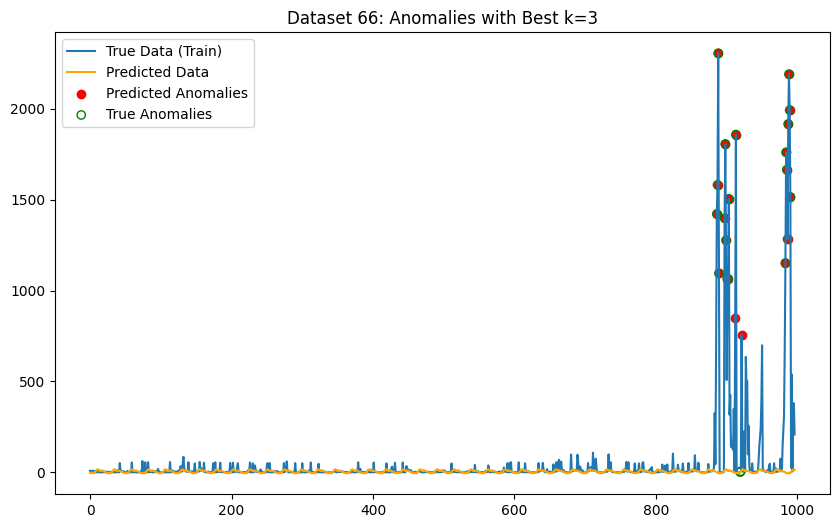


Average Metrics Across All Datasets:
Average MAE=778.22
Average Precision=0.71
Average Recall=0.84
Average F1-Score=0.71
All F1 Scores for each dataset: 0.1600, 0.8148, 0.9655, 0.8696, 0.7059, 0.9630, 0.6250, 0.6667, 1.0000, 0.5714, 0.7500, 0.2857, 0.9048


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Datasets to process
A1A = [1, 2, 3, 8, 9, 10, 13, 23, 24, 27, 34, 41, 66]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# Storage for average MAE values
all_mae_scores = []

# Parameters to iterate over
seasonal_periods = 24
possible_ks = [1.5, 2, 2.5, 3]

for i in A1A:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    # Split data into 30% fit and 70% train
    split_index = int(len(data) * 0.3)
    fit_data = data[:split_index]
    train_data = data[split_index:]
    train_labels = labels[split_index:]

    best_model = None
    best_residuals = None
    best_f1 = -1
    best_predicted_anomalies = None
    best_k = None
    best_mae = float('inf')

    try:
        # Fit HW-ES model on fit_data
        hw_model = ExponentialSmoothing(
            fit_data, trend=None, seasonal="add", seasonal_periods=seasonal_periods, initialization_method="estimated"
        )
        hw_model_fit = hw_model.fit()

        # Forecast on train_data
        forecasted_values = hw_model_fit.forecast(steps=len(train_data))

        # Calculate MAE on the forecast
        mae = mean_absolute_error(train_data, forecasted_values)

        # Store residuals
        residuals = np.abs(train_data - forecasted_values)

        if mae < best_mae:
            best_mae = mae
            best_model = hw_model_fit
            best_residuals = residuals

    except Exception as e:
        print(f"Error for dataset {i}: {e}")

    # Iterate over different values of k to find the optimal threshold multiplier
    for k in possible_ks:
        residuals = best_residuals
        mean_resid = np.mean(residuals)
        std_resid = np.std(residuals)
        threshold = mean_resid + k * std_resid
        predicted_anomalies = (residuals > threshold).astype(int)

        # Compute metrics
        precision = precision_score(train_labels, predicted_anomalies)
        recall = recall_score(train_labels, predicted_anomalies)
        f1 = f1_score(train_labels, predicted_anomalies)

        # Check if this k is the best so far
        if f1 > best_f1:
            best_f1 = f1
            best_k = k
            best_predicted_anomalies = predicted_anomalies

    # Store metrics
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)
    all_mae_scores.append(best_mae)

    print(f"Dataset {i}: Best k={best_k}, MAE={best_mae:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(train_data, label='True Data (Train)')
    plt.plot(forecasted_values, label='Predicted Data', color='orange')
    anomaly_indices = np.where(best_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, train_data[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(train_labels == 1)[0], train_data[train_labels == 1], color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best k={best_k}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)
average_mae = np.mean(all_mae_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average MAE={average_mae:.2f}")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")



## dynamic

Dataset 1: Best window=100, Best k=3, MAE=0.05, Precision=0.11, Recall=1.00, F1=0.19


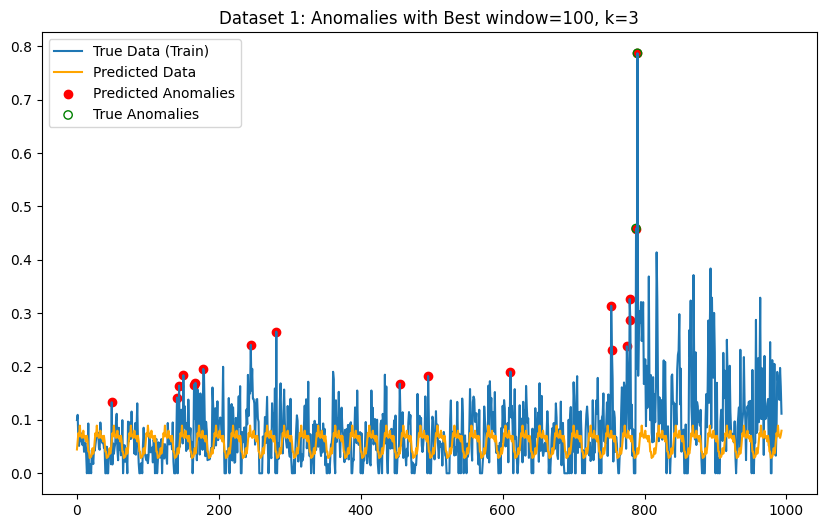

Dataset 2: Best window=200, Best k=3, MAE=4321.01, Precision=0.32, Recall=0.38, F1=0.34


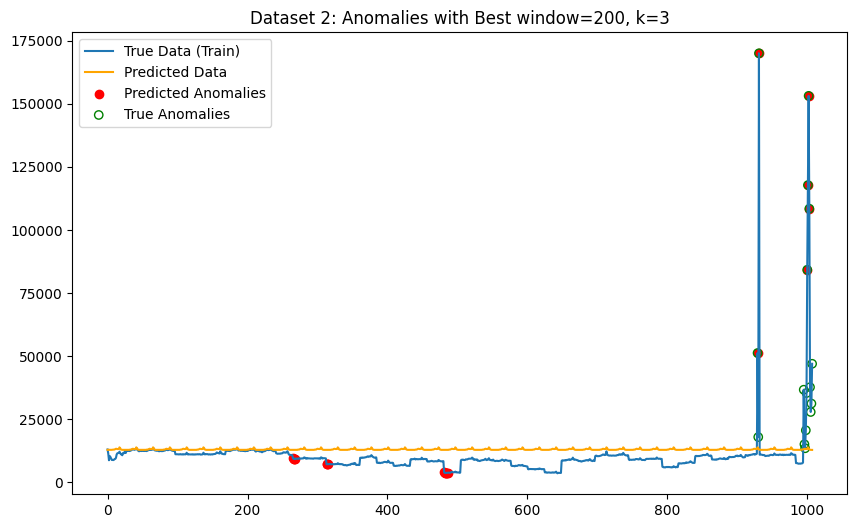

Dataset 3: Best window=200, Best k=3, MAE=0.23, Precision=0.56, Recall=1.00, F1=0.71


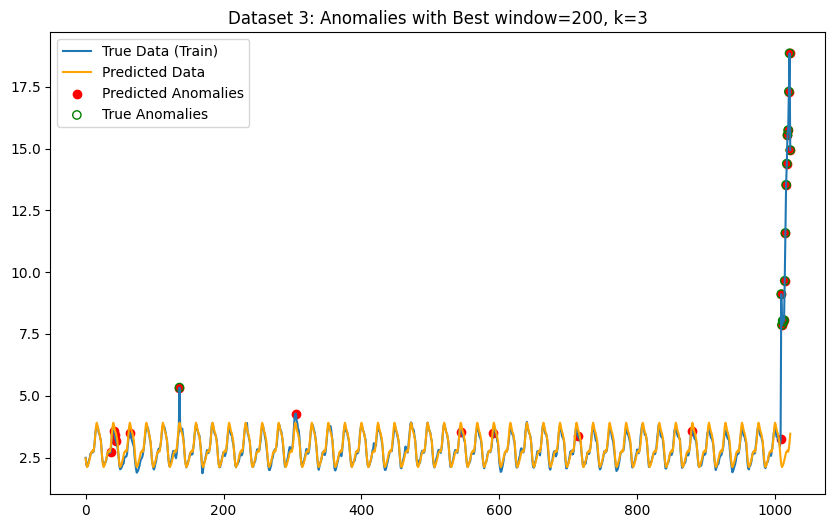

Dataset 8: Best window=200, Best k=3, MAE=104.82, Precision=0.40, Recall=1.00, F1=0.57


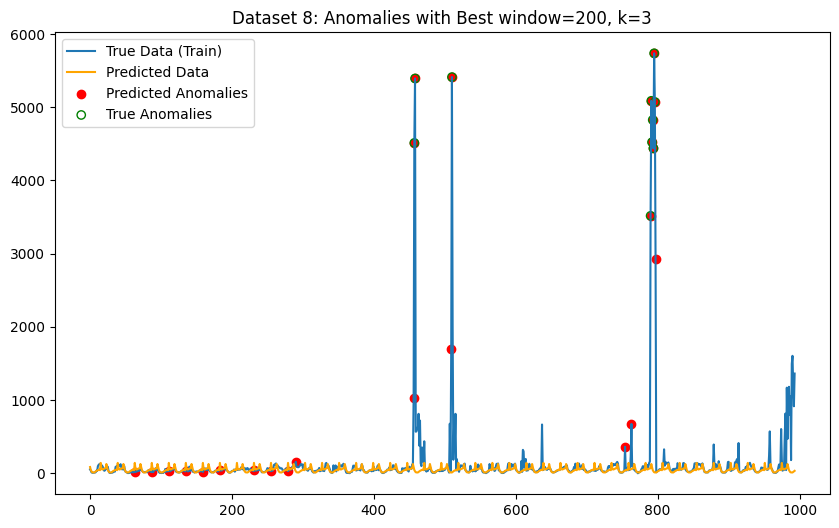

Dataset 9: Best window=300, Best k=3, MAE=0.01, Precision=0.31, Recall=1.00, F1=0.47


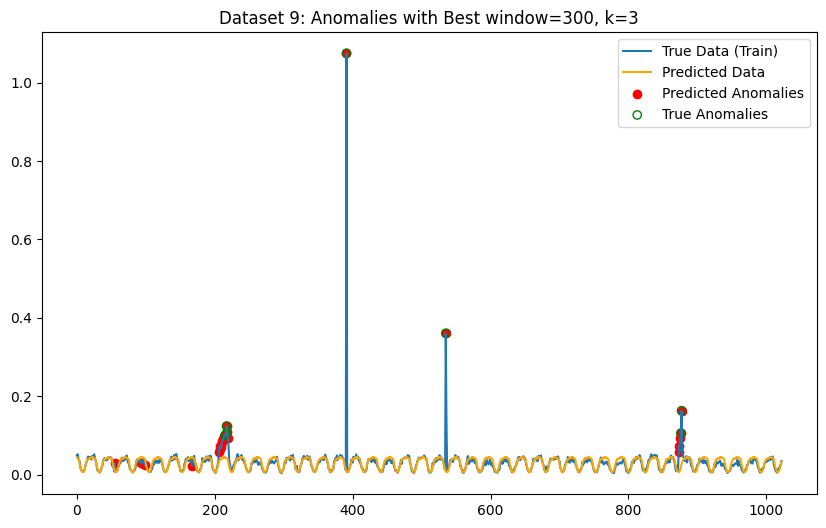

Dataset 10: Best window=200, Best k=3, MAE=0.51, Precision=0.42, Recall=1.00, F1=0.59


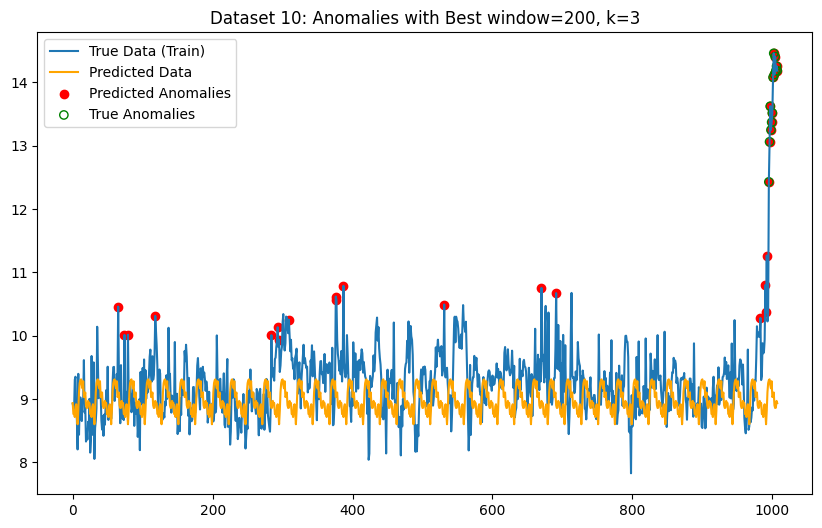

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 13: Best window=100, Best k=3, MAE=2529.05, Precision=0.30, Recall=0.33, F1=0.32


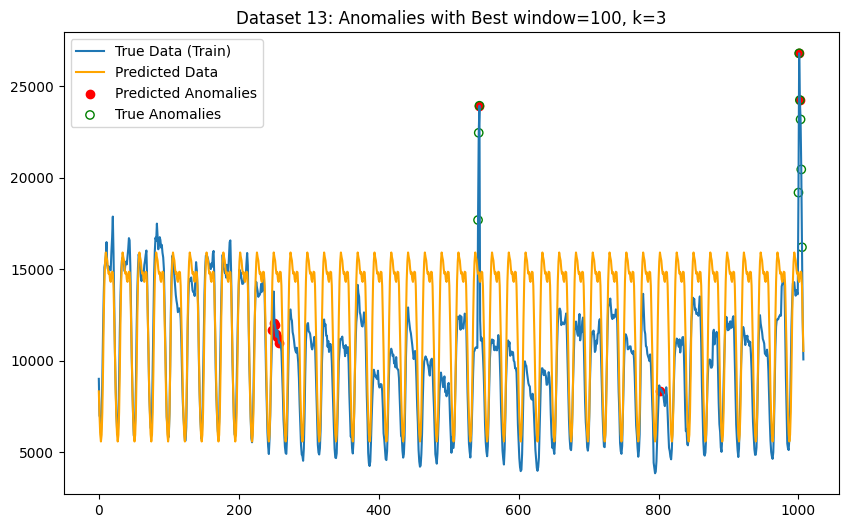

Dataset 23: Best window=100, Best k=3, MAE=0.07, Precision=0.45, Recall=1.00, F1=0.62


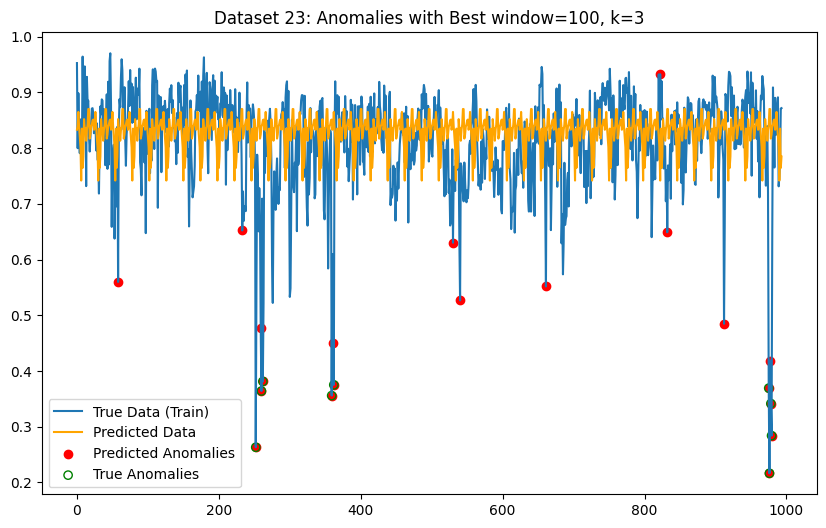

Dataset 24: Best window=300, Best k=3, MAE=0.95, Precision=0.68, Recall=1.00, F1=0.81


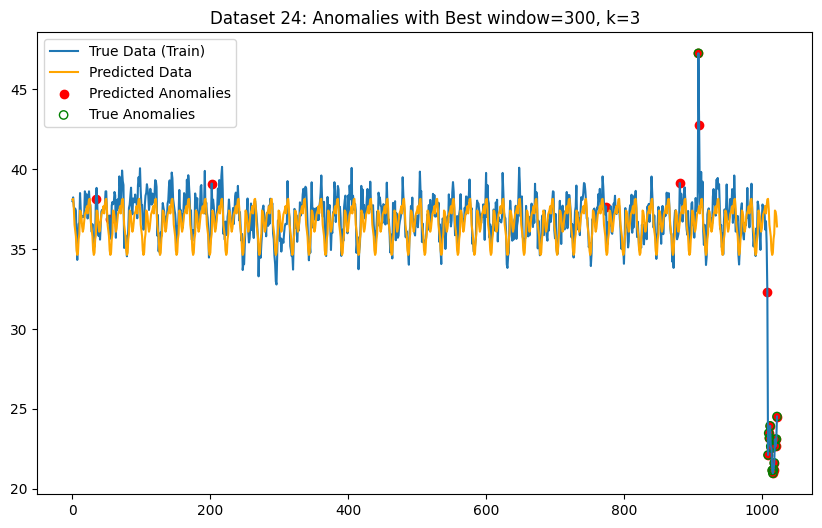

Dataset 27: Best window=200, Best k=3, MAE=86.06, Precision=0.17, Recall=1.00, F1=0.29


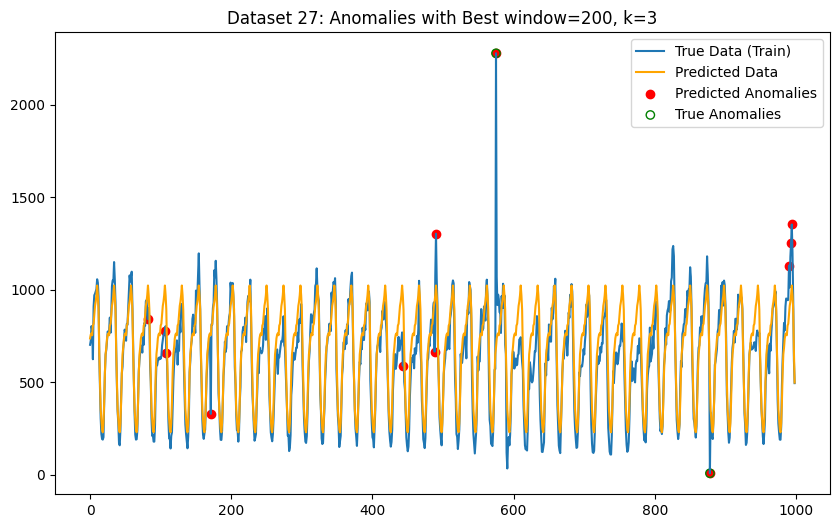

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 34: Best window=200, Best k=3, MAE=2969.64, Precision=0.64, Recall=1.00, F1=0.78


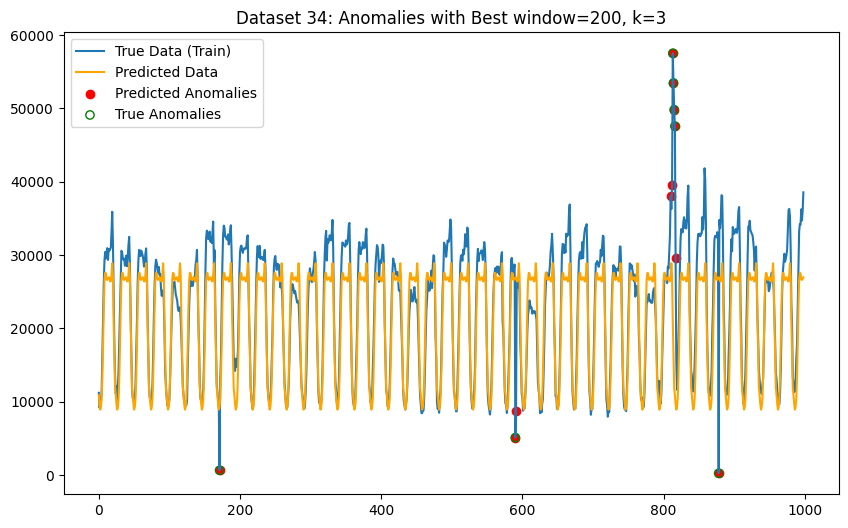

Dataset 41: Best window=100, Best k=3, MAE=53.72, Precision=0.12, Recall=1.00, F1=0.22


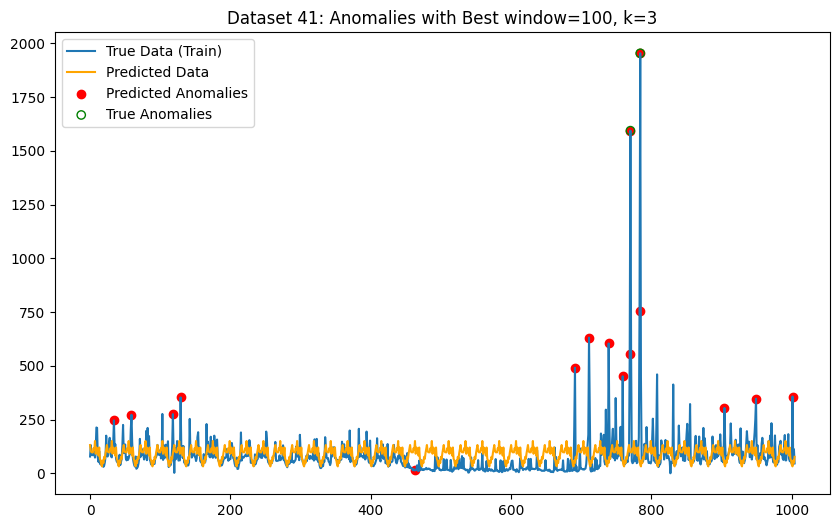

Dataset 66: Best window=300, Best k=3, MAE=50.68, Precision=0.33, Recall=0.90, F1=0.48


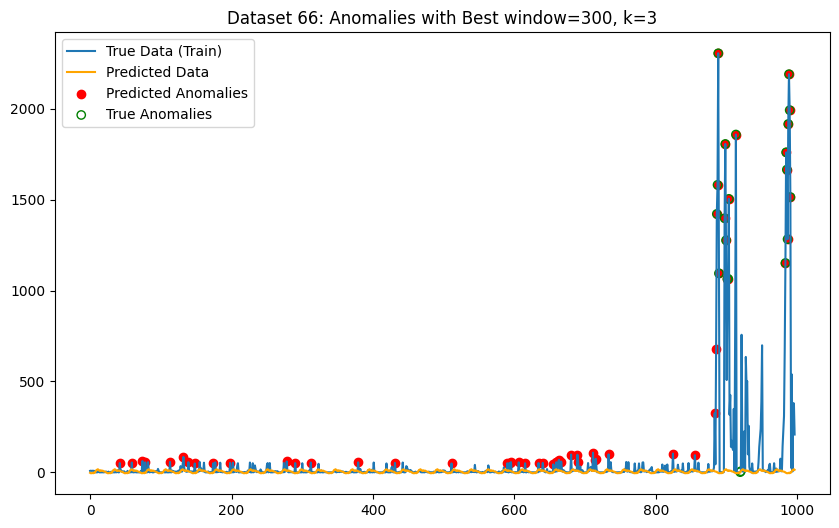


Average Metrics Across All Datasets:
Average MAE=778.22
Average Precision=0.37
Average Recall=0.89
Average F1-Score=0.49
All F1 Scores for each dataset: 0.1905, 0.3429, 0.7143, 0.5714, 0.4706, 0.5909, 0.3158, 0.6207, 0.8108, 0.2857, 0.7778, 0.2222, 0.4810


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Datasets to process
A1A = [1, 2, 3, 8, 9, 10, 13, 23, 24, 27, 34, 41, 66]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# Storage for average MAE values
all_mae_scores = []

# Parameters to iterate over
seasonal_periods = 24
possible_windows = [100, 200, 300, 500]
possible_ks = [1.5, 2, 2.5, 3]

for i in A1A:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    # Split data into 30% fit and 70% train
    split_index = int(len(data) * 0.3)
    fit_data = data[:split_index]
    train_data = data[split_index:]
    train_labels = labels[split_index:]

    best_model = None
    best_residuals = None
    best_f1_for_dataset = -1
    best_predicted_anomalies = None
    best_k_for_dataset = None
    best_window_for_dataset = None
    best_mae = float('inf')
    best_precision_for_dataset = None
    best_recall_for_dataset = None

    try:
        # Fit HW-ES model on fit_data
        hw_model = ExponentialSmoothing(
            fit_data, trend=None, seasonal="add", seasonal_periods=seasonal_periods, initialization_method="estimated"
        )
        hw_model_fit = hw_model.fit()

        # Forecast on train_data
        forecasted_values = hw_model_fit.forecast(steps=len(train_data))

        # Calculate MAE on the forecast
        mae = mean_absolute_error(train_data, forecasted_values)

        # Store residuals
        residuals = np.abs(train_data - forecasted_values)

        if mae < best_mae:
            best_mae = mae
            best_model = hw_model_fit
            best_residuals = residuals

    except Exception as e:
        print(f"Error for dataset {i}: {e}")

    # Iterate over different values of window and k for dynamic threshold
    for window in possible_windows:
        # Compute rolling statistics
        rolling_residuals = pd.Series(best_residuals).rolling(window=window, min_periods=1)
        mean_residuals = rolling_residuals.mean()
        std_residuals = rolling_residuals.std()

        for k in possible_ks:
            # Set dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies = (best_residuals > threshold).astype(int)

            # Compute metrics
            precision_k = precision_score(train_labels, predicted_anomalies)
            recall_k = recall_score(train_labels, predicted_anomalies)
            f1_k = f1_score(train_labels, predicted_anomalies)

            # Check if this combination of window and k is the best for the dataset
            if f1_k > best_f1_for_dataset:
                best_f1_for_dataset = f1_k
                best_k_for_dataset = k
                best_window_for_dataset = window
                best_precision_for_dataset = precision_k
                best_recall_for_dataset = recall_k
                best_predicted_anomalies = predicted_anomalies

    # Store metrics for this dataset
    all_precisions.append(best_precision_for_dataset)
    all_recalls.append(best_recall_for_dataset)
    all_f1_scores.append(best_f1_for_dataset)
    all_mae_scores.append(best_mae)

    print(f"Dataset {i}: Best window={best_window_for_dataset}, Best k={best_k_for_dataset}, "
          f"MAE={best_mae:.2f}, Precision={best_precision_for_dataset:.2f}, "
          f"Recall={best_recall_for_dataset:.2f}, F1={best_f1_for_dataset:.2f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(train_data, label='True Data (Train)')
    plt.plot(forecasted_values, label='Predicted Data', color='orange')
    anomaly_indices = np.where(best_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, train_data[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(train_labels == 1)[0], train_data[train_labels == 1], color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best window={best_window_for_dataset}, k={best_k_for_dataset}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)
average_mae = np.mean(all_mae_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average MAE={average_mae:.2f}")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## A1B

## static

Dataset 7: Best k=2.00, Precision=0.75, Recall=0.16, F1=0.49


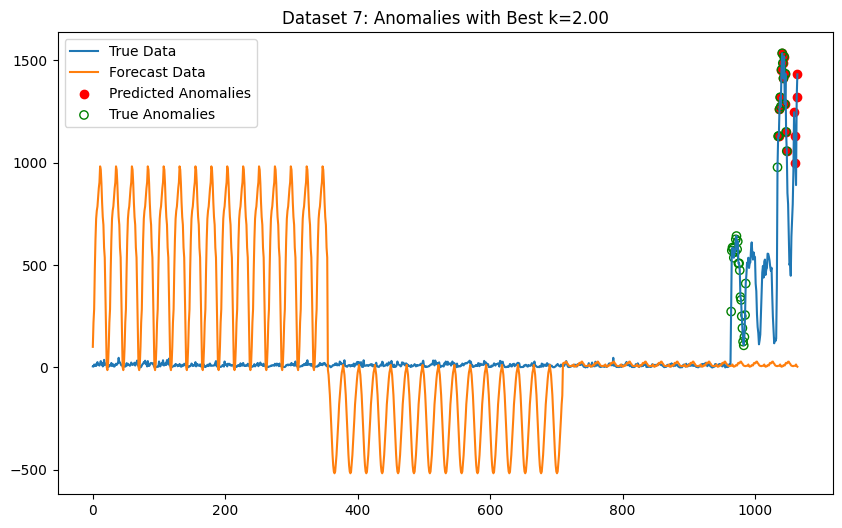

Dataset 20: Best k=2.00, Precision=0.24, Recall=0.12, F1=0.18


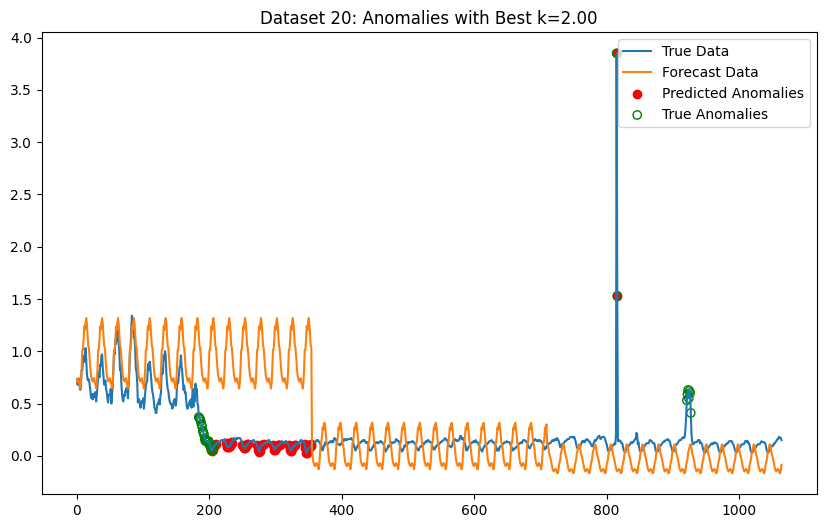

Dataset 31: Best k=2.50, Precision=1.00, Recall=0.12, F1=0.62


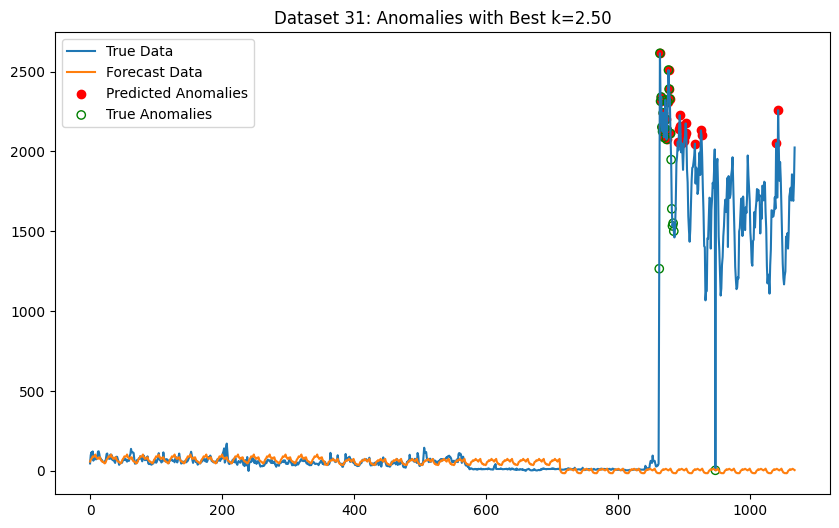

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Dataset 32: Best k=2.00, Precision=0.00, Recall=0.00, F1=0.42


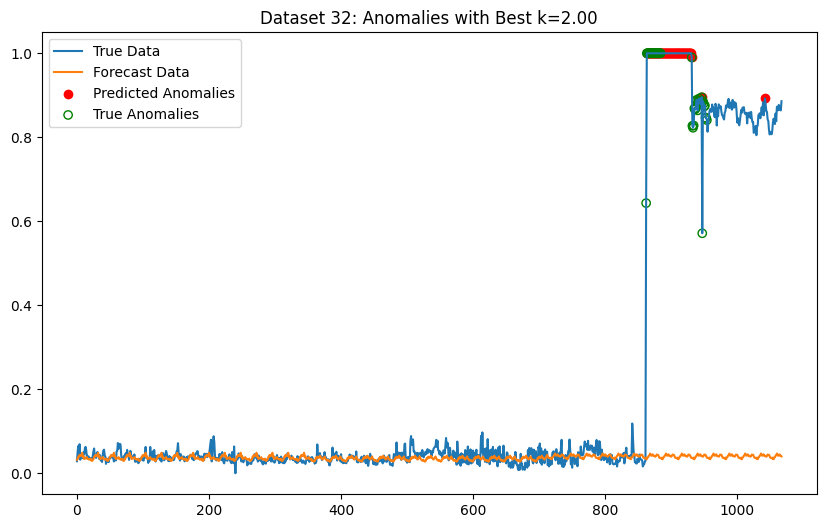

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 48: Best k=2.00, Precision=0.07, Recall=0.05, F1=0.07


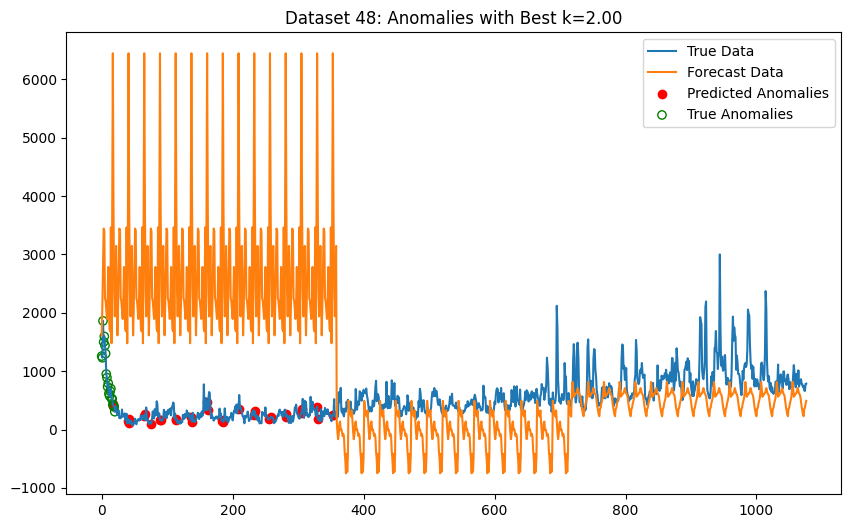

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 57: Best k=2.50, Precision=0.00, Recall=0.00, F1=0.06


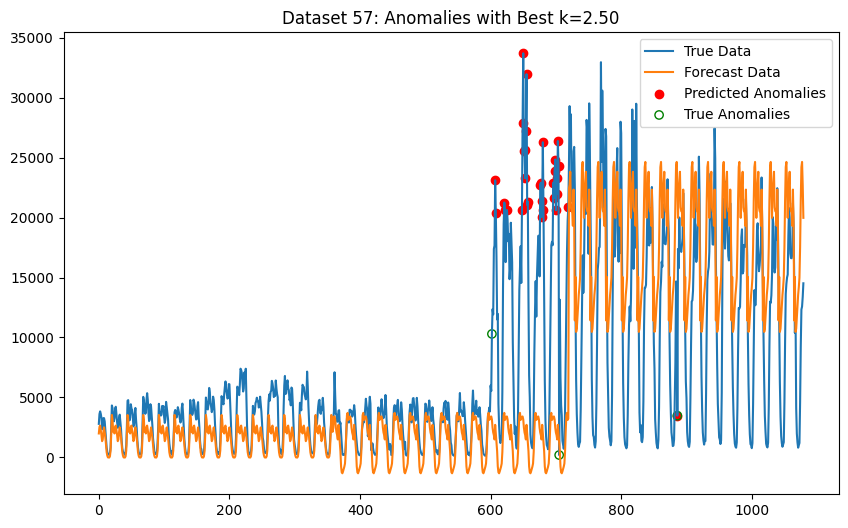

Dataset 61: Best k=3.00, Precision=0.06, Recall=0.04, F1=0.05


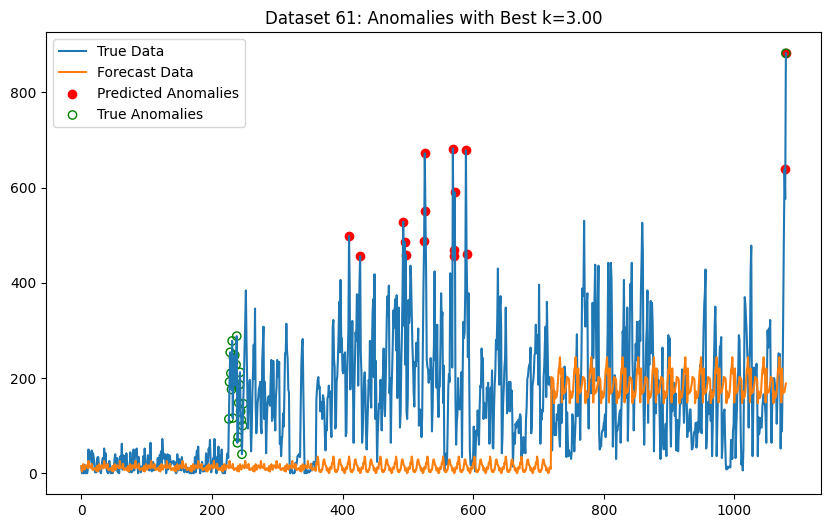


Average Metrics Across All Datasets:
Average Precision=0.30
Average Recall=0.07
Average F1-Score=0.27
All F1 Scores for each dataset: 0.4912, 0.1835, 0.6182, 0.4202, 0.0741, 0.0571, 0.0500


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Datasets
A1B = [7, 20, 31, 32, 48, 57, 61]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=3)

# Parameters for tuning
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1B:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Apply exponential smoothing on the training data
        model = ExponentialSmoothing(y_train, trend=None, seasonal="add", seasonal_periods=24, initialization_method="estimated")
        model_fit = model.fit()

        # Forecast on the test data
        forecast = model_fit.forecast(steps=len(y_test))

        # Calculate residuals
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

    # Find the optimal k using combined residuals
    best_k = None
    best_f1 = -1
    best_combined_predicted_anomalies = None

    # Calculate static mean and std of residuals
    mean_residuals = np.mean(combined_residuals)
    std_residuals = np.std(combined_residuals)

    for k in k_values:
        # Static threshold
        threshold = mean_residuals + k * std_residuals
        predicted_anomalies = (np.array(combined_residuals) > threshold).astype(int)

        # Compute F1 score for the current k
        precision = precision_score(combined_true_anomalies, predicted_anomalies)
        recall = recall_score(combined_true_anomalies, predicted_anomalies)
        f1 = f1_score(combined_true_anomalies, predicted_anomalies)

        # Check if this k is the best so far
        if f1 > best_f1:
            best_f1 = f1
            best_k = k
            best_combined_predicted_anomalies = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)

    print(f"Dataset {i}: Best k={best_k:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best k={best_k:.2f}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## dynamic

Dataset 7: Best k=3.00, Best Window=200, Precision=0.79, Recall=0.39, F1=0.79


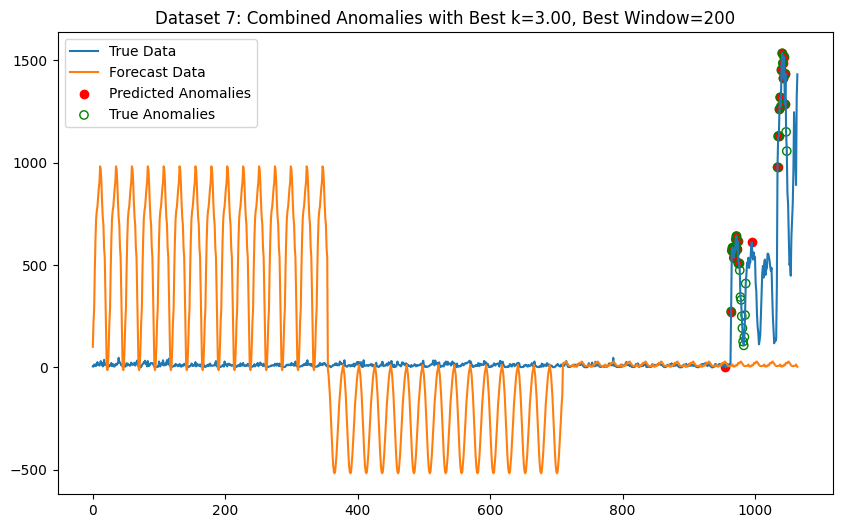

Dataset 20: Best k=2.50, Best Window=100, Precision=0.65, Recall=0.33, F1=0.56


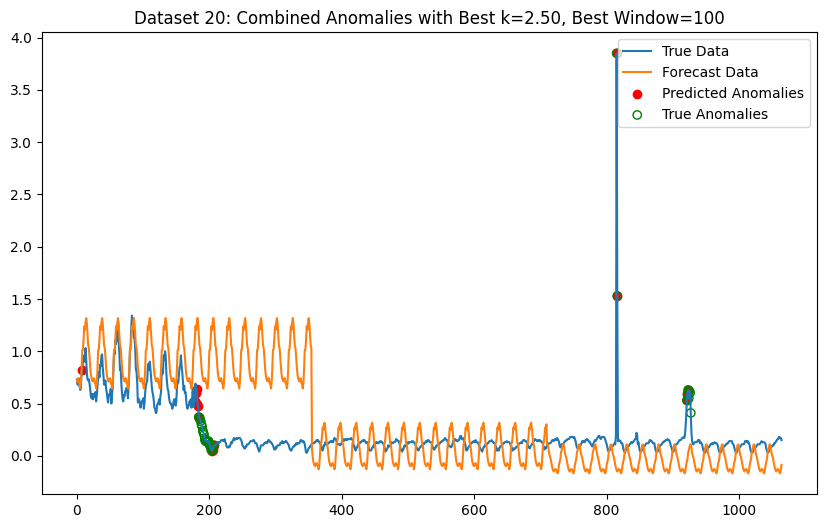

Dataset 31: Best k=3.00, Best Window=300, Precision=0.46, Recall=0.96, F1=0.72


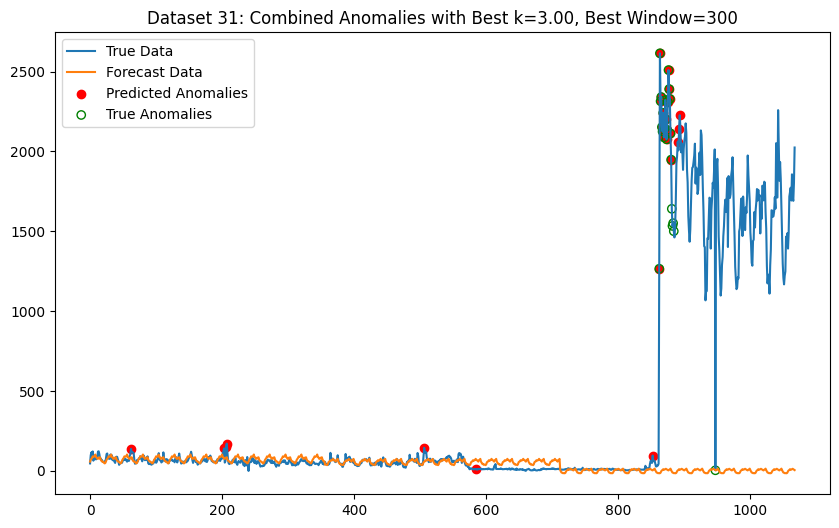

Dataset 32: Best k=3.00, Best Window=300, Precision=0.31, Recall=0.49, F1=0.46


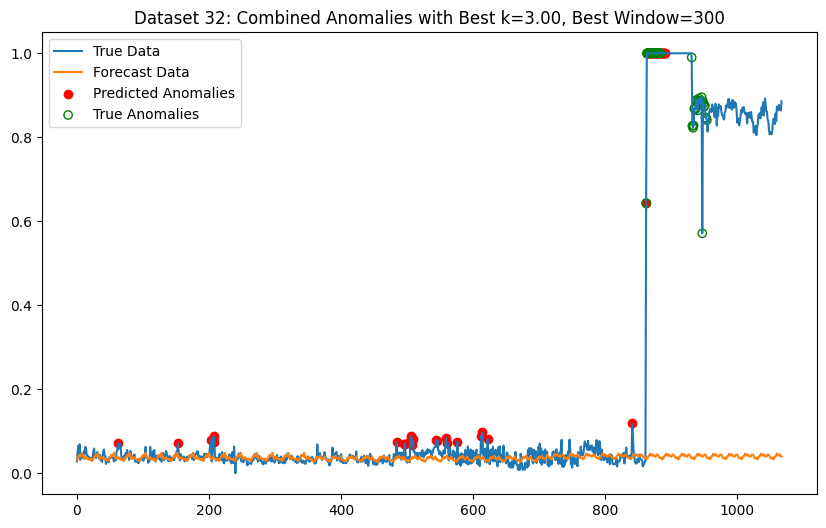

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 48: Best k=2.00, Best Window=500, Precision=0.06, Recall=0.05, F1=0.12


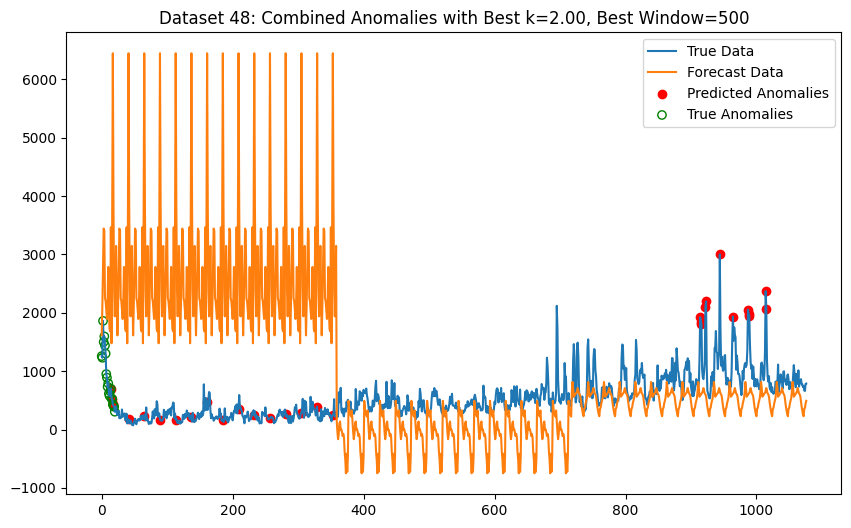

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 57: Best k=3.00, Best Window=100, Precision=0.02, Recall=0.33, F1=0.13


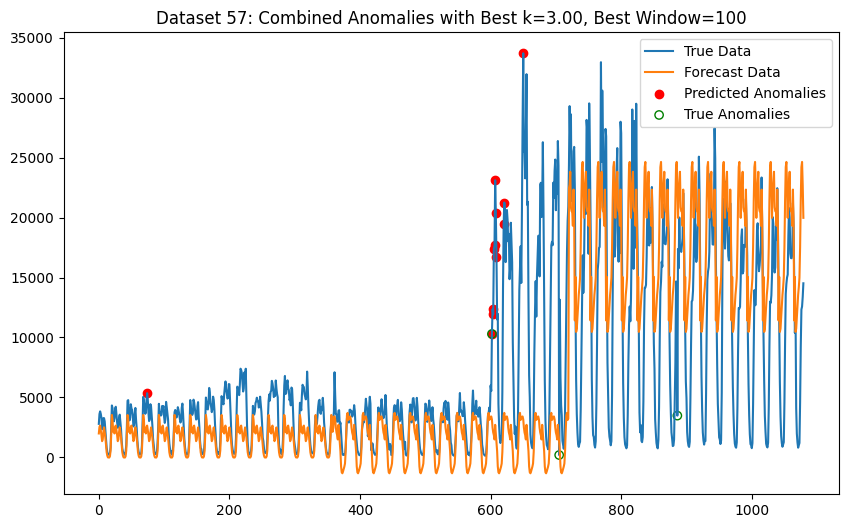

Dataset 61: Best k=3.00, Best Window=200, Precision=0.29, Recall=0.62, F1=0.47


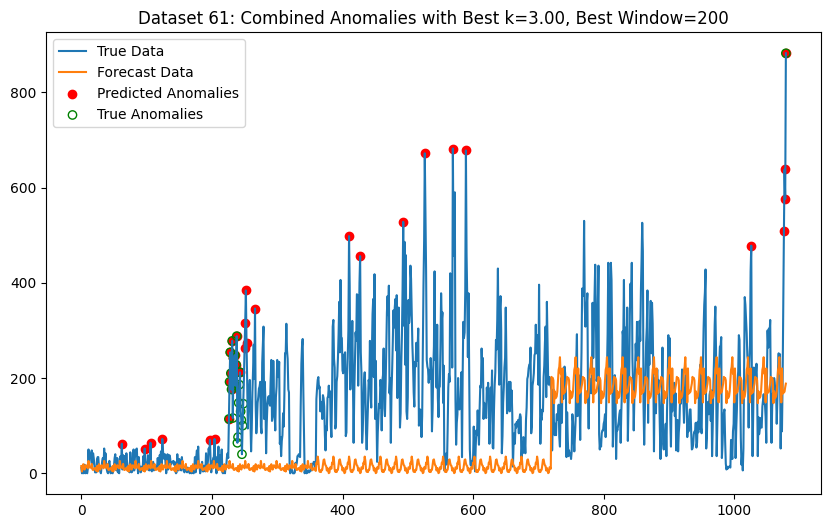


Average Metrics Across All Datasets:
Average Precision=0.37
Average Recall=0.45
Average F1-Score=0.46
All F1 Scores for each dataset: 0.7879, 0.5556, 0.7170, 0.4600, 0.1200, 0.1333, 0.4746


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Datasets
A1B = [7, 20, 31, 32, 48, 57, 61]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=3)

# Parameters for tuning
window_sizes = [100, 200, 300, 500]  # Rolling window sizes to test
k_values = [1.5,2,2.5,3]  # Test k values from 1 to 4.5 in 0.5 steps

for i in A1B:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Apply exponential smoothing on the training data
        model = ExponentialSmoothing(y_train, trend=None, seasonal="add", seasonal_periods=24, initialization_method="estimated")
        model_fit = model.fit()

        # Forecast on the test data
        forecast = model_fit.forecast(steps=len(y_test))

        # Calculate residuals
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

    # Find the optimal combination of window size and k using combined residuals
    best_window = None
    best_k = None
    best_f1 = -1
    best_combined_predicted_anomalies = None

    for window_size in window_sizes:
        for k in k_values:
            # Calculate rolling statistics for dynamic threshold
            rolling_residuals = pd.Series(combined_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            # Determine anomalies using dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies = (pd.Series(combined_residuals) > threshold).astype(int)

            # Compute F1 score for the current window size and k
            precision = precision_score(combined_true_anomalies, predicted_anomalies)
            recall = recall_score(combined_true_anomalies, predicted_anomalies)
            f1 = f1_score(combined_true_anomalies, predicted_anomalies)

            # Check if this combination of window size and k is the best so far
            if f1 > best_f1:
                best_f1 = f1
                best_k = k
                best_window = window_size
                best_combined_predicted_anomalies = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)

    print(f"Dataset {i}: Best k={best_k:.2f}, Best Window={best_window}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best k={best_k:.2f}, Best Window={best_window}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## A1C

## static

Dataset 17: Best k=1.5, MAE=1616.54, Precision=1.00, Recall=0.09, F1=0.72


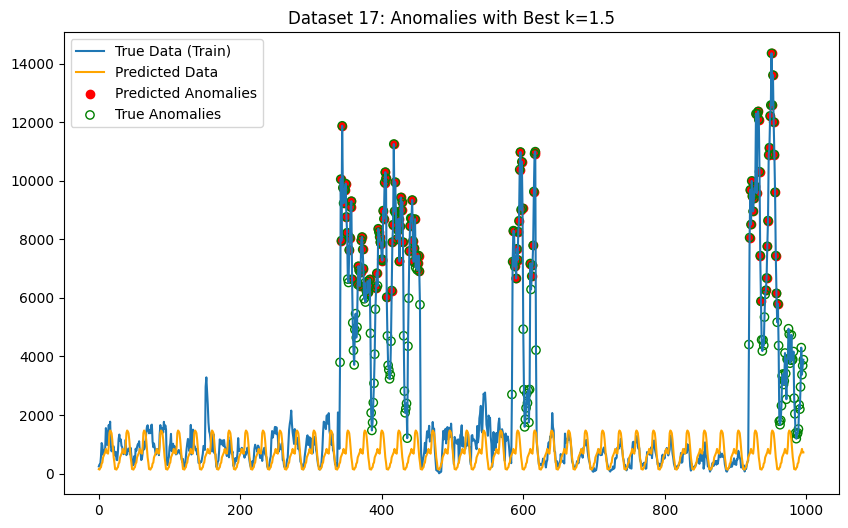

Dataset 19: Best k=1.5, MAE=50.23, Precision=1.00, Recall=0.10, F1=0.62


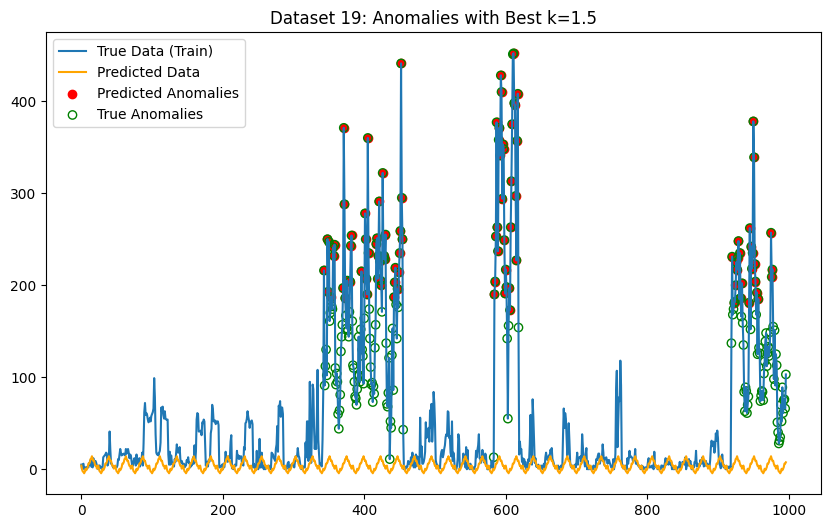

Dataset 26: Best k=2, MAE=131.01, Precision=0.38, Recall=0.08, F1=0.44


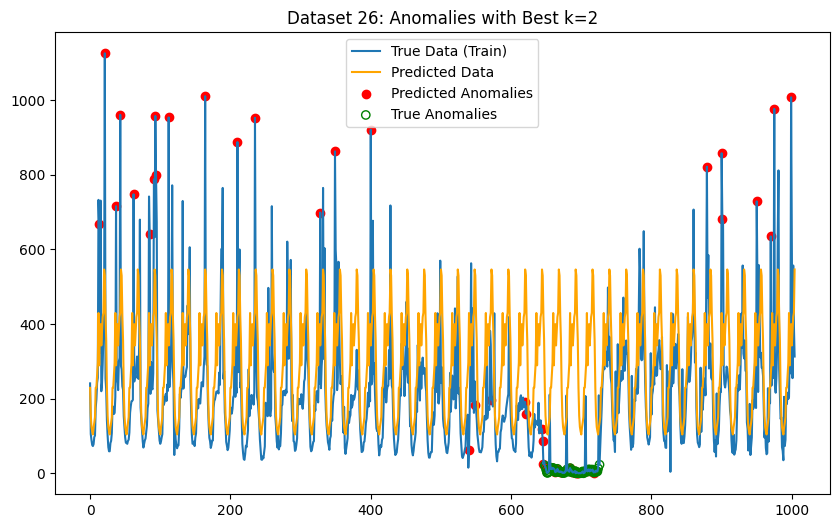

Dataset 37: Best k=2.5, MAE=58.66, Precision=0.62, Recall=0.44, F1=0.55


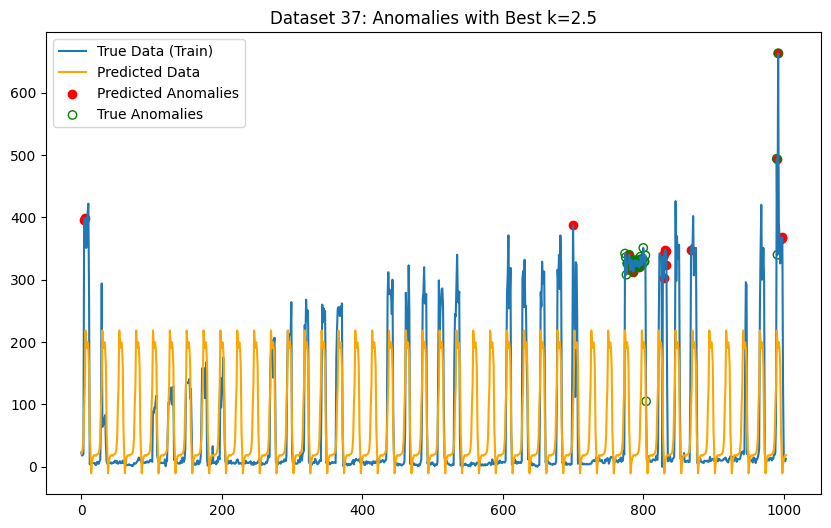

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Dataset 40: Best k=1.5, MAE=237.45, Precision=0.00, Recall=0.00, F1=0.68


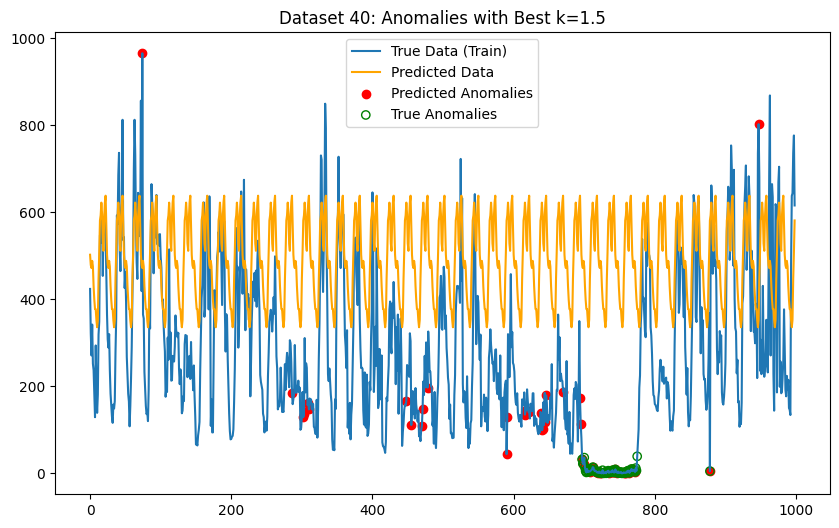

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 47: Best k=3, MAE=1524.48, Precision=0.86, Recall=0.60, F1=0.71


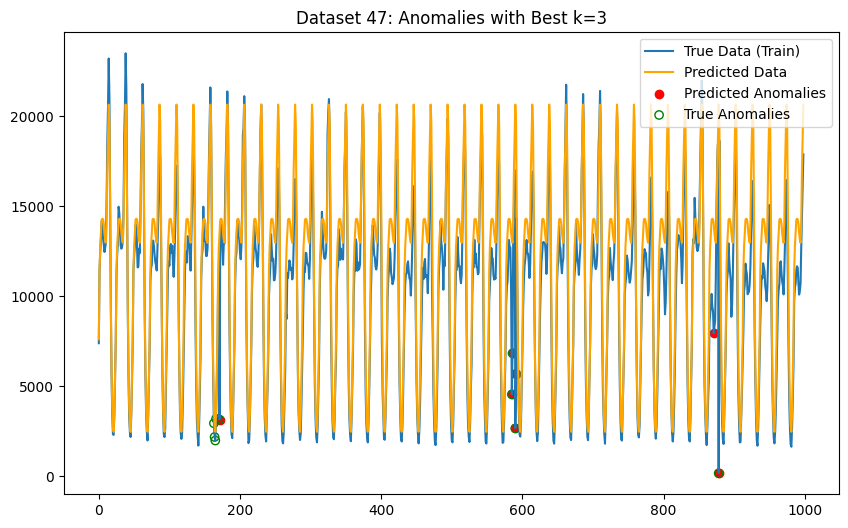


Average Metrics Across All Datasets:
Average MAE=603.06
Average Precision=0.64
Average Recall=0.22
Average F1-Score=0.62
All F1 Scores for each dataset: 0.7247, 0.6242, 0.4412, 0.5538, 0.6832, 0.7059


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Datasets to process
A1C = [17, 19, 26, 37, 40, 47]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# Storage for average MAE values
all_mae_scores = []

# Parameters to iterate over
seasonal_periods = 24
possible_ks = [1.5, 2, 2.5, 3]

for i in A1C:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    # Split data into 30% fit and 70% train
    split_index = int(len(data) * 0.3)
    fit_data = data[:split_index]
    train_data = data[split_index:]
    train_labels = labels[split_index:]

    best_model = None
    best_residuals = None
    best_f1 = -1
    best_predicted_anomalies = None
    best_k = None
    best_mae = float('inf')

    try:
        # Fit HW-ES model on fit_data
        hw_model = ExponentialSmoothing(
            fit_data, trend=None, seasonal="add", seasonal_periods=seasonal_periods, initialization_method="estimated"
        )
        hw_model_fit = hw_model.fit()

        # Forecast on train_data
        forecasted_values = hw_model_fit.forecast(steps=len(train_data))

        # Calculate MAE on the forecast
        mae = mean_absolute_error(train_data, forecasted_values)

        # Store residuals
        residuals = np.abs(train_data - forecasted_values)

        if mae < best_mae:
            best_mae = mae
            best_model = hw_model_fit
            best_residuals = residuals

    except Exception as e:
        print(f"Error for dataset {i}: {e}")

    # Iterate over different values of k to find the optimal threshold multiplier
    for k in possible_ks:
        residuals = best_residuals
        mean_resid = np.mean(residuals)
        std_resid = np.std(residuals)
        threshold = mean_resid + k * std_resid
        predicted_anomalies = (residuals > threshold).astype(int)

        # Compute metrics
        precision = precision_score(train_labels, predicted_anomalies)
        recall = recall_score(train_labels, predicted_anomalies)
        f1 = f1_score(train_labels, predicted_anomalies)

        # Check if this k is the best so far
        if f1 > best_f1:
            best_f1 = f1
            best_k = k
            best_predicted_anomalies = predicted_anomalies

    # Store metrics
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)
    all_mae_scores.append(best_mae)

    print(f"Dataset {i}: Best k={best_k}, MAE={best_mae:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(train_data, label='True Data (Train)')
    plt.plot(forecasted_values, label='Predicted Data', color='orange')
    anomaly_indices = np.where(best_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, train_data[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(train_labels == 1)[0], train_data[train_labels == 1], color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best k={best_k}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)
average_mae = np.mean(all_mae_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average MAE={average_mae:.2f}")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## dynamic

Dataset 17: Best window=500, Best k=1.5, MAE=1616.54, Precision=0.81, Recall=0.64, F1=0.72


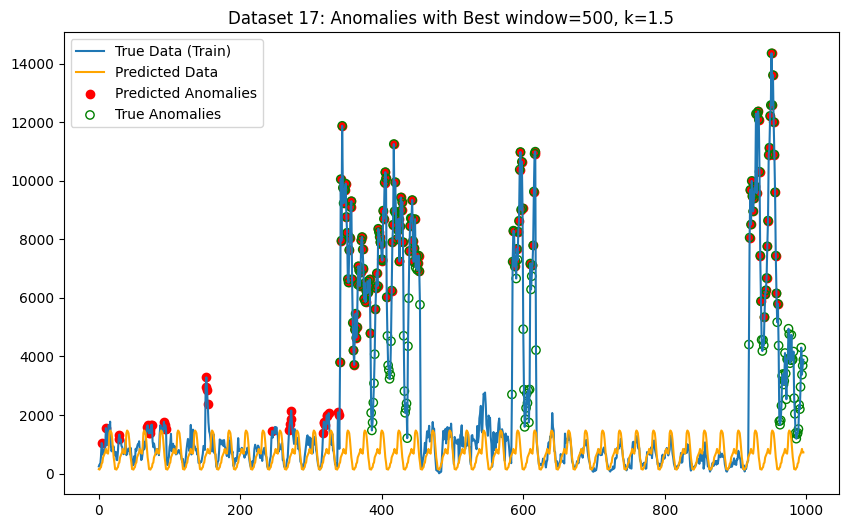

Dataset 19: Best window=300, Best k=1.5, MAE=50.23, Precision=0.68, Recall=0.59, F1=0.63


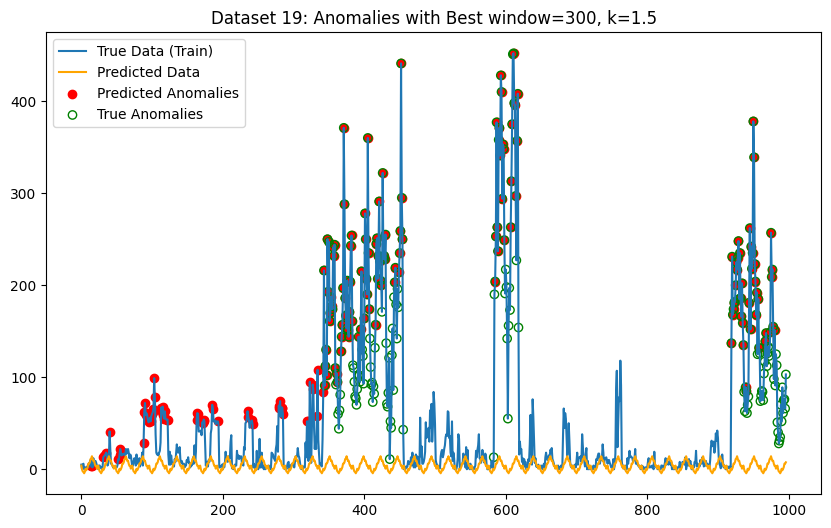

Dataset 26: Best window=500, Best k=1.5, MAE=131.01, Precision=0.38, Recall=0.48, F1=0.43


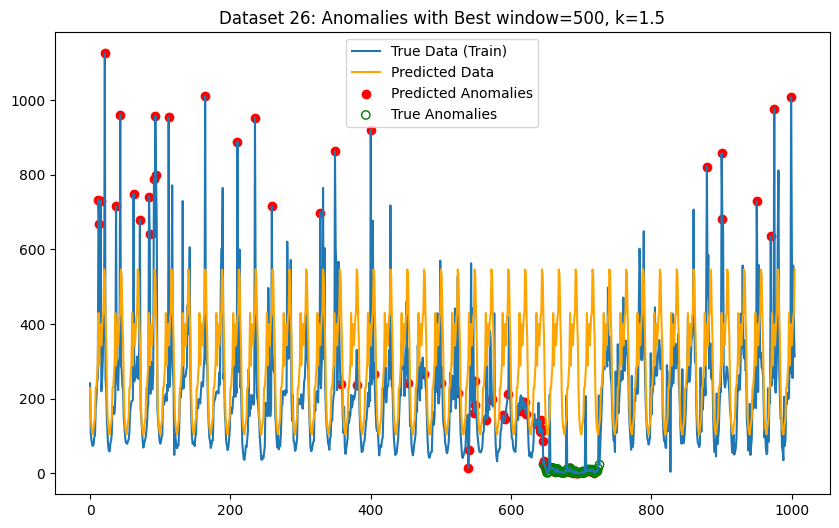

Dataset 37: Best window=500, Best k=3, MAE=58.66, Precision=0.61, Recall=0.50, F1=0.55


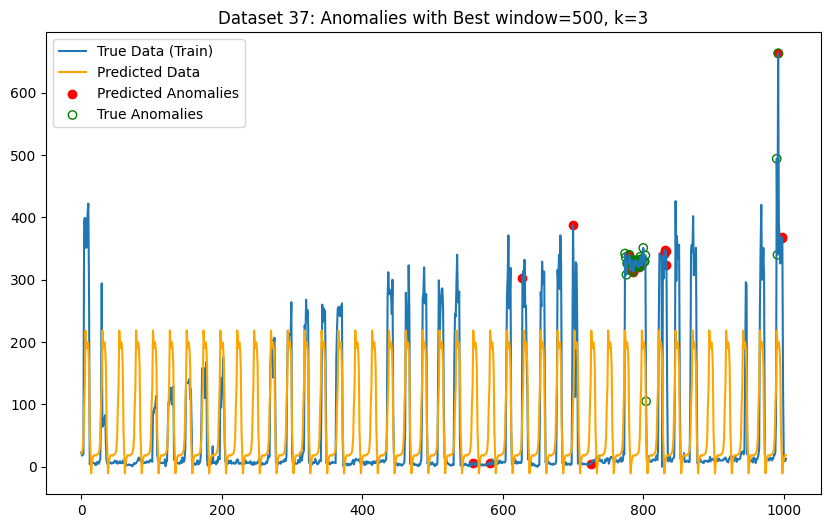

Dataset 40: Best window=500, Best k=1.5, MAE=237.45, Precision=0.36, Recall=0.62, F1=0.46


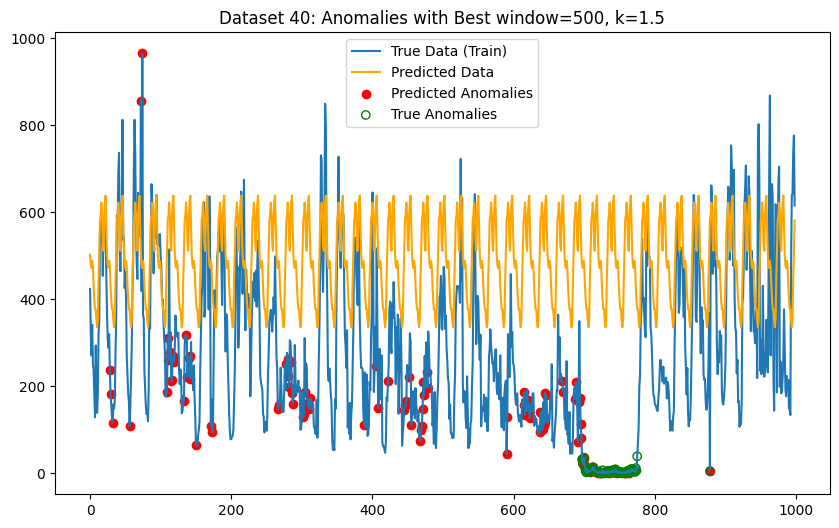

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 47: Best window=300, Best k=3, MAE=1524.48, Precision=0.40, Recall=0.60, F1=0.48


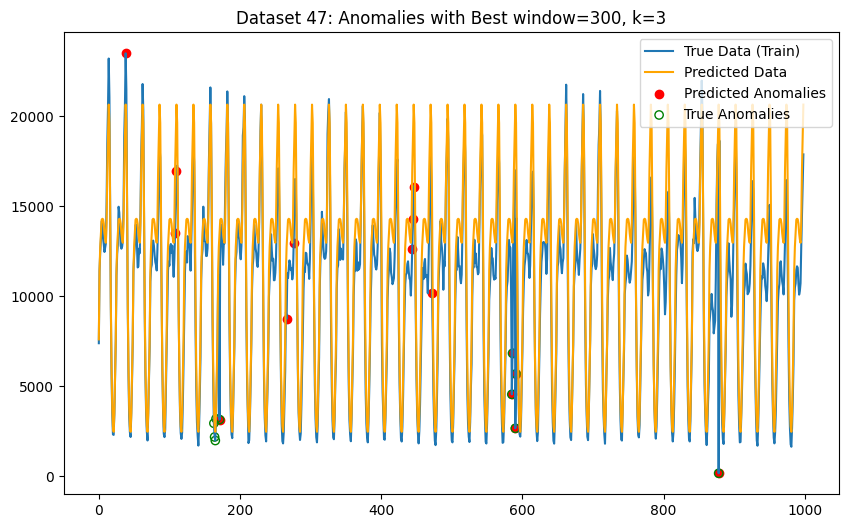


Average Metrics Across All Datasets:
Average MAE=603.06
Average Precision=0.54
Average Recall=0.57
Average F1-Score=0.54
All F1 Scores for each dataset: 0.7174, 0.6323, 0.4260, 0.5484, 0.4608, 0.4800


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Datasets to process
A1C = [17, 19, 26, 37, 40, 47]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# Storage for average MAE values
all_mae_scores = []

# Parameters to iterate over
seasonal_periods = 24
possible_windows = [100, 200, 300, 500]
possible_ks = [1.5, 2, 2.5, 3]

for i in A1C:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    # Split data into 30% fit and 70% train
    split_index = int(len(data) * 0.3)
    fit_data = data[:split_index]
    train_data = data[split_index:]
    train_labels = labels[split_index:]

    best_model = None
    best_residuals = None
    best_f1_for_dataset = -1
    best_predicted_anomalies = None
    best_k_for_dataset = None
    best_window_for_dataset = None
    best_mae = float('inf')
    best_precision_for_dataset = None
    best_recall_for_dataset = None

    try:
        # Fit HW-ES model on fit_data
        hw_model = ExponentialSmoothing(
            fit_data, trend=None, seasonal="add", seasonal_periods=seasonal_periods, initialization_method="estimated"
        )
        hw_model_fit = hw_model.fit()

        # Forecast on train_data
        forecasted_values = hw_model_fit.forecast(steps=len(train_data))

        # Calculate MAE on the forecast
        mae = mean_absolute_error(train_data, forecasted_values)

        # Store residuals
        residuals = np.abs(train_data - forecasted_values)

        if mae < best_mae:
            best_mae = mae
            best_model = hw_model_fit
            best_residuals = residuals

    except Exception as e:
        print(f"Error for dataset {i}: {e}")

    # Iterate over different values of window and k for dynamic threshold
    for window in possible_windows:
        # Compute rolling statistics
        rolling_residuals = pd.Series(best_residuals).rolling(window=window, min_periods=1)
        mean_residuals = rolling_residuals.mean()
        std_residuals = rolling_residuals.std()

        for k in possible_ks:
            # Set dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies = (best_residuals > threshold).astype(int)

            # Compute metrics
            precision_k = precision_score(train_labels, predicted_anomalies)
            recall_k = recall_score(train_labels, predicted_anomalies)
            f1_k = f1_score(train_labels, predicted_anomalies)

            # Check if this combination of window and k is the best for the dataset
            if f1_k > best_f1_for_dataset:
                best_f1_for_dataset = f1_k
                best_k_for_dataset = k
                best_window_for_dataset = window
                best_precision_for_dataset = precision_k
                best_recall_for_dataset = recall_k
                best_predicted_anomalies = predicted_anomalies

    # Store metrics for this dataset
    all_precisions.append(best_precision_for_dataset)
    all_recalls.append(best_recall_for_dataset)
    all_f1_scores.append(best_f1_for_dataset)
    all_mae_scores.append(best_mae)

    print(f"Dataset {i}: Best window={best_window_for_dataset}, Best k={best_k_for_dataset}, "
          f"MAE={best_mae:.2f}, Precision={best_precision_for_dataset:.2f}, "
          f"Recall={best_recall_for_dataset:.2f}, F1={best_f1_for_dataset:.2f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(train_data, label='True Data (Train)')
    plt.plot(forecasted_values, label='Predicted Data', color='orange')
    anomaly_indices = np.where(best_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, train_data[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(train_labels == 1)[0], train_data[train_labels == 1], color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best window={best_window_for_dataset}, k={best_k_for_dataset}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)
average_mae = np.mean(all_mae_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average MAE={average_mae:.2f}")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## A1D

## static

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

Dataset 28: Best k=2.00, Precision=0.11, Recall=0.05, F1=0.13


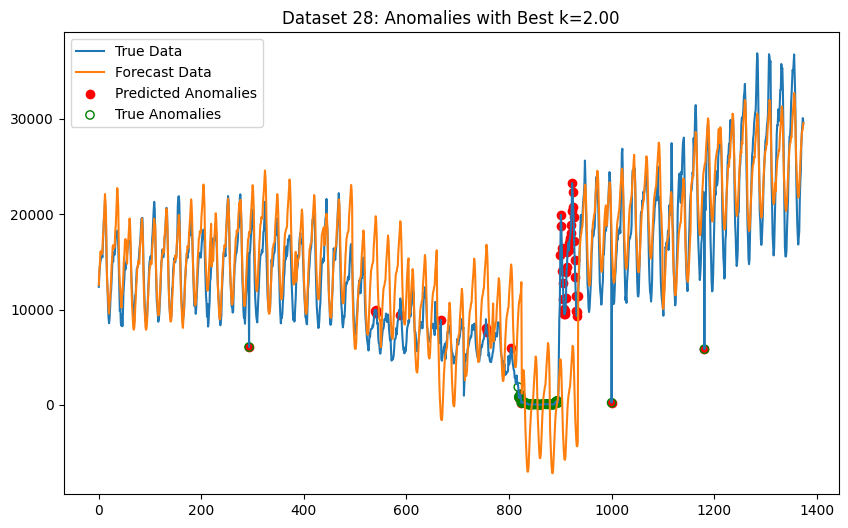

Dataset 43: Best k=2.50, Precision=0.58, Recall=0.56, F1=0.80


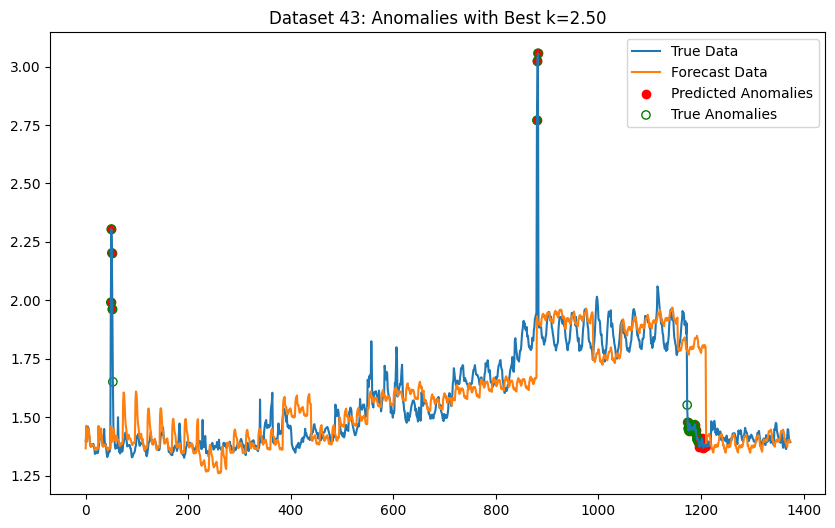

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 46: Best k=1.50, Precision=0.03, Recall=0.01, F1=0.02


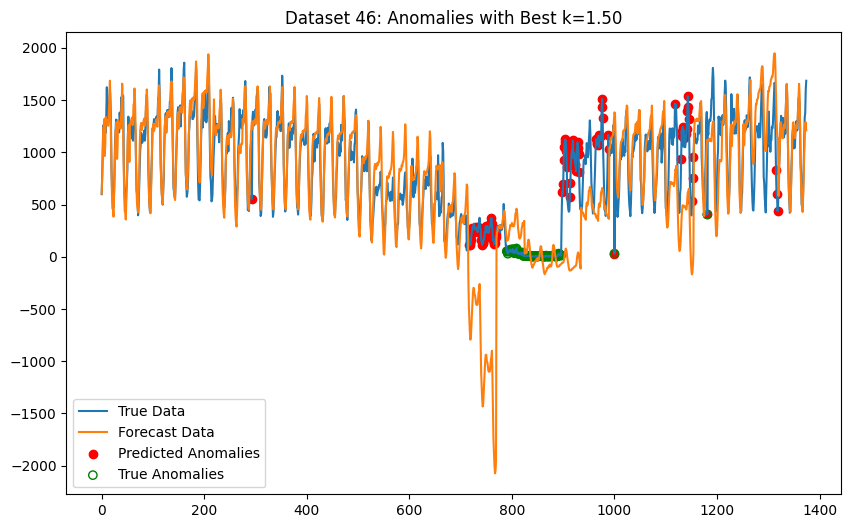

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

Dataset 55: Best k=3.00, Precision=0.17, Recall=0.80, F1=0.29


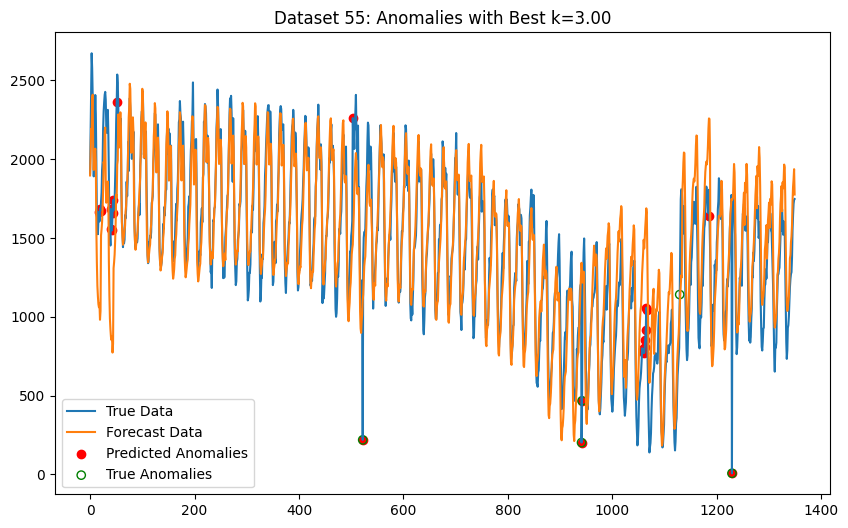

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

Dataset 56: Best k=3.00, Precision=0.19, Recall=0.60, F1=0.29


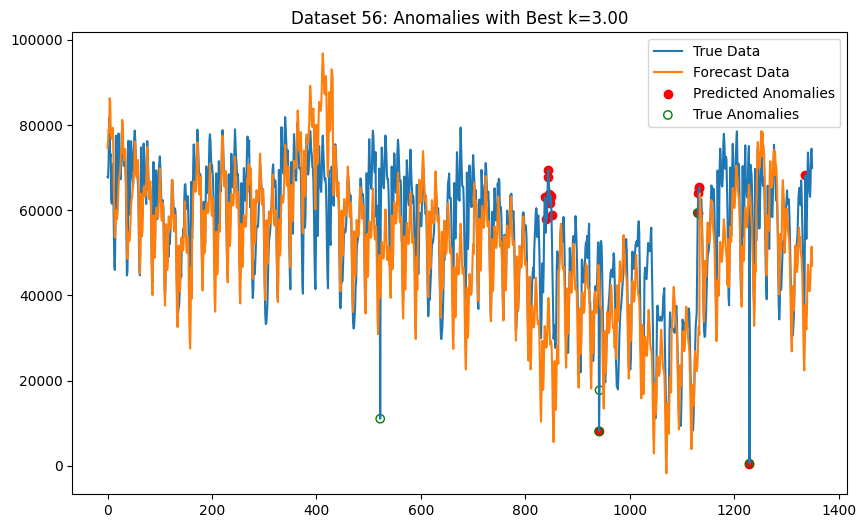

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 65: Best k=2.50, Precision=0.41, Recall=0.41, F1=0.42


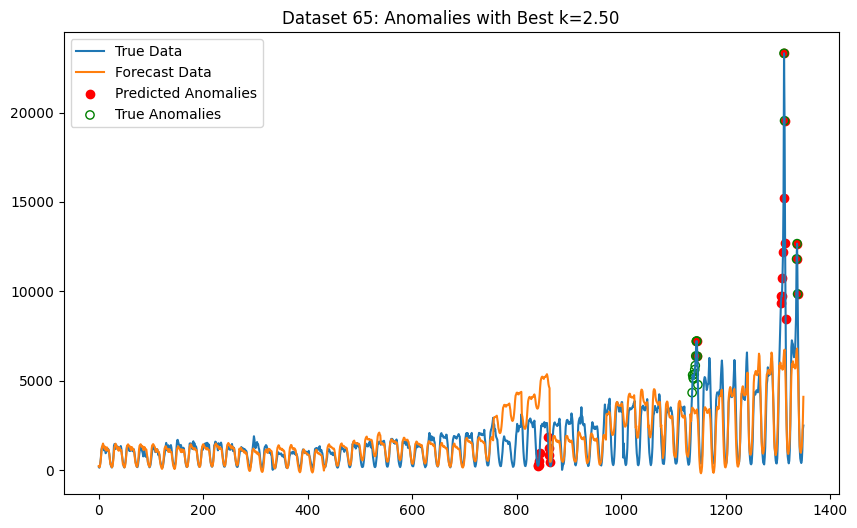


Average Metrics Across All Datasets:
Average Precision=0.25
Average Recall=0.41
Average F1-Score=0.32
All F1 Scores for each dataset: 0.1343, 0.8000, 0.0185, 0.2857, 0.2857, 0.4186


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Datasets
A1D = [28,43,46,55,56,65]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=25)

# Parameters for tuning
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1D:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Apply exponential smoothing on the training data
        model = ExponentialSmoothing(y_train, trend="add", seasonal="add", seasonal_periods=24, initialization_method="estimated")
        model_fit = model.fit()

        # Forecast on the test data
        forecast = model_fit.forecast(steps=len(y_test))

        # Calculate residuals
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

    # Find the optimal k using combined residuals
    best_k = None
    best_f1 = -1
    best_combined_predicted_anomalies = None

    # Calculate static mean and std of residuals
    mean_residuals = np.mean(combined_residuals)
    std_residuals = np.std(combined_residuals)

    for k in k_values:
        # Static threshold
        threshold = mean_residuals + k * std_residuals
        predicted_anomalies = (np.array(combined_residuals) > threshold).astype(int)

        # Compute F1 score for the current k
        precision = precision_score(combined_true_anomalies, predicted_anomalies)
        recall = recall_score(combined_true_anomalies, predicted_anomalies)
        f1 = f1_score(combined_true_anomalies, predicted_anomalies)

        # Check if this k is the best so far
        if f1 > best_f1:
            best_f1 = f1
            best_k = k
            best_combined_predicted_anomalies = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)

    print(f"Dataset {i}: Best k={best_k:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best k={best_k:.2f}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## dynamic

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

Dataset 28: Best k=2.50, Best Window=200, Precision=0.13, Recall=0.10, F1=0.11


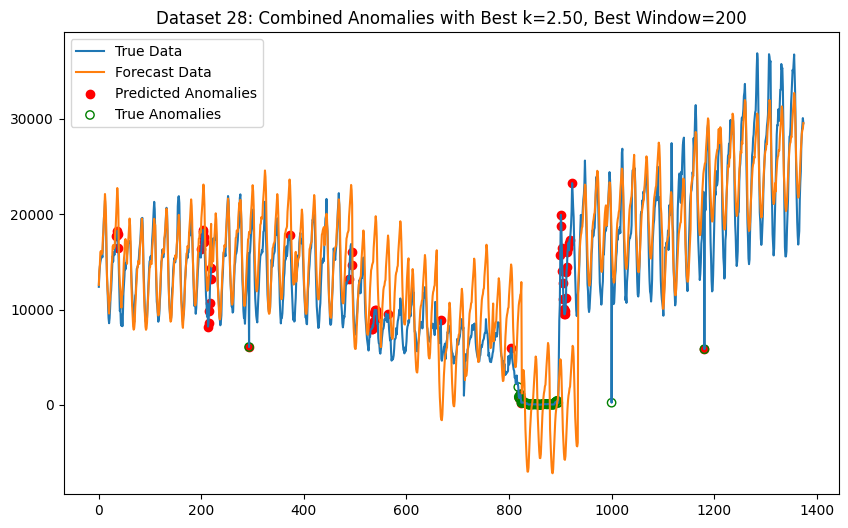

Dataset 43: Best k=3.00, Best Window=200, Precision=0.30, Recall=0.28, F1=0.68


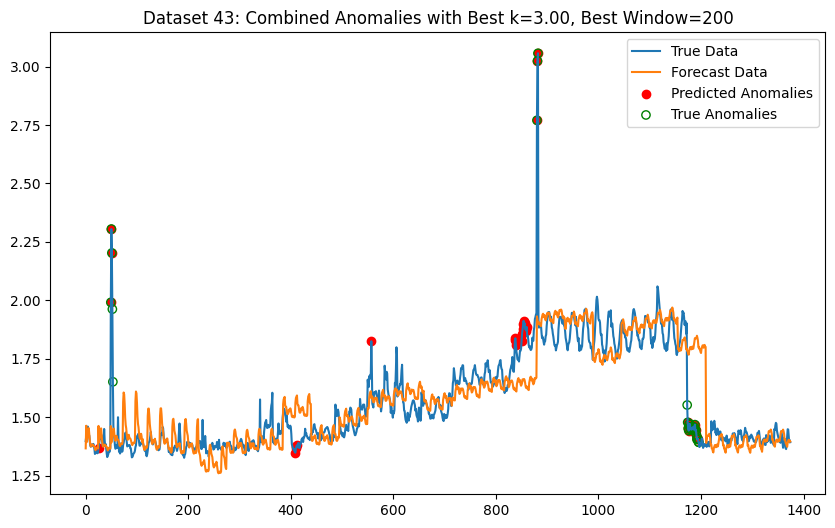

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 46: Best k=1.50, Best Window=200, Precision=0.00, Recall=0.00, F1=0.01


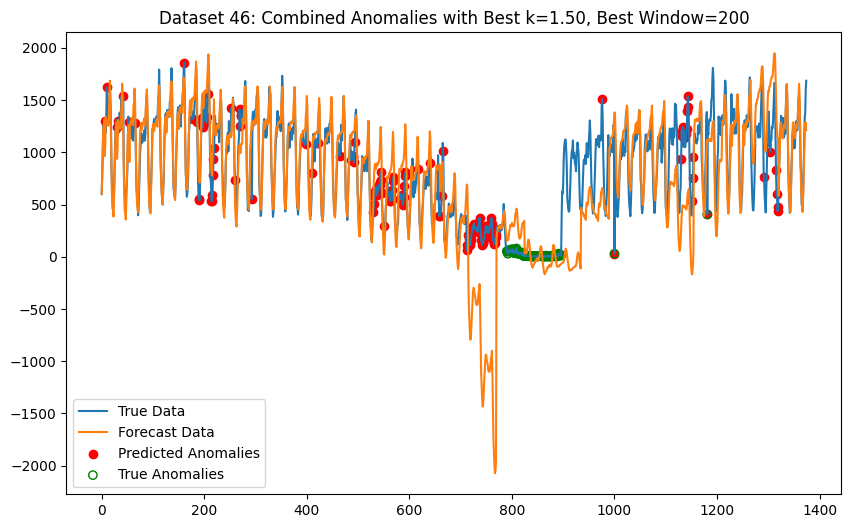

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

Dataset 55: Best k=3.00, Best Window=500, Precision=0.18, Recall=0.80, F1=0.30


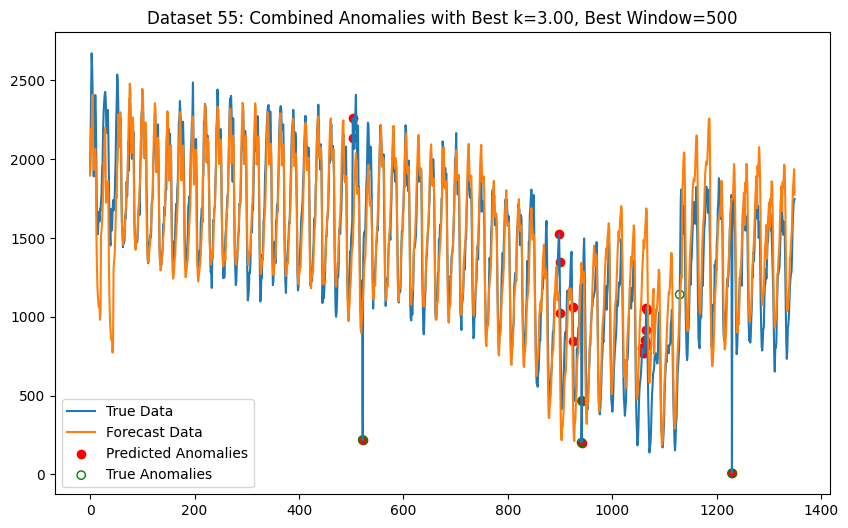

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

Dataset 56: Best k=3.00, Best Window=200, Precision=0.15, Recall=0.80, F1=0.26


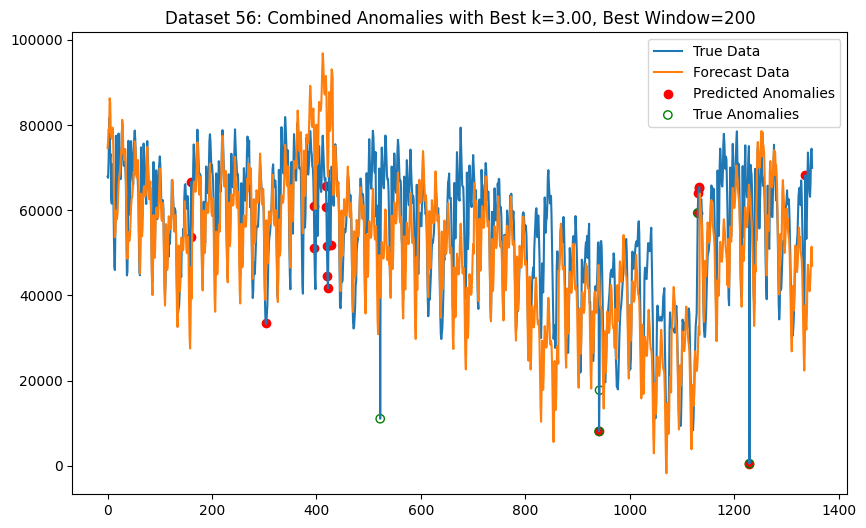

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Dataset 65: Best k=3.00, Best Window=100, Precision=0.06, Recall=0.35, F1=0.28


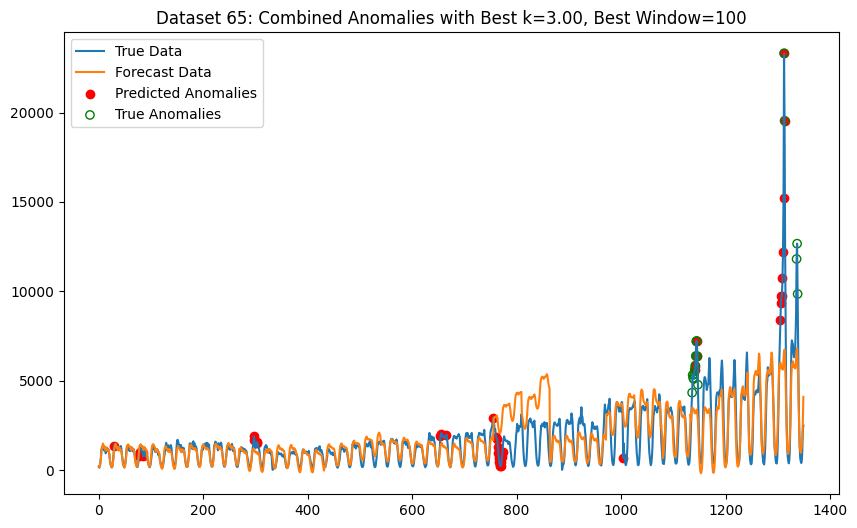


Average Metrics Across All Datasets:
Average Precision=0.14
Average Recall=0.39
Average F1-Score=0.27
All F1 Scores for each dataset: 0.1119, 0.6835, 0.0148, 0.2963, 0.2609, 0.2759


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Datasets
A1D = [28,43,46,55,56,65]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=25)

# Parameters for tuning
window_sizes = [100, 200, 300, 500]  # Rolling window sizes to test
k_values = [1.5,2,2.5,3]  # Test k values from 1 to 4.5 in 0.5 steps

for i in A1D:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Apply exponential smoothing on the training data
        model = ExponentialSmoothing(y_train, trend="add", seasonal="add", seasonal_periods=24, initialization_method="estimated")
        model_fit = model.fit()

        # Forecast on the test data
        forecast = model_fit.forecast(steps=len(y_test))

        # Calculate residuals
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

    # Find the optimal combination of window size and k using combined residuals
    best_window = None
    best_k = None
    best_f1 = -1
    best_combined_predicted_anomalies = None

    for window_size in window_sizes:
        for k in k_values:
            # Calculate rolling statistics for dynamic threshold
            rolling_residuals = pd.Series(combined_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            # Determine anomalies using dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies = (pd.Series(combined_residuals) > threshold).astype(int)

            # Compute F1 score for the current window size and k
            precision = precision_score(combined_true_anomalies, predicted_anomalies)
            recall = recall_score(combined_true_anomalies, predicted_anomalies)
            f1 = f1_score(combined_true_anomalies, predicted_anomalies)

            # Check if this combination of window size and k is the best so far
            if f1 > best_f1:
                best_f1 = f1
                best_k = k
                best_window = window_size
                best_combined_predicted_anomalies = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)

    print(f"Dataset {i}: Best k={best_k:.2f}, Best Window={best_window}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best k={best_k:.2f}, Best Window={best_window}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## SARIMA

## A1A

## static

Dataset 1: Best p=2, q=2, k=3, MAE=0.05, Precision=0.09, Recall=1.00, F1=0.17


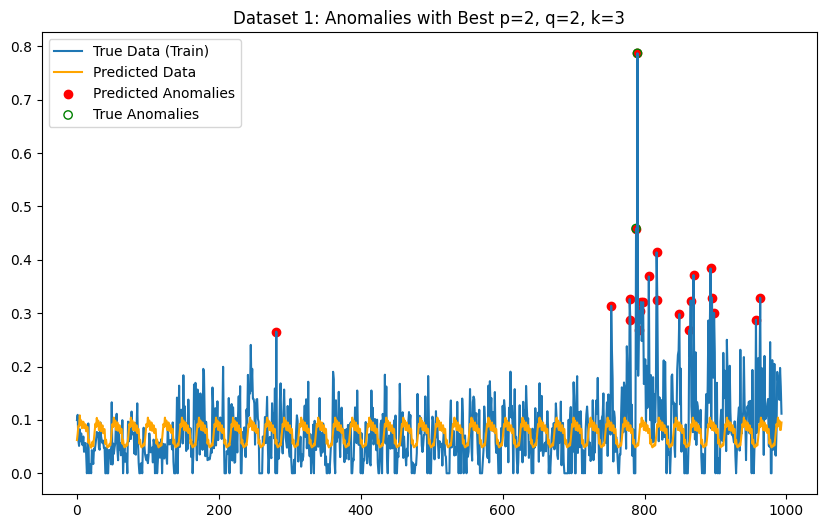

Dataset 2: Best p=2, q=1, k=1.5, MAE=4120.35, Precision=1.00, Recall=0.44, F1=0.81


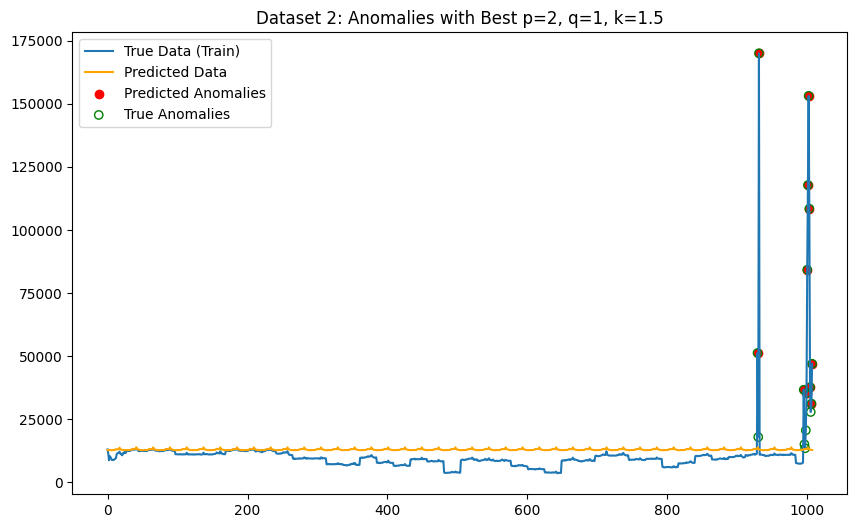

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 3: Best p=1, q=2, k=1.5, MAE=0.24, Precision=1.00, Recall=0.93, F1=0.97


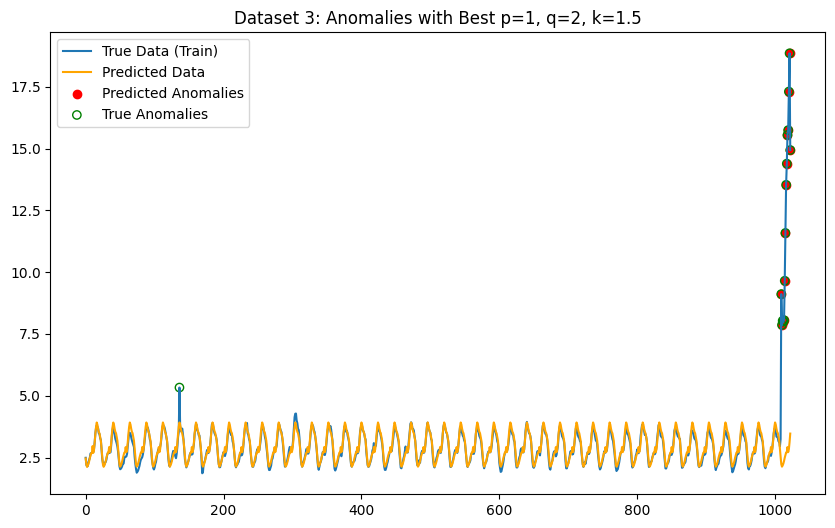

Dataset 8: Best p=1, q=2, k=3, MAE=105.37, Precision=0.77, Recall=1.00, F1=0.87


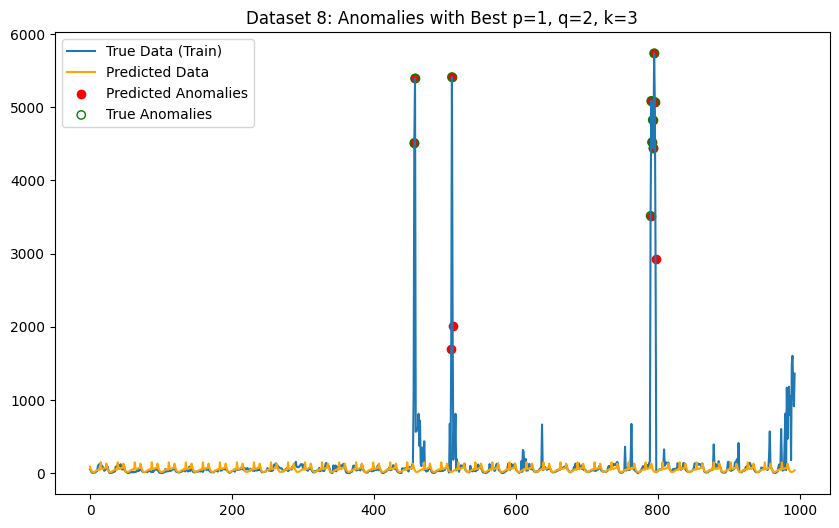

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 9: Best p=1, q=1, k=1.5, MAE=0.01, Precision=0.75, Recall=0.38, F1=0.71


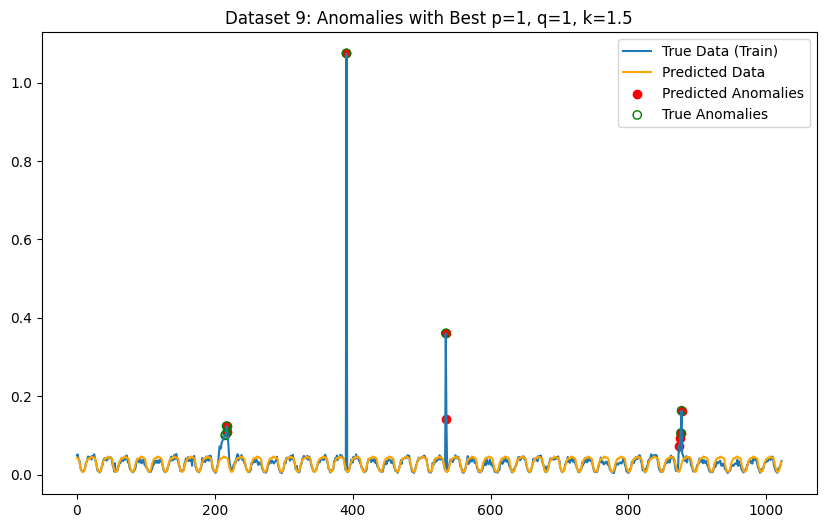

Dataset 10: Best p=2, q=1, k=2.5, MAE=0.47, Precision=0.93, Recall=1.00, F1=0.96


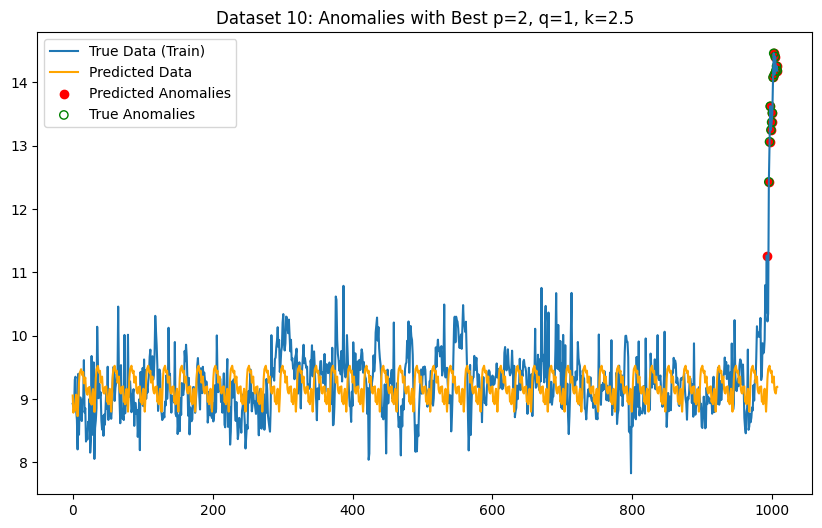

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 13: Best p=1, q=2, k=3, MAE=2535.76, Precision=1.00, Recall=0.44, F1=0.62


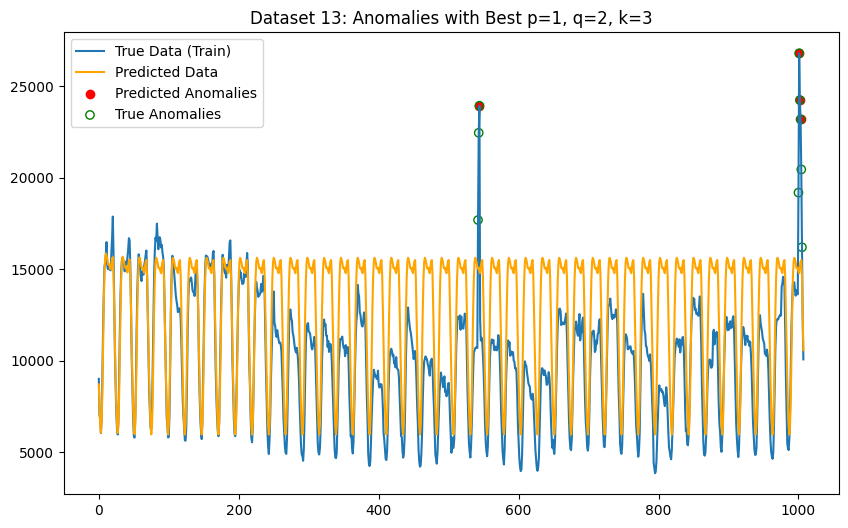

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 23: Best p=2, q=2, k=3, MAE=0.07, Precision=0.53, Recall=1.00, F1=0.69


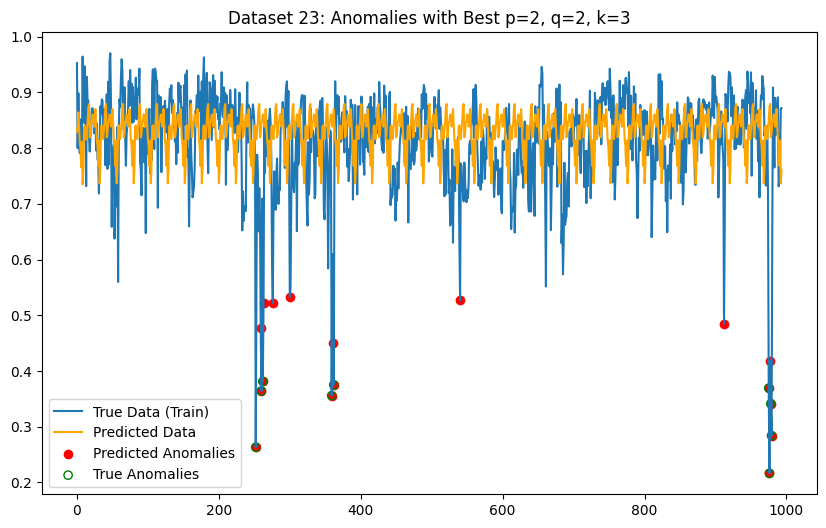

Dataset 24: Best p=2, q=1, k=2, MAE=1.00, Precision=0.94, Recall=1.00, F1=0.97


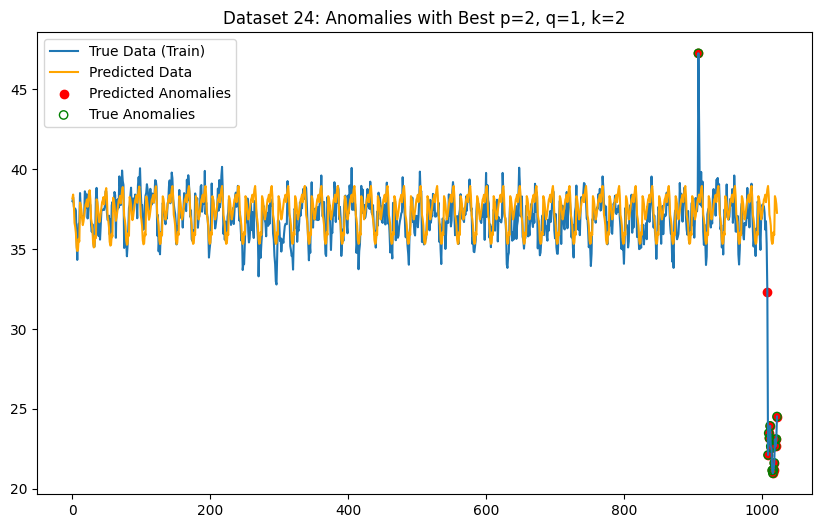

Dataset 27: Best p=2, q=1, k=3, MAE=73.26, Precision=0.22, Recall=1.00, F1=0.36


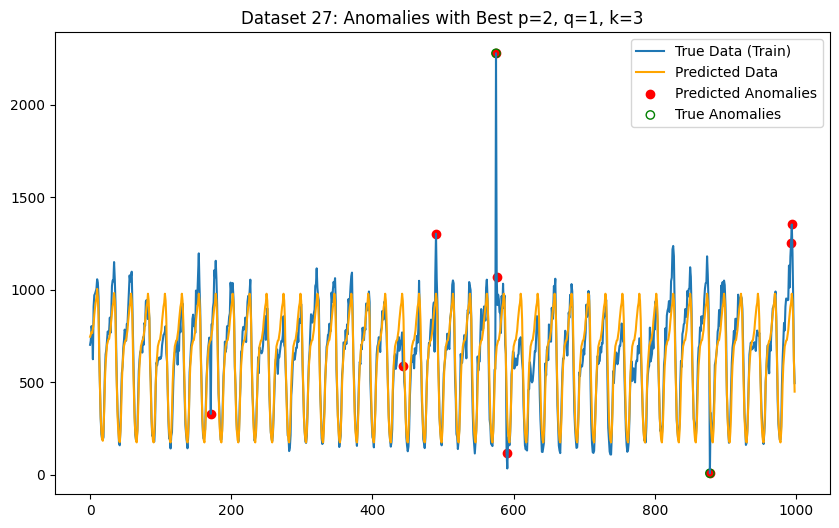

Dataset 34: Best p=2, q=1, k=3, MAE=2475.76, Precision=0.75, Recall=0.86, F1=0.80


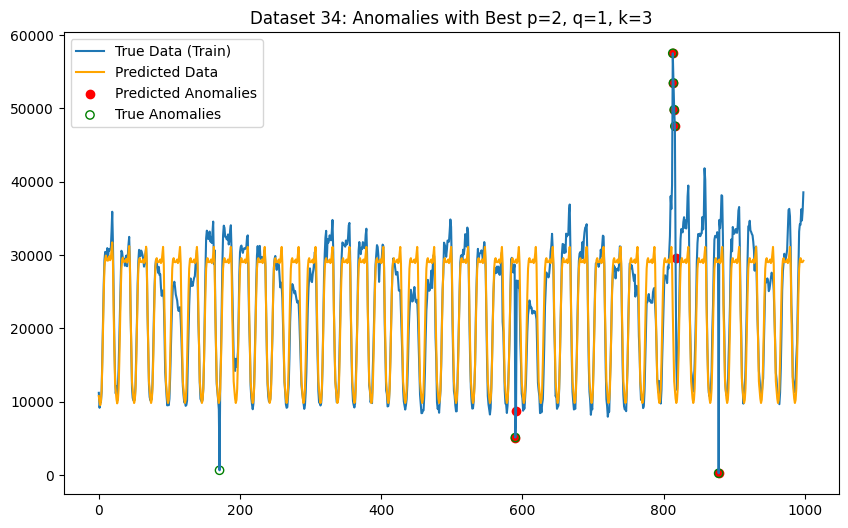

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 41: Best p=2, q=2, k=3, MAE=53.98, Precision=0.17, Recall=1.00, F1=0.29


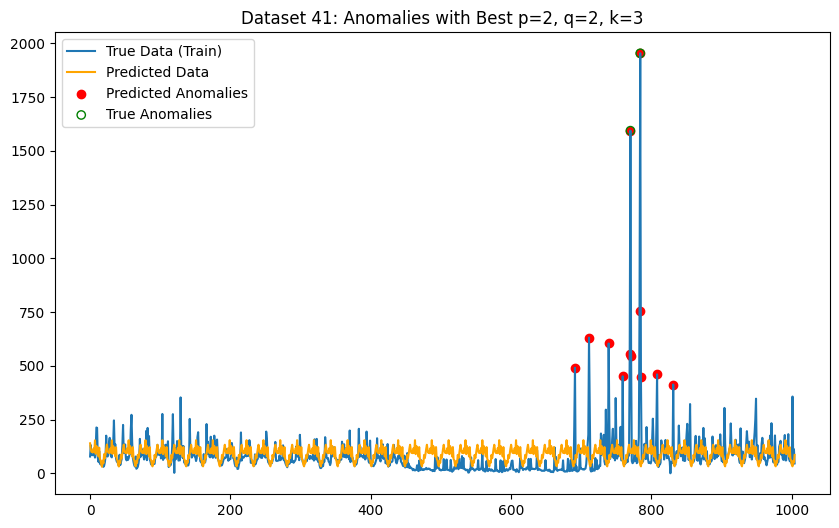

Dataset 66: Best p=2, q=2, k=3, MAE=49.45, Precision=0.90, Recall=0.90, F1=0.90


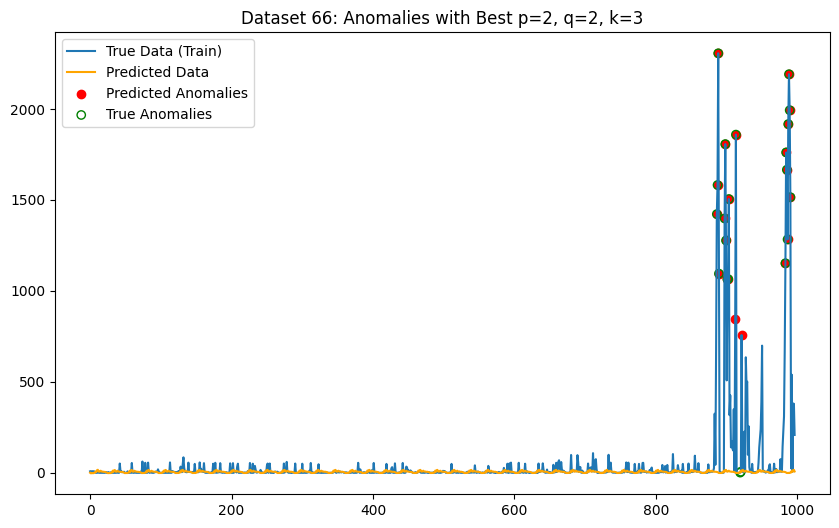


Average Metrics Across All Datasets:
Average MAE=724.29
Average Precision=0.70
Average Recall=0.84
Average F1-Score=0.70
All F1 Scores for each dataset: 0.1667, 0.8148, 0.9655, 0.8696, 0.7059, 0.9630, 0.6154, 0.6923, 0.9677, 0.3636, 0.8000, 0.2857, 0.9048


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets to process
A1A = [1, 2, 3, 8, 9, 10, 13, 23, 24, 27, 34, 41, 66]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# Storage for average MAE values
all_mae_scores = []

# Parameters to iterate over
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
possible_ks = [1.5, 2, 2.5, 3]

for i in A1A:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    # Split data into 30% fit and 70% train
    split_index = int(len(data) * 0.3)
    fit_data = data[:split_index]
    train_data = data[split_index:]
    train_labels = labels[split_index:]

    best_p = None
    best_q = None
    best_k = None
    best_mae = float('inf')
    best_model = None
    best_residuals = None
    best_f1 = -1
    best_predicted_anomalies = None

    # Iterate over different values of p and q
    for p in p_values:
        for q in q_values:
            try:
                # Fit SARIMAX model on the fit_data
                sarimax_model = SARIMAX(fit_data,
                                        order=(p, d, q),
                                        seasonal_order=(P, D, Q, m),
                                        enforce_stationarity=False,
                                        enforce_invertibility=False)
                model_fit = sarimax_model.fit(disp=False)

                # Forecast on train_data
                forecast = model_fit.get_forecast(steps=len(train_data))
                forecasted_values = forecast.predicted_mean

                # Calculate MAE on the forecast
                mae = mean_absolute_error(train_data, forecasted_values)

                # Check for the best MAE
                if mae < best_mae:
                    best_mae = mae
                    best_p = p
                    best_q = q
                    best_model = model_fit
                    best_residuals = np.abs(train_data - forecasted_values)

            except Exception as e:
                print(f"Error with p={p}, q={q} for dataset {i}: {e}")

    # Iterate over different values of k to find the optimal threshold multiplier
    for k in possible_ks:
        residuals = best_residuals
        mean_resid = np.mean(residuals)
        std_resid = np.std(residuals)
        threshold = mean_resid + k * std_resid
        predicted_anomalies = (residuals > threshold).astype(int)

        # Compute metrics
        precision = precision_score(train_labels, predicted_anomalies)
        recall = recall_score(train_labels, predicted_anomalies)
        f1 = f1_score(train_labels, predicted_anomalies)

        # Check if this k is the best so far
        if f1 > best_f1:
            best_f1 = f1
            best_k = k
            best_predicted_anomalies = predicted_anomalies

    # Store metrics
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)
    all_mae_scores.append(best_mae)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, k={best_k}, MAE={best_mae:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(train_data, label='True Data (Train)')
    plt.plot(forecasted_values, label='Predicted Data', color='orange')
    anomaly_indices = np.where(best_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, train_data[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(train_labels == 1)[0], train_data[train_labels == 1], color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best p={best_p}, q={best_q}, k={best_k}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)
average_mae = np.mean(all_mae_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average MAE={average_mae:.2f}")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## dynamic

Dataset 1: Best p=2, q=2, Best k=3.00, Best Window=100, MAE=0.05, Precision=0.06, Recall=1.00, F1=0.29


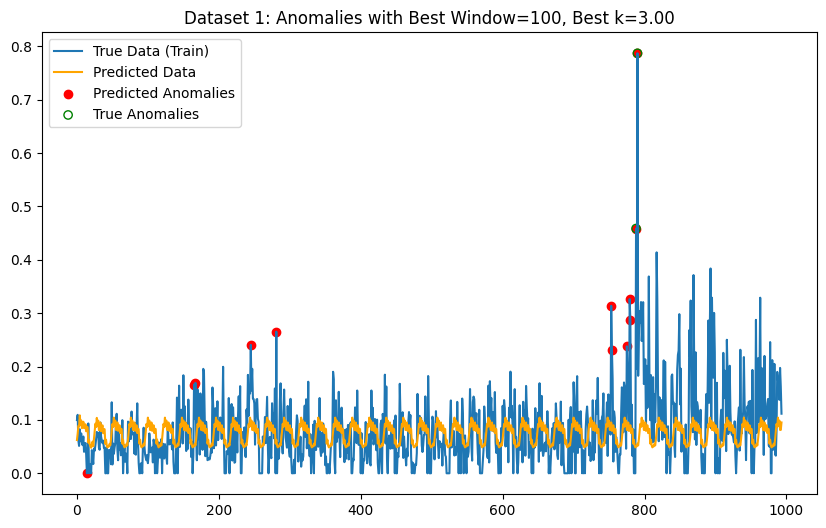

Dataset 2: Best p=2, q=1, Best k=3.00, Best Window=200, MAE=4120.35, Precision=0.27, Recall=0.38, F1=0.34


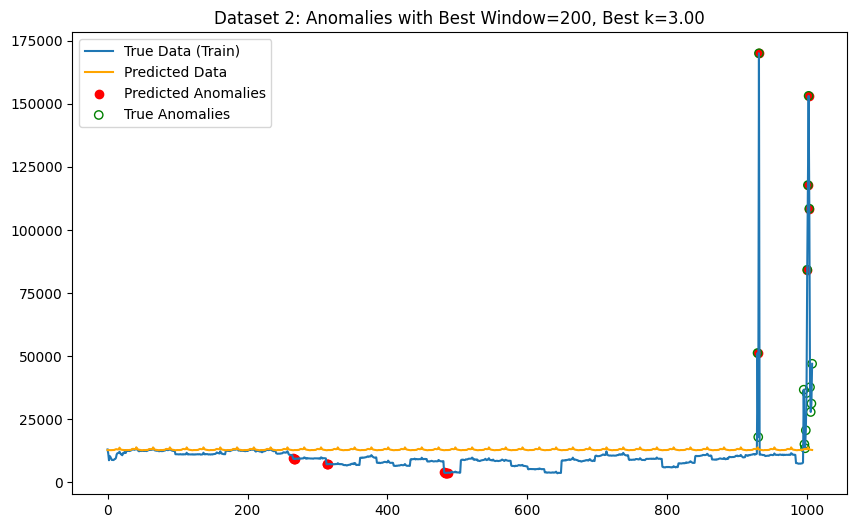

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 3: Best p=1, q=2, Best k=3.00, Best Window=300, MAE=0.24, Precision=0.54, Recall=1.00, F1=0.81


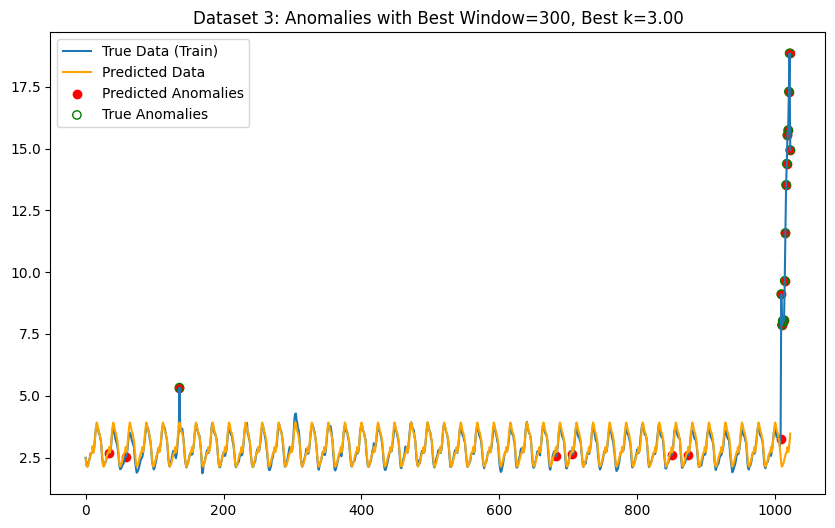

Dataset 8: Best p=1, q=2, Best k=3.00, Best Window=200, MAE=105.37, Precision=0.36, Recall=1.00, F1=0.54


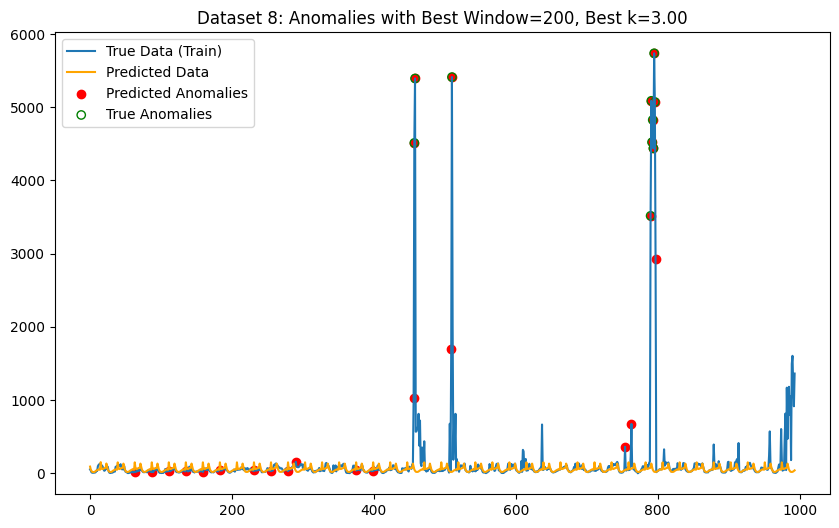

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 9: Best p=1, q=1, Best k=3.00, Best Window=300, MAE=0.01, Precision=0.29, Recall=0.75, F1=0.47


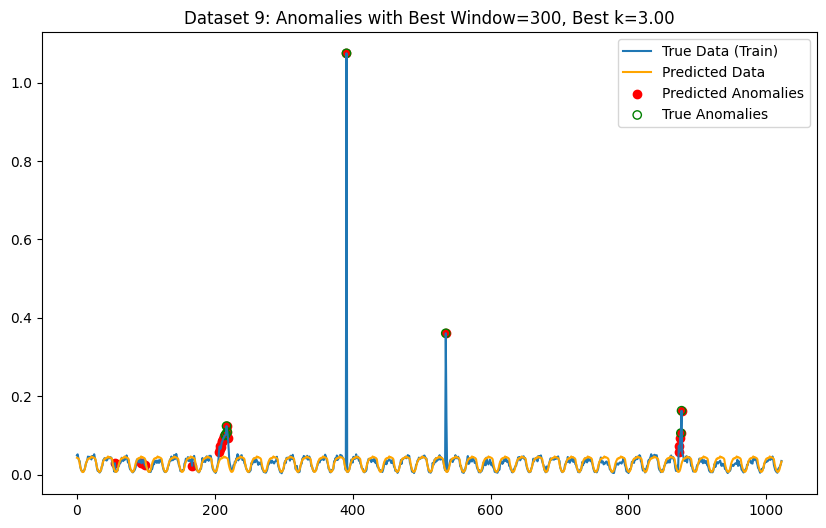

Dataset 10: Best p=2, q=1, Best k=3.00, Best Window=200, MAE=0.47, Precision=0.50, Recall=1.00, F1=0.74


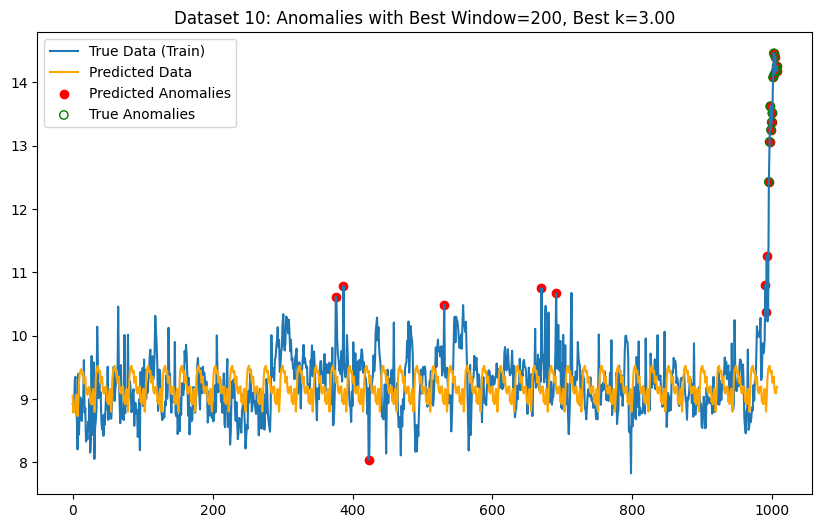

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 13: Best p=1, q=2, Best k=3.00, Best Window=300, MAE=2535.76, Precision=0.14, Recall=0.56, F1=0.29


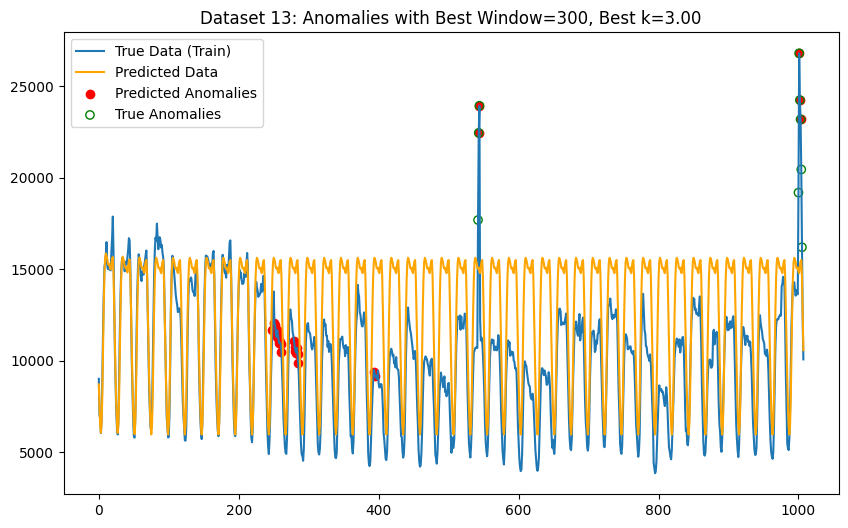

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 23: Best p=2, q=2, Best k=3.00, Best Window=500, MAE=0.07, Precision=0.47, Recall=1.00, F1=0.64


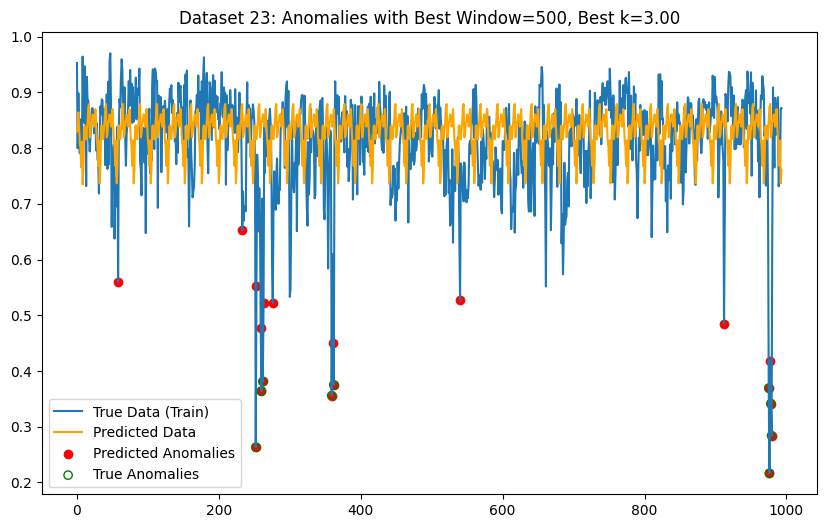

Dataset 24: Best p=2, q=1, Best k=3.00, Best Window=200, MAE=1.00, Precision=0.60, Recall=1.00, F1=0.77


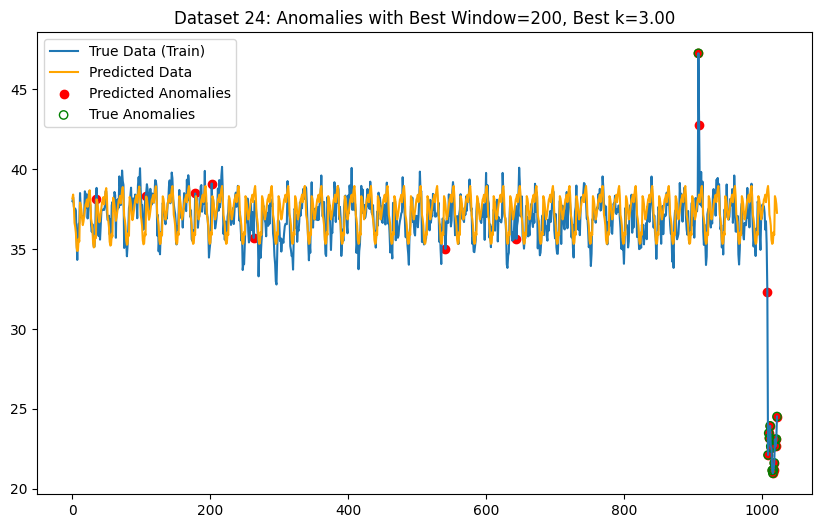

Dataset 27: Best p=2, q=1, Best k=3.00, Best Window=500, MAE=73.26, Precision=0.20, Recall=1.00, F1=0.33


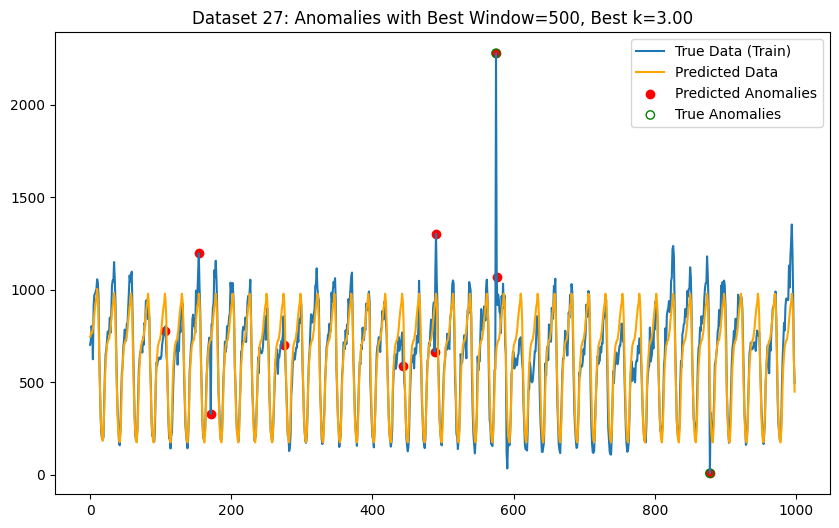

Dataset 34: Best p=2, q=1, Best k=3.00, Best Window=200, MAE=2475.76, Precision=0.26, Recall=1.00, F1=0.47


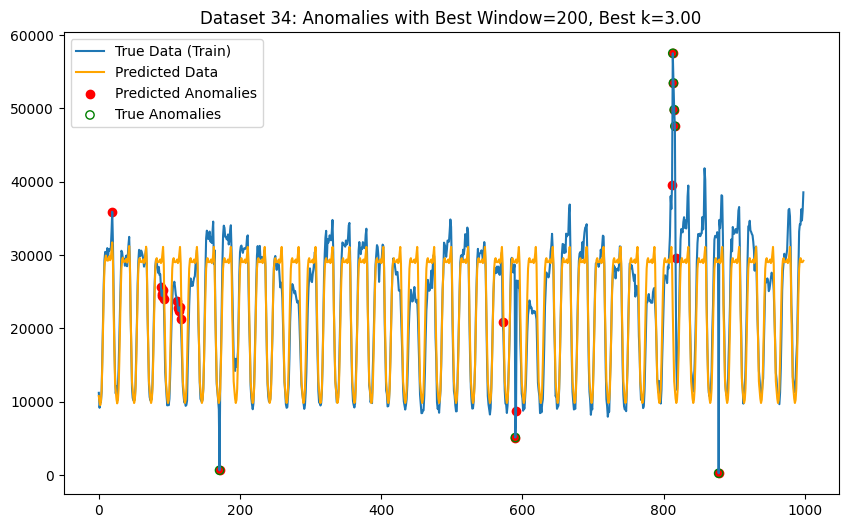

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 41: Best p=2, q=2, Best k=3.00, Best Window=100, MAE=53.98, Precision=0.09, Recall=1.00, F1=0.22


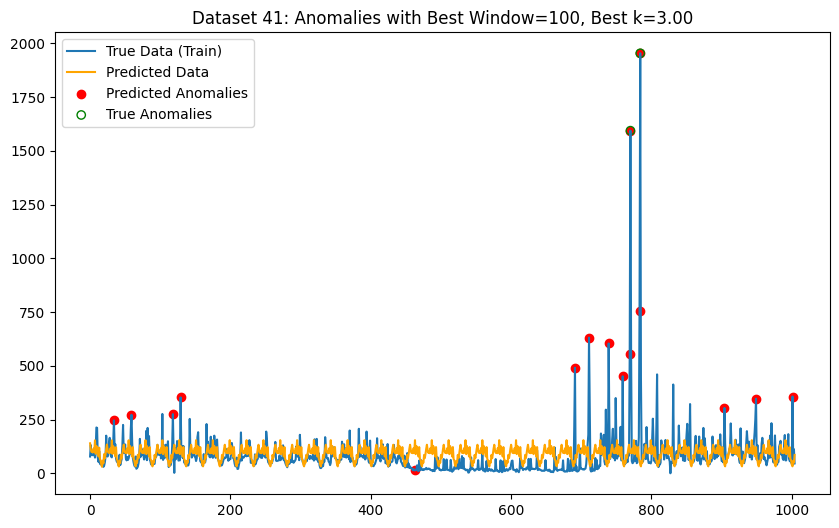

Dataset 66: Best p=2, q=2, Best k=3.00, Best Window=300, MAE=49.45, Precision=0.30, Recall=0.90, F1=0.46


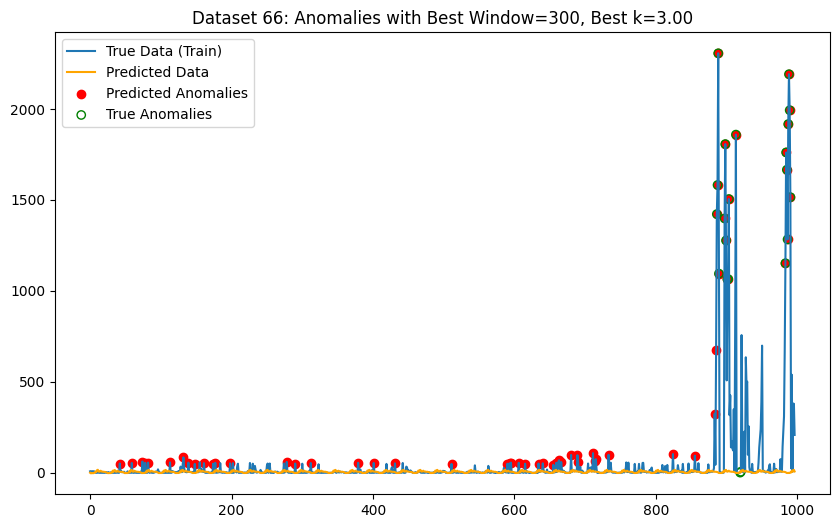


Average Metrics Across All Datasets:
Average MAE=724.29
Average Precision=0.31
Average Recall=0.89
Average F1-Score=0.49
All F1 Scores for each dataset: 0.2857, 0.3429, 0.8108, 0.5405, 0.4706, 0.7429, 0.2857, 0.6429, 0.7692, 0.3333, 0.4667, 0.2222, 0.4578


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets to process
A1A = [1, 2, 3, 8, 9, 10, 13, 23, 24, 27, 34, 41, 66]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# Storage for average MAE values
all_mae_scores = []

# Parameters to iterate over
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
window_sizes = [100, 200, 300 , 500]  # Rolling window sizes to test
k_values = [1.5, 2, 2.5, 3]  # Threshold multipliers to test

for i in A1A:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    # Split data into 30% fit and 70% train
    split_index = int(len(data) * 0.3)
    fit_data = data[:split_index]
    train_data = data[split_index:]
    train_labels = labels[split_index:]

    best_p = None
    best_q = None
    best_k = None
    best_window = None
    best_mae = float('inf')
    best_f1 = -1
    best_predicted_anomalies = None

    try:
        # Iterate over different values of p and q
        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the fit_data
                    sarimax_model = SARIMAX(fit_data,
                                            order=(p, d, q),
                                            seasonal_order=(P, D, Q, m),
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)
                    model_fit = sarimax_model.fit(disp=False)

                    # Forecast on train_data
                    forecast = model_fit.get_forecast(steps=len(train_data))
                    forecasted_values = forecast.predicted_mean

                    # Calculate MAE on the forecast
                    mae = mean_absolute_error(train_data, forecasted_values)

                    # Store the residuals
                    residuals = np.abs(train_data - forecasted_values)

                    if mae < best_mae:
                        best_mae = mae
                        best_p = p
                        best_q = q
                        best_residuals = residuals

                except Exception as e:
                    print(f"Error with p={p}, q={q} for dataset {i}: {e}")

        # Iterate over different window sizes and k values for dynamic threshold
        for window_size in window_sizes:
            rolling_residuals = pd.Series(best_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            for k in k_values:
                # Dynamic threshold
                threshold = mean_residuals + k * std_residuals
                predicted_anomalies = (best_residuals > threshold).astype(int)

                # Compute metrics
                precision = precision_score(train_labels, predicted_anomalies)
                recall = recall_score(train_labels, predicted_anomalies)
                f1 = f1_score(train_labels, predicted_anomalies)

                # Check if this combination of window size and k is the best so far
                if f1 > best_f1:
                    best_f1 = f1
                    best_k = k
                    best_window = window_size
                    best_predicted_anomalies = predicted_anomalies

    except Exception as e:
        print(f"Error processing dataset {i}: {e}")

    # Store metrics
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)
    all_mae_scores.append(best_mae)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k:.2f}, Best Window={best_window}, "
          f"MAE={best_mae:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(train_data, label='True Data (Train)')
    plt.plot(forecasted_values, label='Predicted Data', color='orange')
    anomaly_indices = np.where(best_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, train_data[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(train_labels == 1)[0], train_data[train_labels == 1], color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best Window={best_window}, Best k={best_k:.2f}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)
average_mae = np.mean(all_mae_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average MAE={average_mae:.2f}")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 1: Best p=1, q=2, Best k=3.00, Precision=0.08, Recall=1.00, F1=0.15


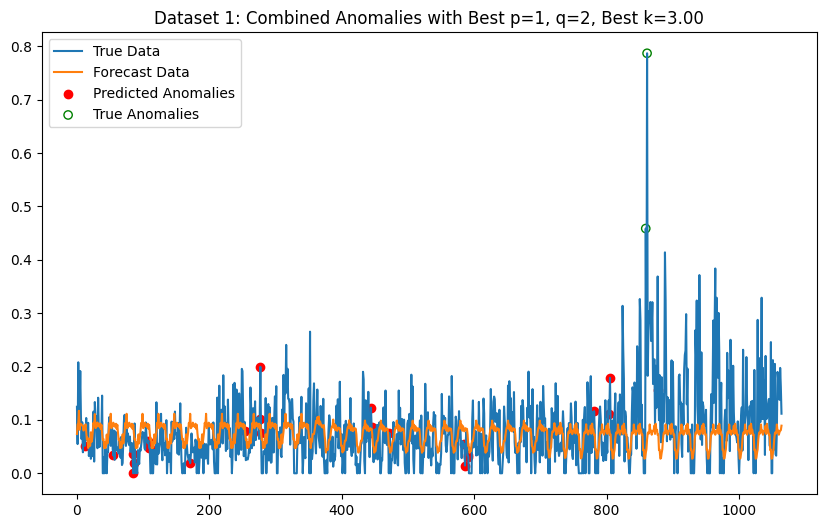

Dataset 1: Best p=1, q=2, Best k=3.00, Best Window=100, Precision=0.07, Recall=1.00, F1=0.29


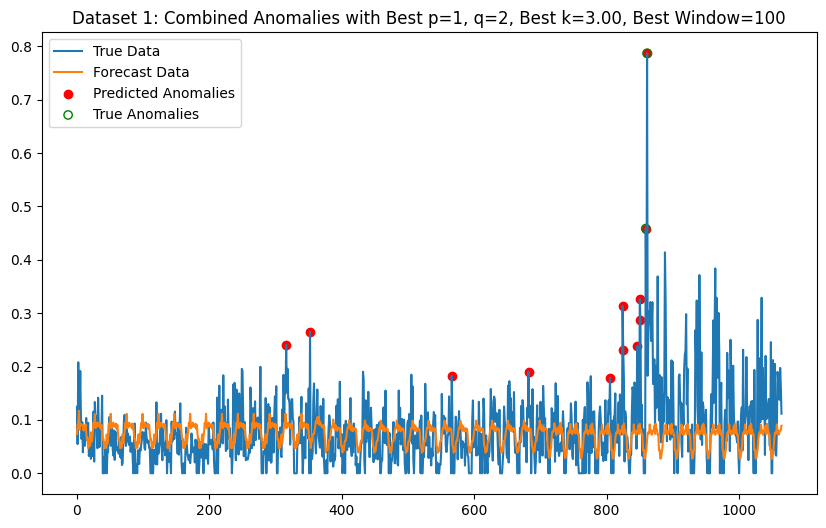

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood op

Dataset 2: Best p=1, q=1, Best k=1.50, Precision=1.00, Recall=0.50, F1=0.86


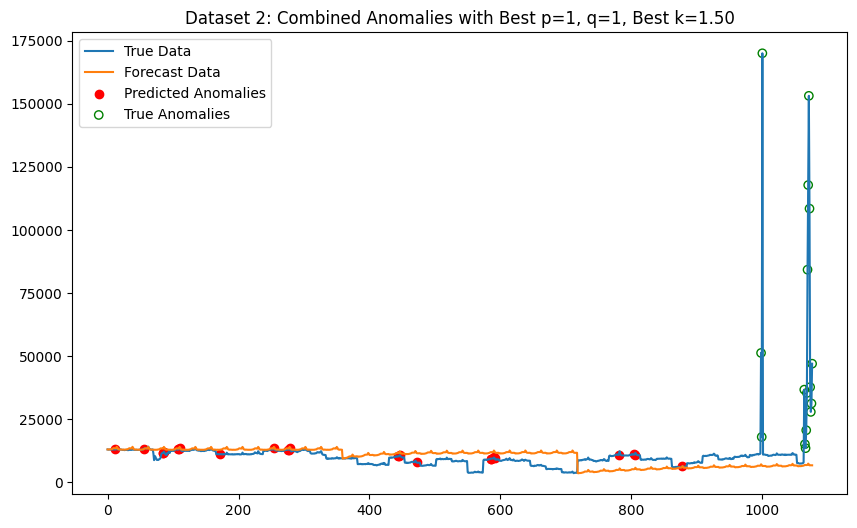

Dataset 2: Best p=1, q=1, Best k=3.00, Best Window=300, Precision=0.21, Recall=0.50, F1=0.32


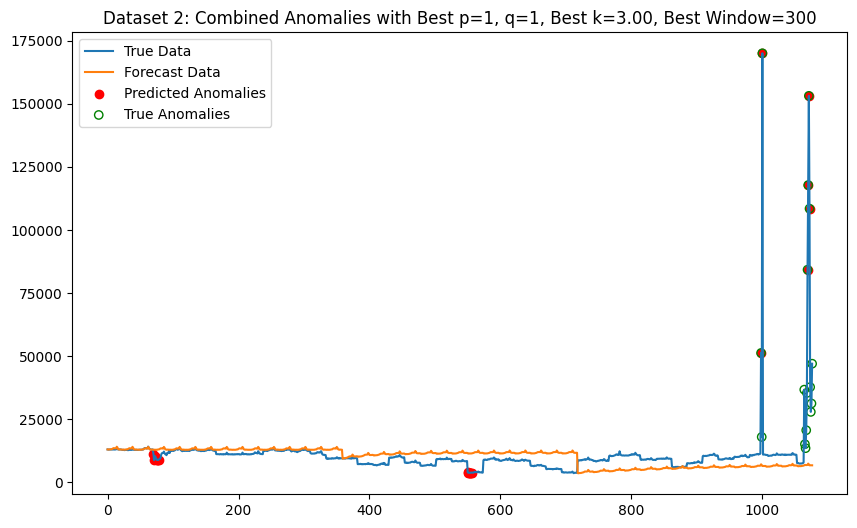

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 3: Best p=1, q=1, Best k=1.50, Precision=1.00, Recall=0.93, F1=0.97


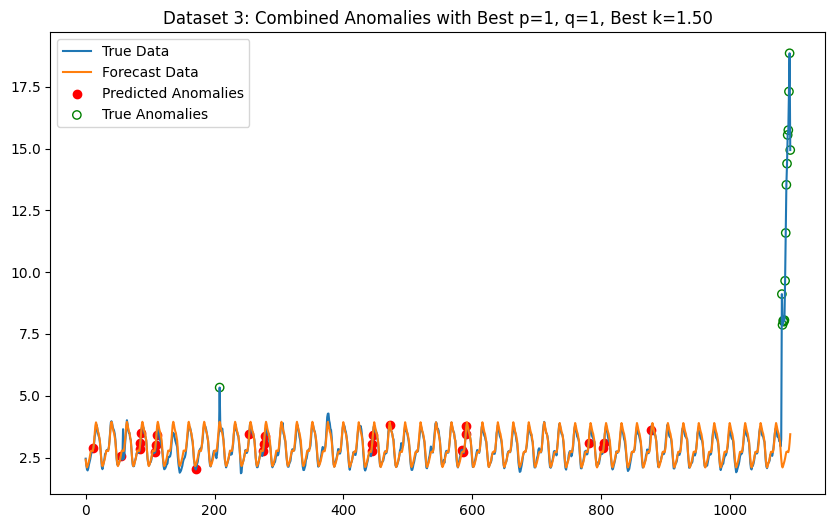

Dataset 3: Best p=1, q=1, Best k=3.00, Best Window=300, Precision=0.60, Recall=1.00, F1=0.77


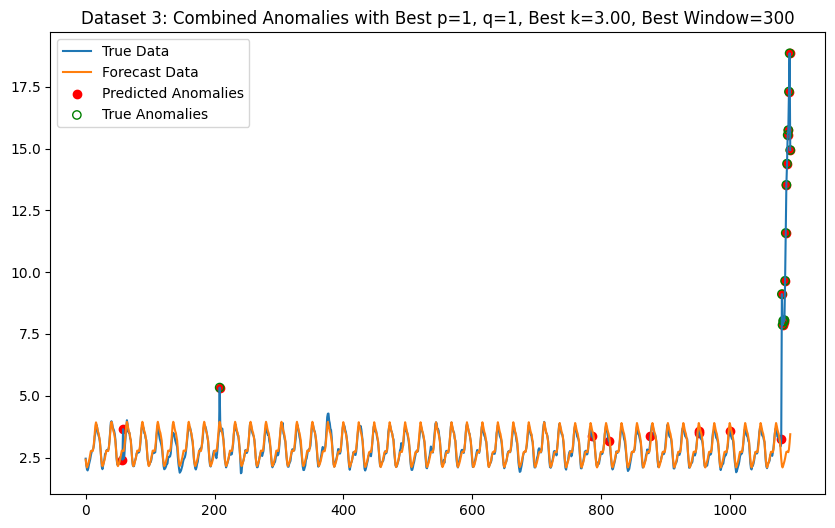

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 8: Best p=1, q=2, Best k=3.00, Precision=0.77, Recall=1.00, F1=0.87


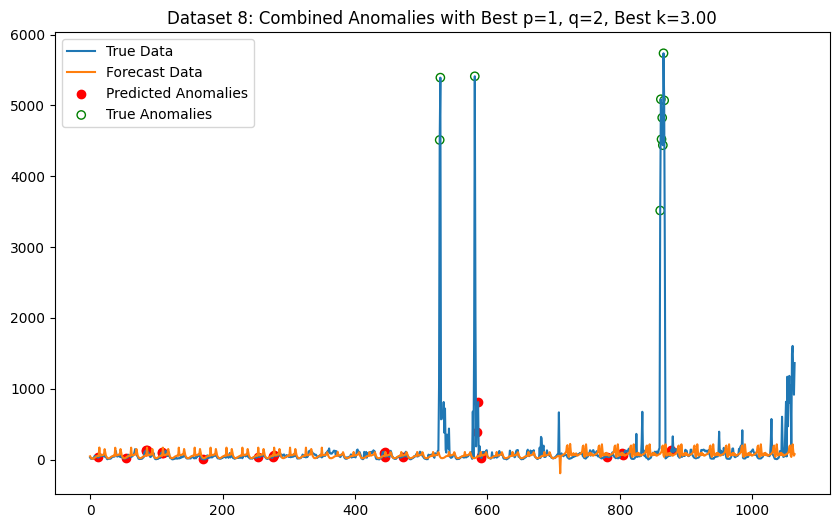

Dataset 8: Best p=1, q=2, Best k=3.00, Best Window=200, Precision=0.37, Recall=1.00, F1=0.54


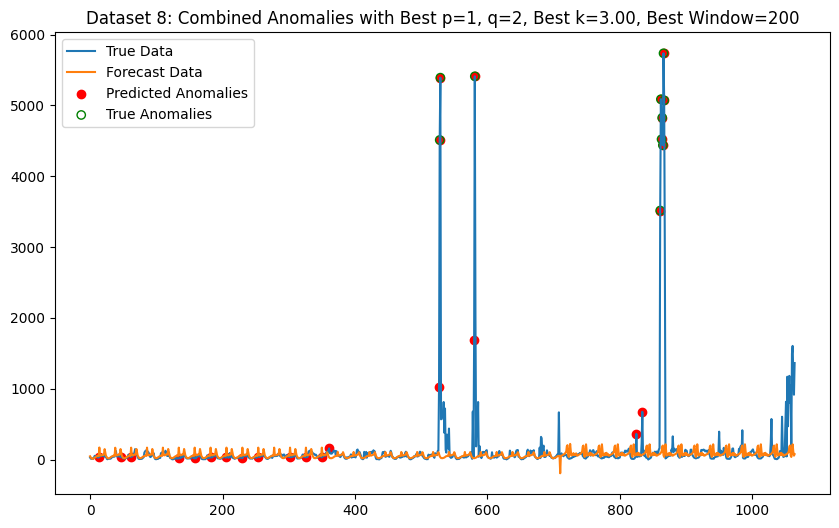

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood op

Dataset 9: Best p=2, q=1, Best k=1.50, Precision=0.75, Recall=0.38, F1=0.71


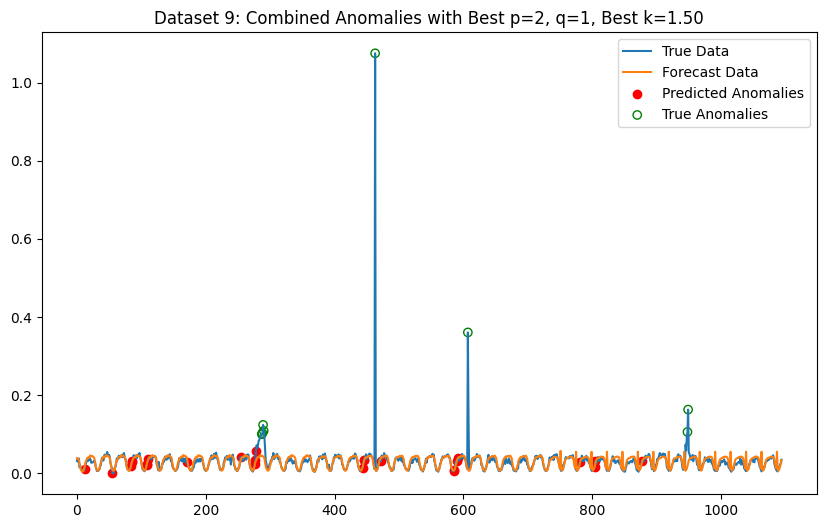

Dataset 9: Best p=2, q=1, Best k=3.00, Best Window=300, Precision=0.29, Recall=0.75, F1=0.44


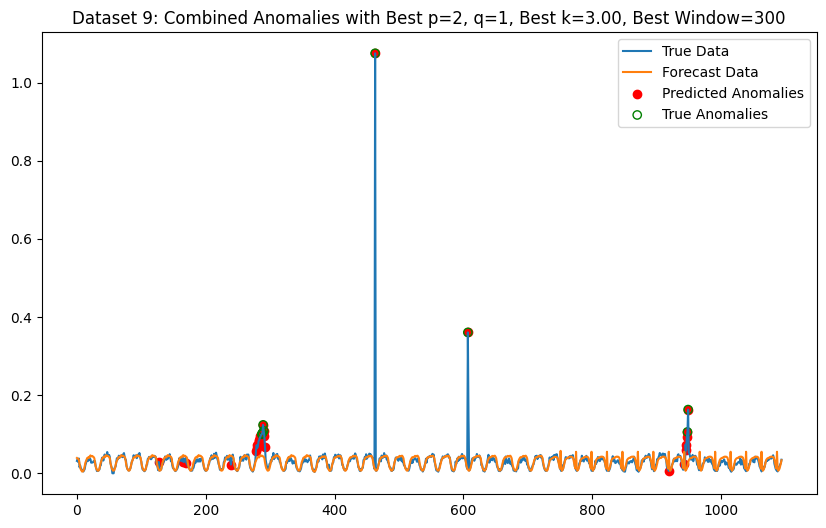

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 10: Best p=1, q=1, Best k=3.00, Precision=1.00, Recall=1.00, F1=1.00


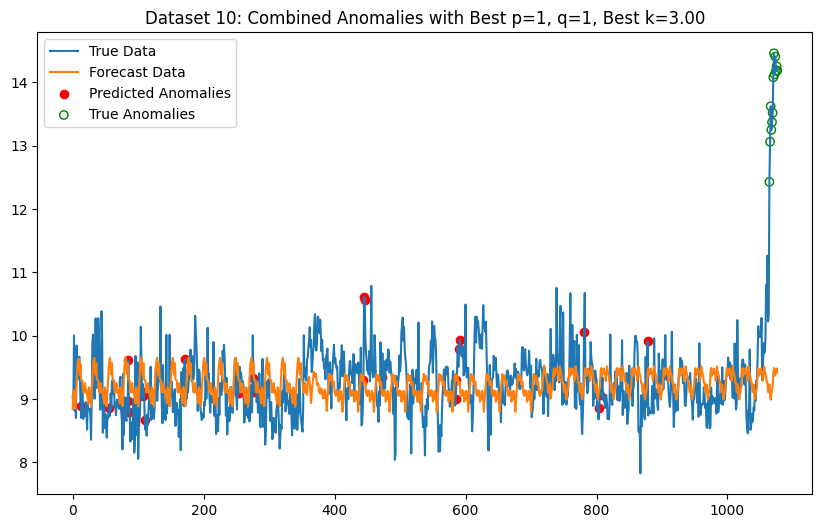

Dataset 10: Best p=1, q=1, Best k=3.00, Best Window=200, Precision=0.54, Recall=1.00, F1=0.74


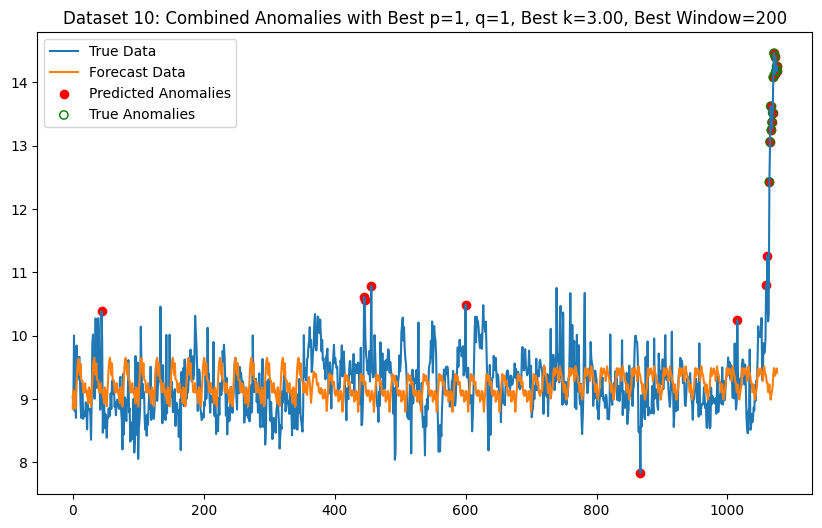

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 13: Best p=1, q=2, Best k=3.00, Precision=1.00, Recall=0.78, F1=0.88


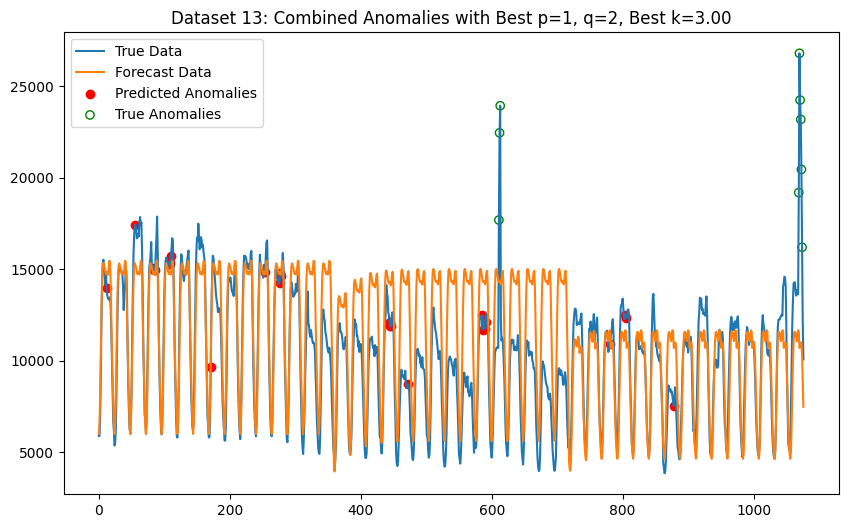

Dataset 13: Best p=1, q=2, Best k=3.00, Best Window=200, Precision=0.18, Recall=0.78, F1=0.39


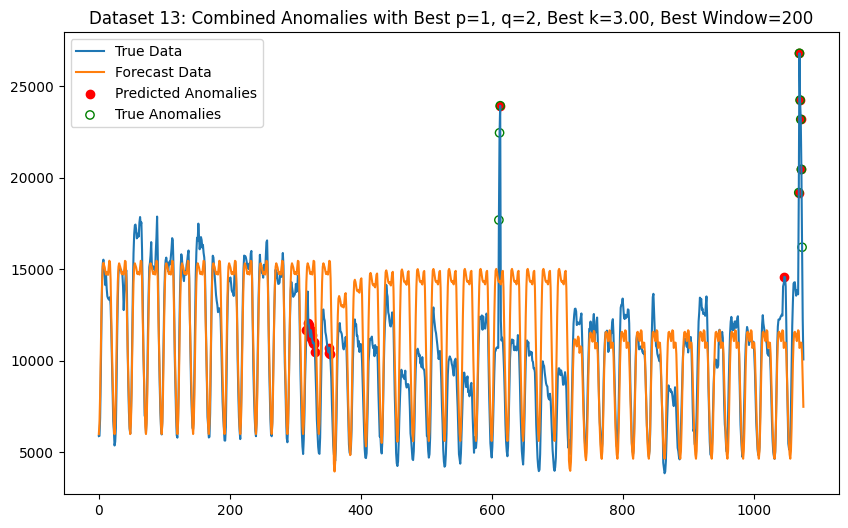

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 23: Best p=1, q=2, Best k=3.00, Precision=0.47, Recall=1.00, F1=0.64


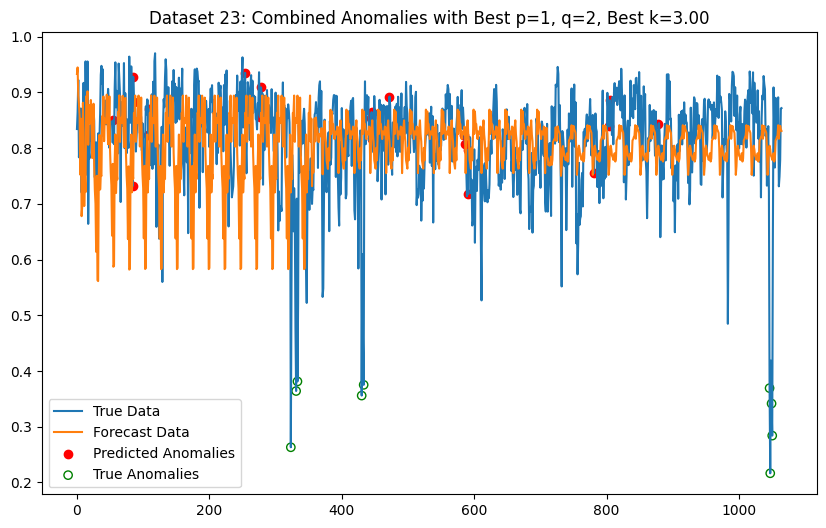

Dataset 23: Best p=1, q=2, Best k=3.00, Best Window=200, Precision=0.56, Recall=1.00, F1=0.72


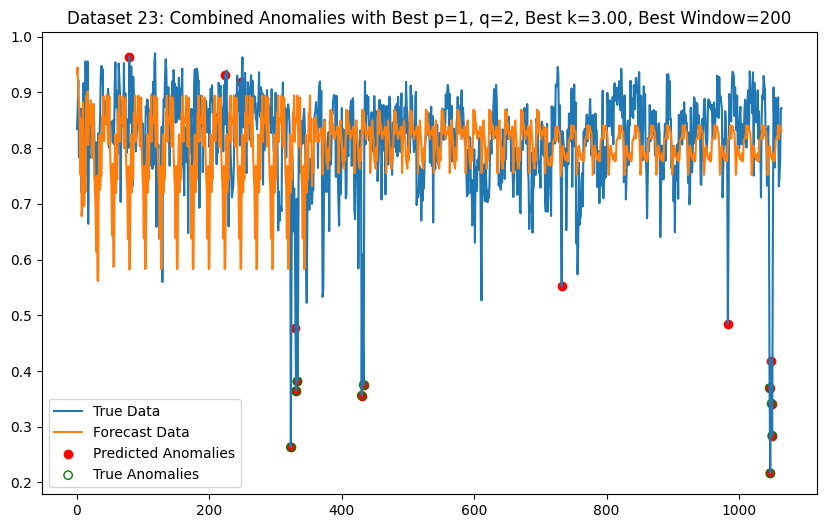

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 24: Best p=2, q=2, Best k=2.50, Precision=0.94, Recall=1.00, F1=0.97


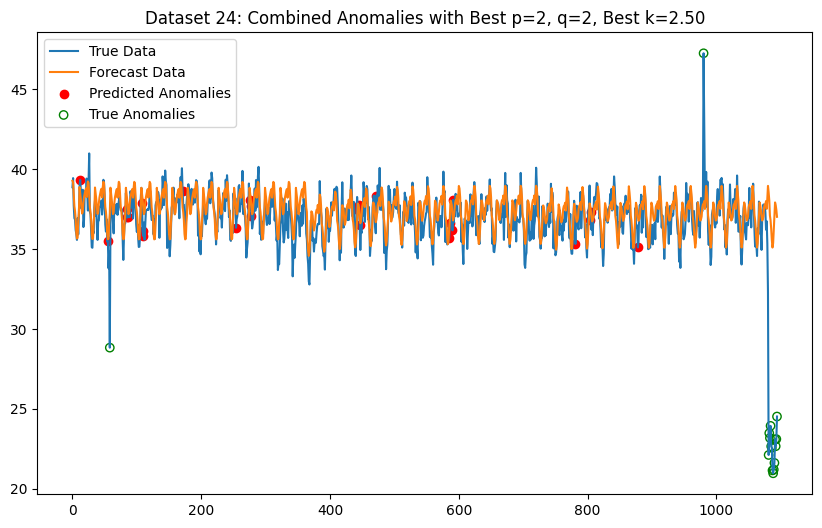

Dataset 24: Best p=2, q=2, Best k=3.00, Best Window=500, Precision=0.76, Recall=1.00, F1=0.86


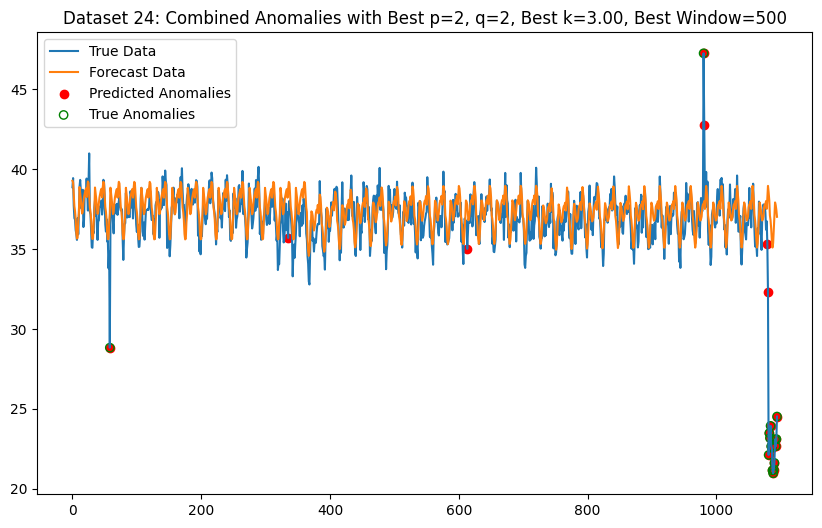

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 27: Best p=1, q=1, Best k=3.00, Precision=0.22, Recall=1.00, F1=0.36


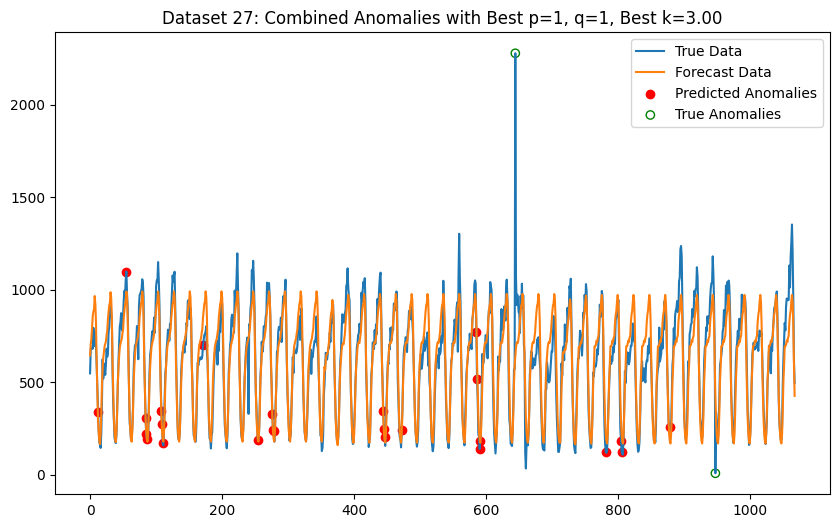

Dataset 27: Best p=1, q=1, Best k=3.00, Best Window=500, Precision=0.22, Recall=1.00, F1=0.36


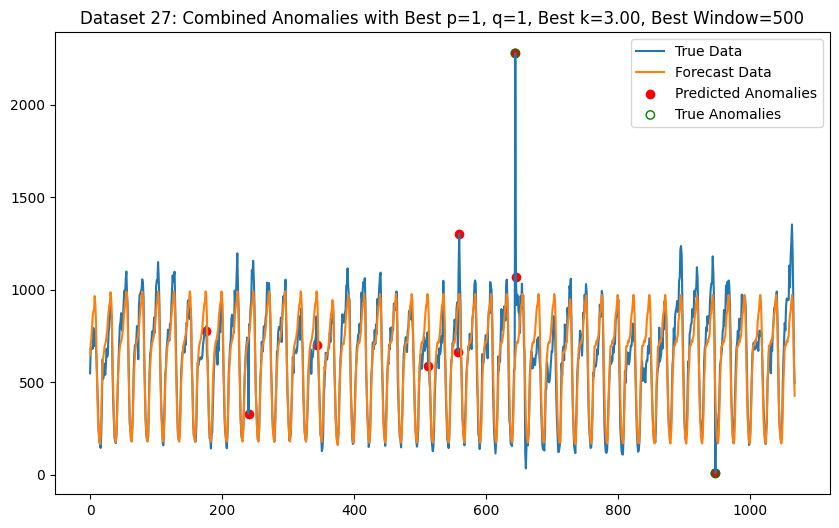

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 34: Best p=1, q=2, Best k=3.00, Precision=0.60, Recall=0.86, F1=0.71


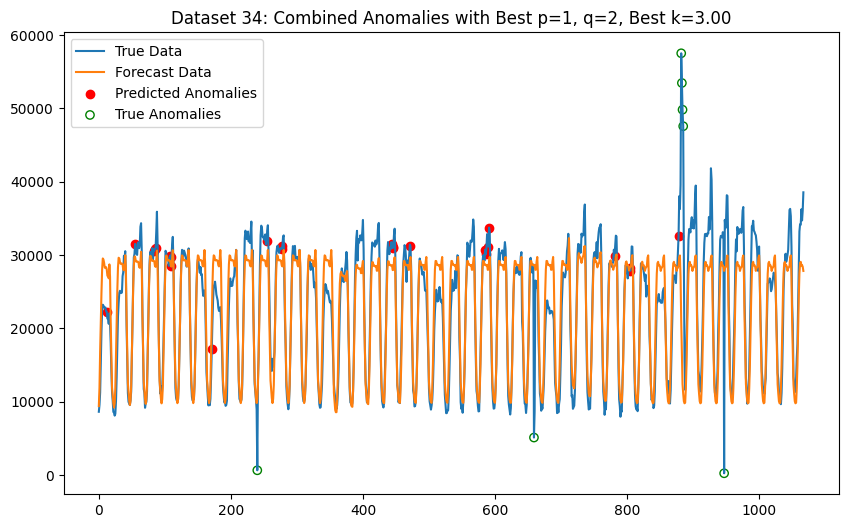

Dataset 34: Best p=1, q=2, Best k=3.00, Best Window=500, Precision=0.70, Recall=1.00, F1=0.82


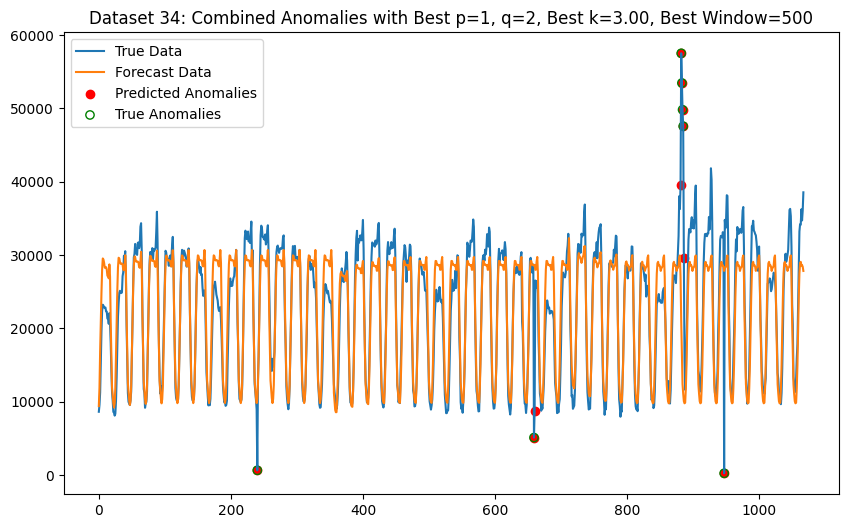

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 41: Best p=2, q=2, Best k=3.00, Precision=0.17, Recall=1.00, F1=0.29


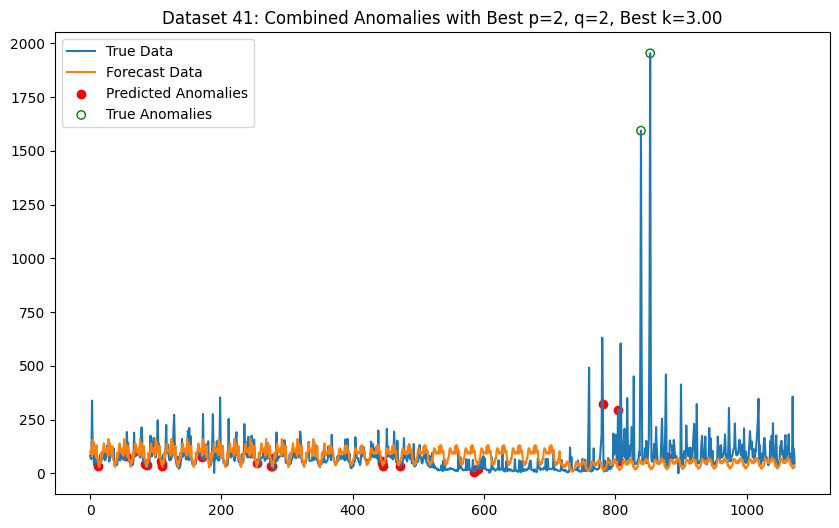

Dataset 41: Best p=2, q=2, Best k=3.00, Best Window=500, Precision=0.12, Recall=1.00, F1=0.21


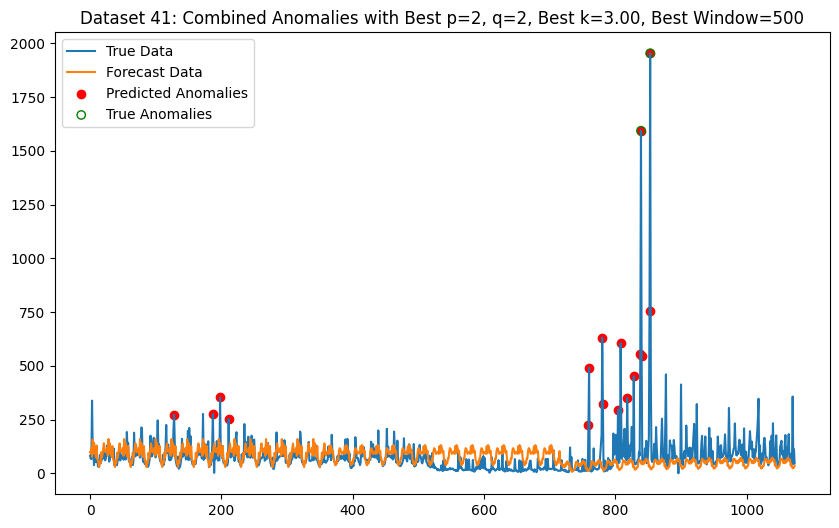

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 66: Best p=1, q=2, Best k=3.00, Precision=0.90, Recall=0.90, F1=0.90


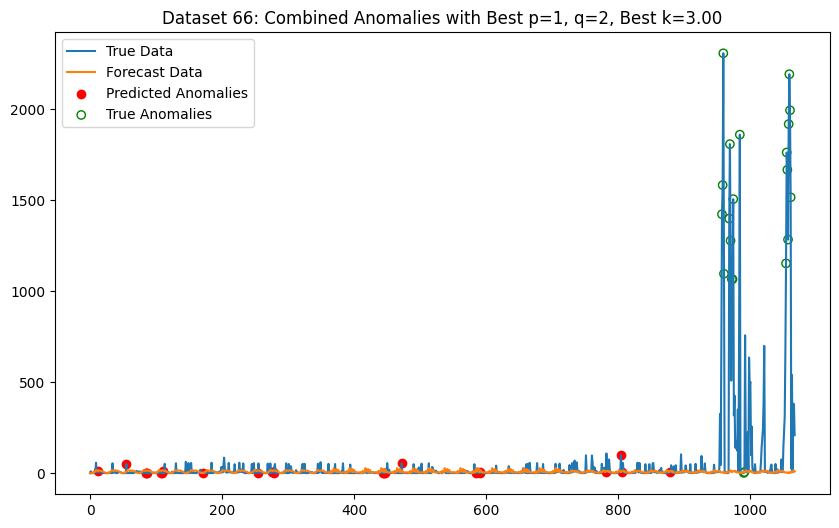

Dataset 66: Best p=1, q=2, Best k=3.00, Best Window=300, Precision=0.32, Recall=0.90, F1=0.47


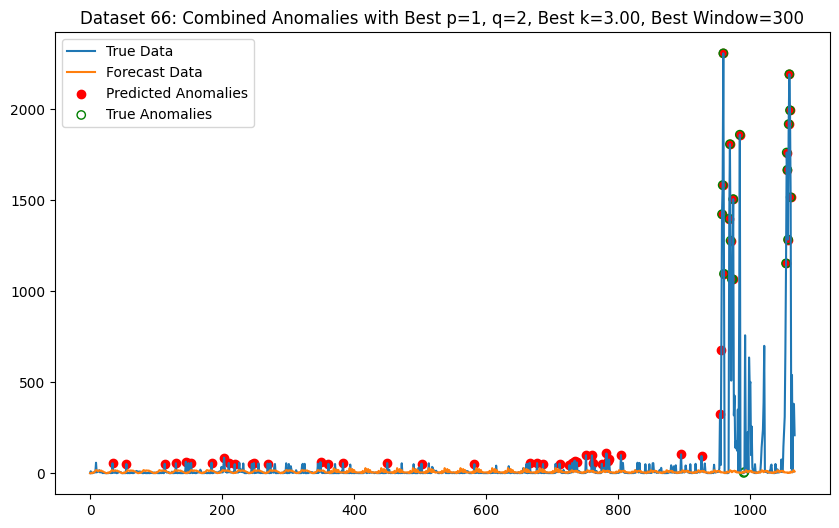


Average Metrics Across All Datasets:
Average Precision=0.69
Average Recall=0.87
Average F1-Score=0.71
All F1 Scores for each dataset: 0.1481, 0.8571, 0.9655, 0.8696, 0.7059, 1.0000, 0.8750, 0.6429, 0.9697, 0.3636, 0.7059, 0.2857, 0.9048

Average Metrics Across All Datasets:
Average Precision=0.38
Average Recall=0.92
Average F1-Score=0.53
All F1 Scores for each dataset: 0.2857, 0.3158, 0.7692, 0.5405, 0.4444, 0.7429, 0.3871, 0.7200, 0.8649, 0.3636, 0.8235, 0.2105, 0.4691


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets
A1A = [1,2,3,8,9,10,13,23,24,27,34,41,66]

# Storage for metrics
all_precisions_sw = []
all_recalls_sw = []
all_f1_scores_sw = []
all_precisions_dw = []
all_recalls_dw = []
all_f1_scores_dw = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=3)

# Parameters for SARIMAX and thresholds
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1A:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Find the best SARIMAX model for this split
        best_p, best_q = None, None
        best_mae = float('inf')
        best_model_fit = None
        forecast = None

        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the training data
                    model = SARIMAX(y_train,
                                    order=(p, d, q),
                                    seasonal_order=(P, D, Q, m),
                                    enforce_stationarity=False,
                                    enforce_invertibility=False)
                    model_fit = model.fit(disp=False)

                    # Forecast on the test data
                    forecast_temp = model_fit.get_forecast(steps=len(y_test)).predicted_mean

                    # Calculate MAE
                    mae = np.mean(np.abs(y_test - forecast_temp))

                    if mae < best_mae:
                        best_mae = mae
                        best_p, best_q = p, q
                        best_model_fit = model_fit
                        forecast = forecast_temp

                except Exception as e:
                    print(f"Error with SARIMAX(p={p}, q={q}): {e}")

        # Calculate residuals for the best SARIMAX model
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

###
# stat win
###

    # Find the optimal k using combined residuals for a static threshold
    best_k_sw = None
    best_f1_sw = -1
    best_combined_predicted_anomalies_sw = None

    # Calculate static mean and std of residuals
    mean_residuals = np.mean(combined_residuals)
    std_residuals = np.std(combined_residuals)

    for k in k_values:
        # Static threshold
        threshold = mean_residuals + k * std_residuals
        predicted_anomalies_sw = (np.array(combined_residuals) > threshold).astype(int)

        # Compute F1 score for the current k
        precision = precision_score(combined_true_anomalies, predicted_anomalies_sw)
        recall = recall_score(combined_true_anomalies, predicted_anomalies_sw)
        f1 = f1_score(combined_true_anomalies, predicted_anomalies_sw)

        # Check if this k is the best so far
        if f1 > best_f1_sw:
            best_f1_sw = f1
            best_k_sw = k
            best_combined_predicted_anomalies_sw = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions_sw.append(precision)
    all_recalls_sw.append(recall)
    all_f1_scores_sw.append(best_f1_sw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_sw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_sw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}")
    plt.show()

###
# dyn win
###

# Find the optimal combination of window size and k using combined residuals
    best_window = None
    best_k_dw = None
    best_f1_dw = -1
    best_combined_predicted_anomalies_dw = None

    for window_size in window_sizes:
        for k in k_values:
            # Calculate rolling statistics for dynamic threshold
            rolling_residuals = pd.Series(combined_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            # Determine anomalies using dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies_dw = (pd.Series(combined_residuals) > threshold).astype(int)

            # Compute F1 score for the current window size and k
            precision = precision_score(combined_true_anomalies, predicted_anomalies_dw)
            recall = recall_score(combined_true_anomalies, predicted_anomalies_dw)
            f1 = f1_score(combined_true_anomalies, predicted_anomalies_dw)

            # Check if this combination of window size and k is the best so far
            if f1 > best_f1_dw:
                best_f1_dw = f1
                best_k_dw = k
                best_window = window_size
                best_combined_predicted_anomalies_dw = predicted_anomalies_dw

    # Store the best metrics for this dataset
    all_precisions_dw.append(precision)
    all_recalls_dw.append(recall)
    all_f1_scores_dw.append(best_f1_dw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_dw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_dw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}")
    plt.show()

###
# avg metrics
###

# Calculate and display average metrics
average_precision_sw = np.mean(all_precisions_sw)
average_recall_sw = np.mean(all_recalls_sw)
average_f1_score_sw = np.mean(all_f1_scores_sw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_sw:.2f}")
print(f"Average Recall={average_recall_sw:.2f}")
print(f"Average F1-Score={average_f1_score_sw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_sw = [f"{score:.4f}" for score in all_f1_scores_sw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_sw)}")

# Calculate and display average metrics
average_precision_dw = np.mean(all_precisions_dw)
average_recall_dw = np.mean(all_recalls_dw)
average_f1_score_dw = np.mean(all_f1_scores_dw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_dw:.2f}")
print(f"Average Recall={average_recall_dw:.2f}")
print(f"Average F1-Score={average_f1_score_dw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_dw = [f"{score:.4f}" for score in all_f1_scores_dw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_dw)}")

## A1B

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 7: Best p=2, q=1, Best k=2.00, Precision=0.58, Recall=0.39, F1=0.53


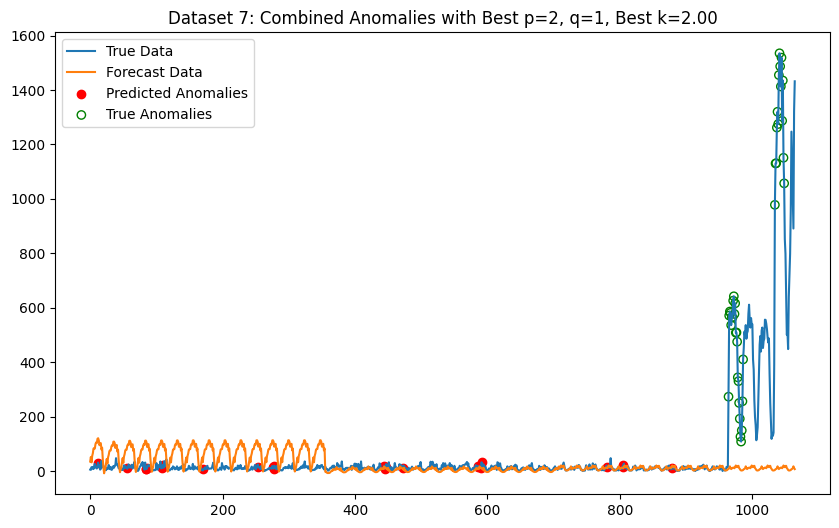

Dataset 7: Best p=2, q=1, Best k=3.00, Best Window=200, Precision=0.52, Recall=0.84, F1=0.78


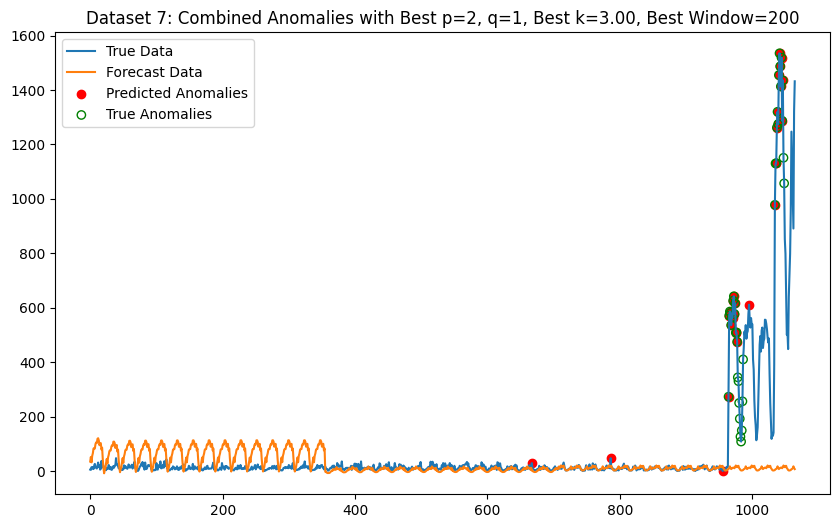

Dataset 20: Best p=1, q=2, Best k=2.50, Precision=0.23, Recall=0.15, F1=0.19


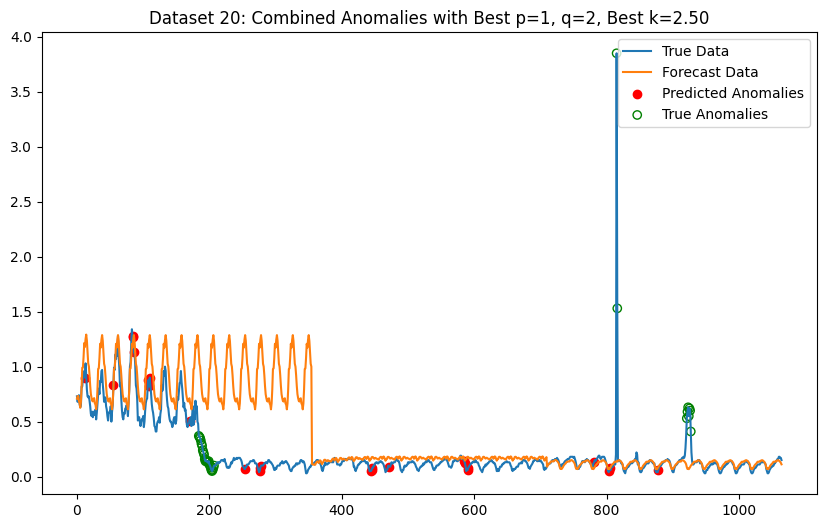

Dataset 20: Best p=1, q=2, Best k=2.50, Best Window=100, Precision=0.61, Recall=0.33, F1=0.59


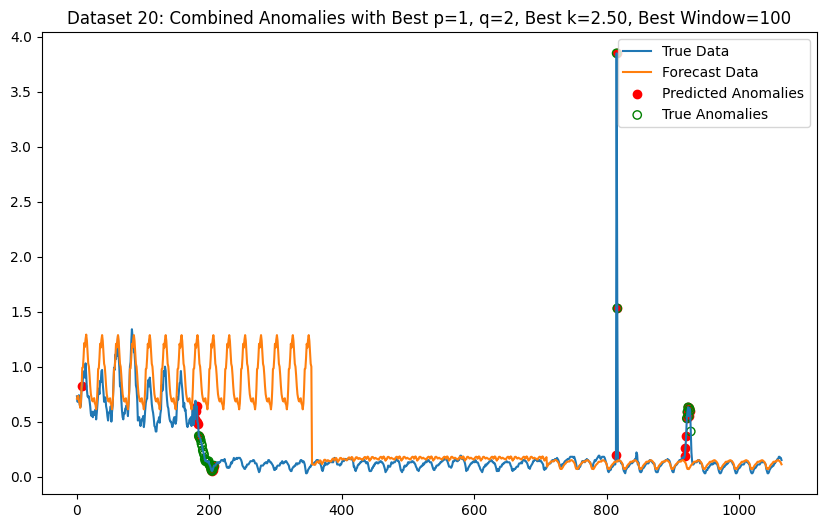

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 31: Best p=2, q=2, Best k=2.50, Precision=1.00, Recall=0.12, F1=0.61


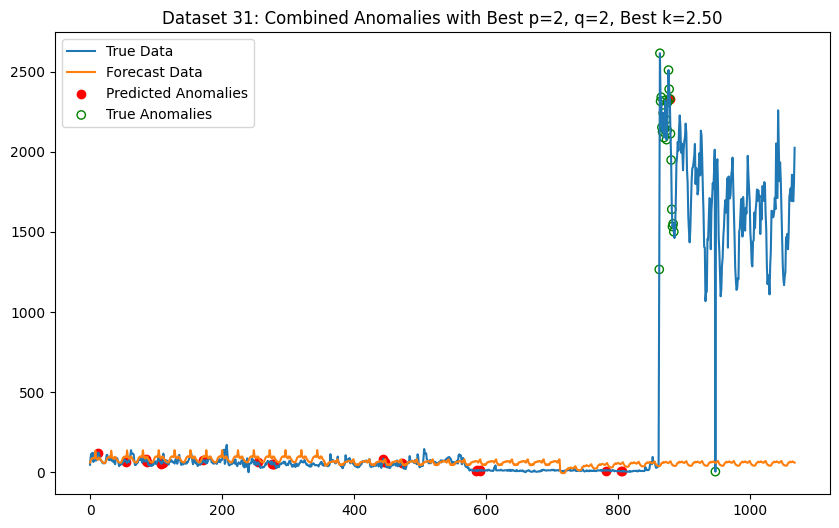

Dataset 31: Best p=2, q=2, Best k=3.00, Best Window=300, Precision=0.44, Recall=0.96, F1=0.68


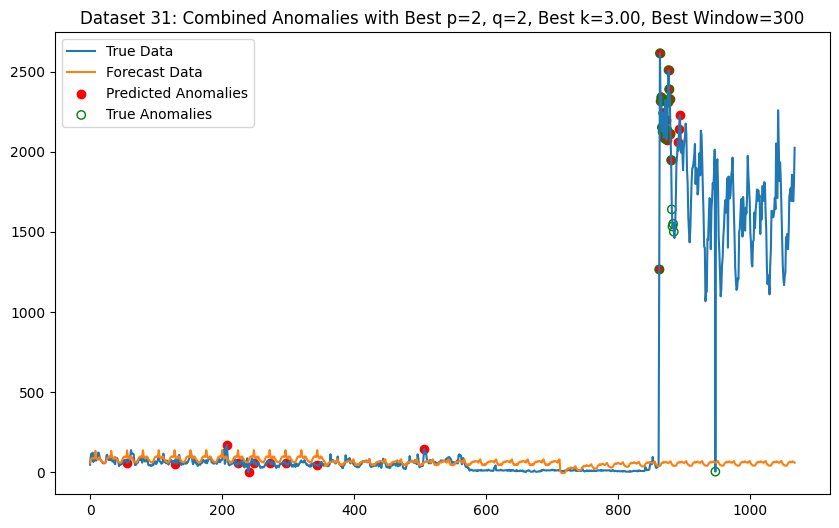

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood op

Dataset 32: Best p=2, q=1, Best k=2.00, Precision=0.00, Recall=0.00, F1=0.42


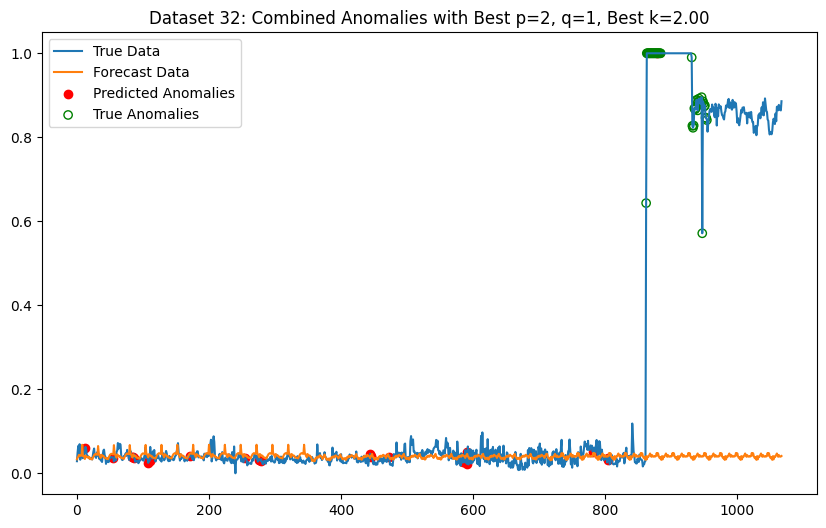

Dataset 32: Best p=2, q=1, Best k=3.00, Best Window=300, Precision=0.32, Recall=0.49, F1=0.48


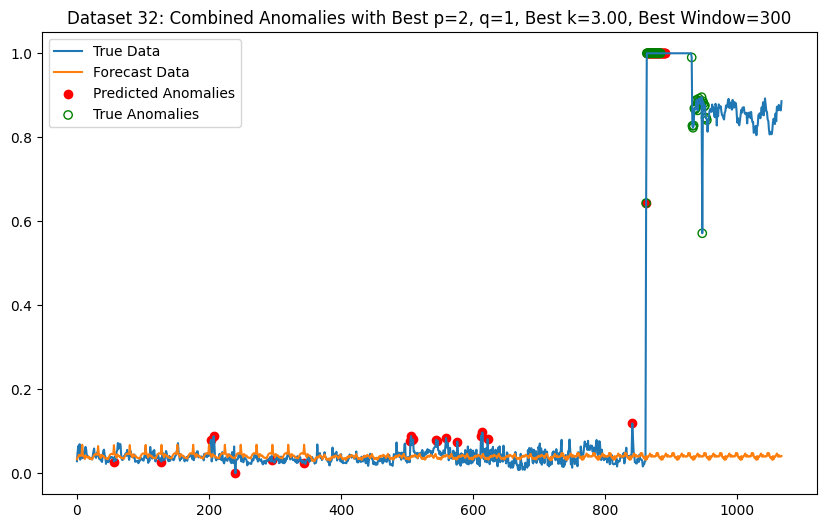

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 48: Best p=1, q=2, Best k=1.50, Precision=0.07, Recall=0.05, F1=0.10


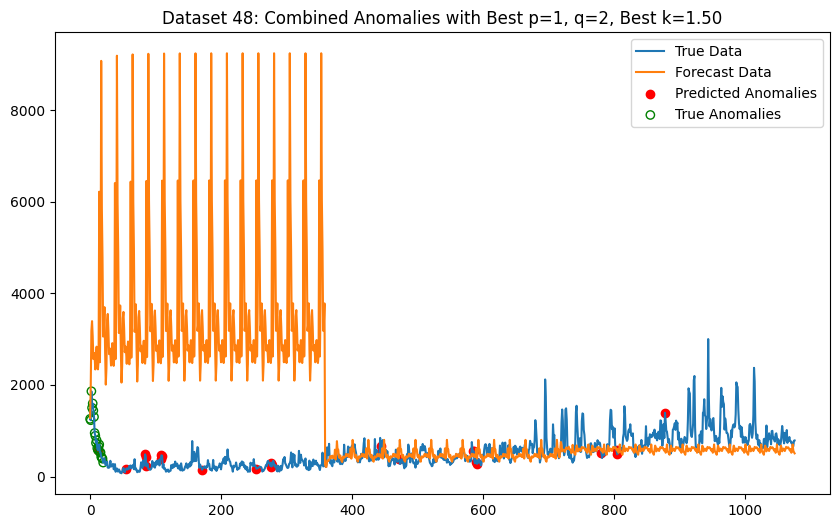

Dataset 48: Best p=1, q=2, Best k=3.00, Best Window=100, Precision=0.06, Recall=0.10, F1=0.08


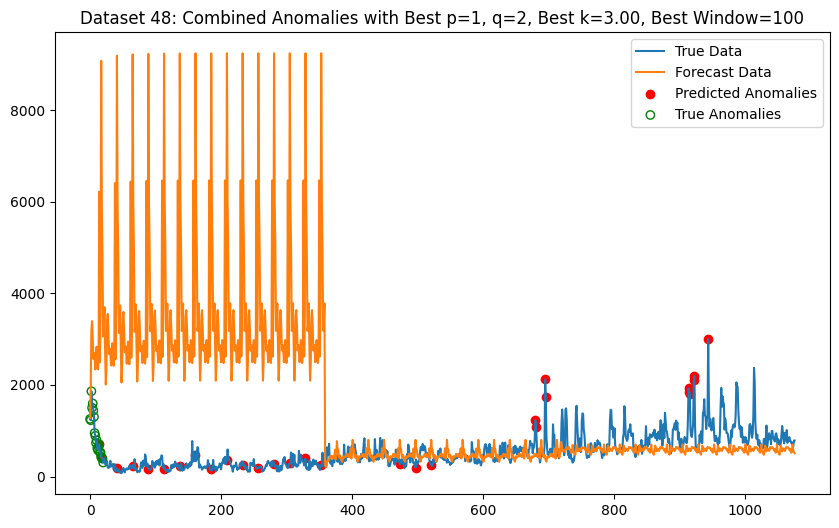

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 57: Best p=2, q=2, Best k=2.50, Precision=0.00, Recall=0.00, F1=0.03


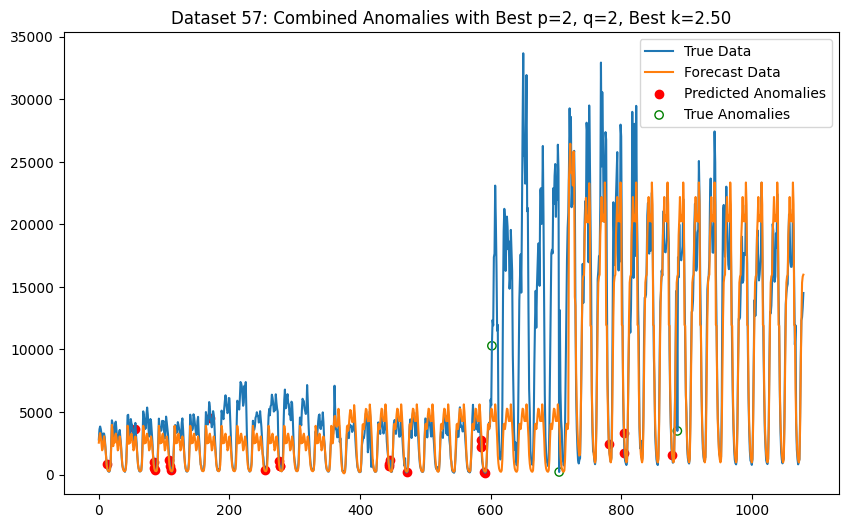

Dataset 57: Best p=2, q=2, Best k=3.00, Best Window=100, Precision=0.01, Recall=0.33, F1=0.17


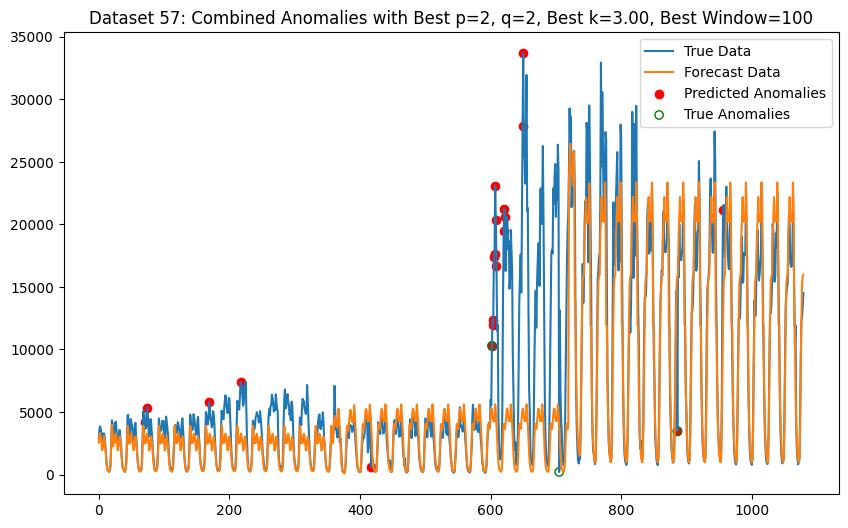

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 61: Best p=2, q=2, Best k=1.50, Precision=0.07, Recall=0.04, F1=0.05


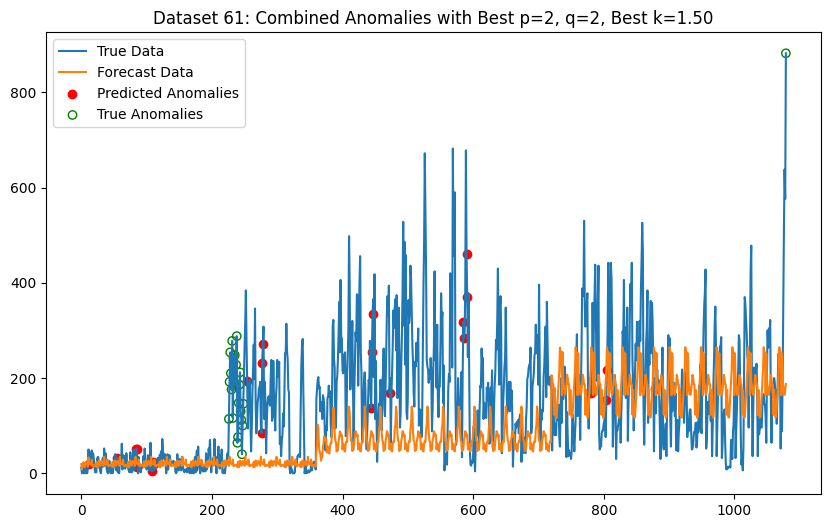

Dataset 61: Best p=2, q=2, Best k=3.00, Best Window=200, Precision=0.31, Recall=0.62, F1=0.46


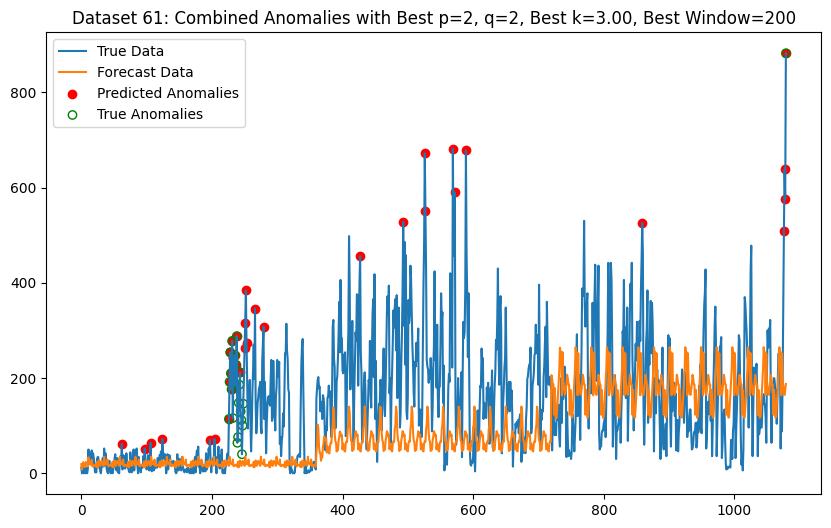


Average Metrics Across All Datasets:
Average Precision=0.28
Average Recall=0.11
Average F1-Score=0.28
All F1 Scores for each dataset: 0.5319, 0.1928, 0.6071, 0.4202, 0.0988, 0.0345, 0.0541

Average Metrics Across All Datasets:
Average Precision=nan
Average Recall=nan
Average F1-Score=nan
All F1 Scores for each dataset: 


/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets
A1B = [7, 20, 31, 32, 48, 57, 61]

# Storage for metrics
all_precisions_sw = []
all_recalls_sw = []
all_f1_scores_sw = []
all_precisions_dw = []
all_recalls_dw = []
all_f1_scores_dw = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=3)

# Parameters for SARIMAX and thresholds
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1B:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Find the best SARIMAX model for this split
        best_p, best_q = None, None
        best_mae = float('inf')
        best_model_fit = None
        forecast = None

        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the training data
                    model = SARIMAX(y_train,
                                    order=(p, d, q),
                                    seasonal_order=(P, D, Q, m),
                                    enforce_stationarity=False,
                                    enforce_invertibility=False)
                    model_fit = model.fit(disp=False)

                    # Forecast on the test data
                    forecast_temp = model_fit.get_forecast(steps=len(y_test)).predicted_mean

                    # Calculate MAE
                    mae = np.mean(np.abs(y_test - forecast_temp))

                    if mae < best_mae:
                        best_mae = mae
                        best_p, best_q = p, q
                        best_model_fit = model_fit
                        forecast = forecast_temp

                except Exception as e:
                    print(f"Error with SARIMAX(p={p}, q={q}): {e}")

        # Calculate residuals for the best SARIMAX model
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

###
# stat win
###

    # Find the optimal k using combined residuals for a static threshold
    best_k_sw = None
    best_f1_sw = -1
    best_combined_predicted_anomalies_sw = None

    # Calculate static mean and std of residuals
    mean_residuals = np.mean(combined_residuals)
    std_residuals = np.std(combined_residuals)

    for k in k_values:
        # Static threshold
        threshold = mean_residuals + k * std_residuals
        predicted_anomalies_sw = (np.array(combined_residuals) > threshold).astype(int)

        # Compute F1 score for the current k
        precision = precision_score(combined_true_anomalies, predicted_anomalies_sw)
        recall = recall_score(combined_true_anomalies, predicted_anomalies_sw)
        f1 = f1_score(combined_true_anomalies, predicted_anomalies_sw)

        # Check if this k is the best so far
        if f1 > best_f1_sw:
            best_f1_sw = f1
            best_k_sw = k
            best_combined_predicted_anomalies_sw = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions_sw.append(precision)
    all_recalls_sw.append(recall)
    all_f1_scores_sw.append(best_f1_sw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_sw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_sw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}")
    plt.show()

###
# dyn win
###

# Find the optimal combination of window size and k using combined residuals
    best_window = None
    best_k_dw = None
    best_f1_dw = -1
    best_combined_predicted_anomalies_dw = None

    for window_size in window_sizes:
        for k in k_values:
            # Calculate rolling statistics for dynamic threshold
            rolling_residuals = pd.Series(combined_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            # Determine anomalies using dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies_dw = (pd.Series(combined_residuals) > threshold).astype(int)

            # Compute F1 score for the current window size and k
            precision = precision_score(combined_true_anomalies, predicted_anomalies_dw)
            recall = recall_score(combined_true_anomalies, predicted_anomalies_dw)
            f1 = f1_score(combined_true_anomalies, predicted_anomalies_dw)

            # Check if this combination of window size and k is the best so far
            if f1 > best_f1_dw:
                best_f1_dw = f1
                best_k_dw = k
                best_window = window_size
                best_combined_predicted_anomalies_dw = predicted_anomalies_dw

    # Store the best metrics for this dataset
    all_precisions_dw.append(precision)
    all_recalls_dw.append(recall)
    all_f1_scores_dw.append(best_f1_dw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_dw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_dw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}")
    plt.show()

###
# avg metrics
###

# Calculate and display average metrics
average_precision_sw = np.mean(all_precisions_sw)
average_recall_sw = np.mean(all_recalls_sw)
average_f1_score_sw = np.mean(all_f1_scores_sw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_sw:.2f}")
print(f"Average Recall={average_recall_sw:.2f}")
print(f"Average F1-Score={average_f1_score_sw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_sw = [f"{score:.4f}" for score in all_f1_scores_sw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_sw)}")

# Calculate and display average metrics
average_precision_dw = np.mean(all_precisions_dw)
average_recall_dw = np.mean(all_recalls_dw)
average_f1_score_dw = np.mean(all_f1_scores_dw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_dw:.2f}")
print(f"Average Recall={average_recall_dw:.2f}")
print(f"Average F1-Score={average_f1_score_dw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_dw = [f"{score:.4f}" for score in all_f1_scores_dw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_dw)}")

## A1C

## static

Dataset 17: Best p=1, q=1, k=1.5, MAE=1603.10, Precision=1.00, Recall=0.09, F1=0.71


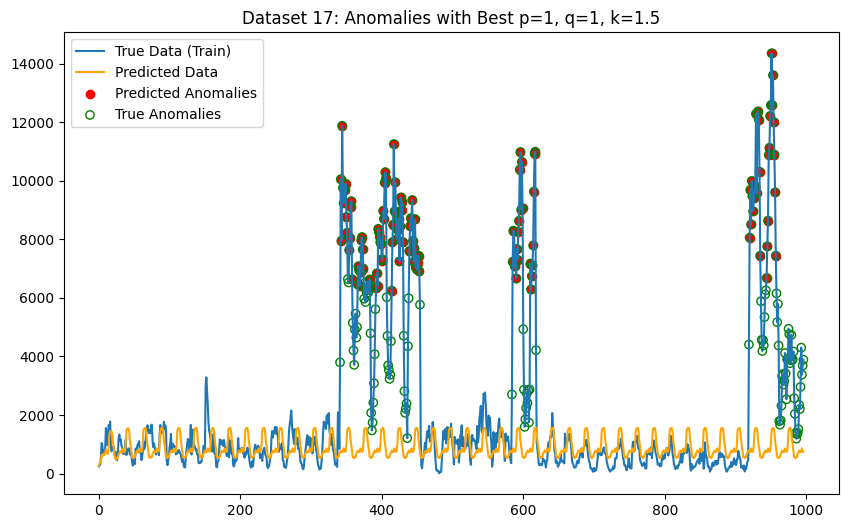

Dataset 19: Best p=2, q=1, k=1.5, MAE=47.50, Precision=1.00, Recall=0.10, F1=0.62


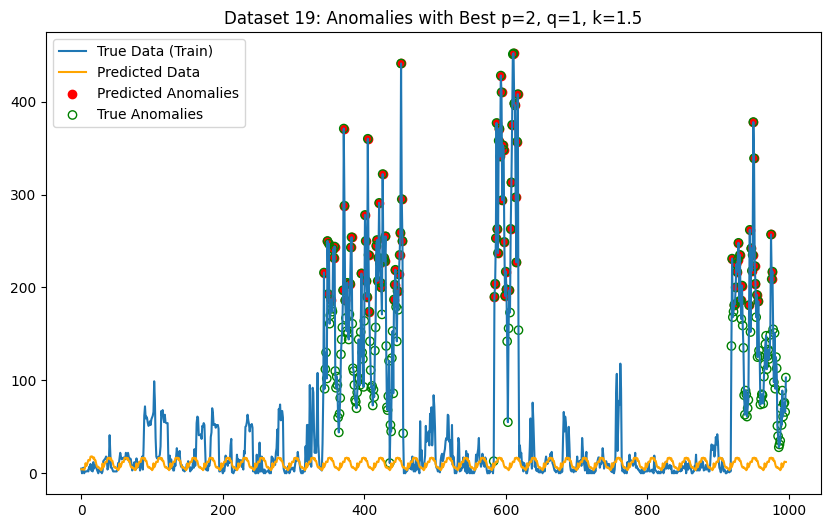

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 26: Best p=2, q=1, k=2, MAE=100.57, Precision=0.30, Recall=0.08, F1=0.43


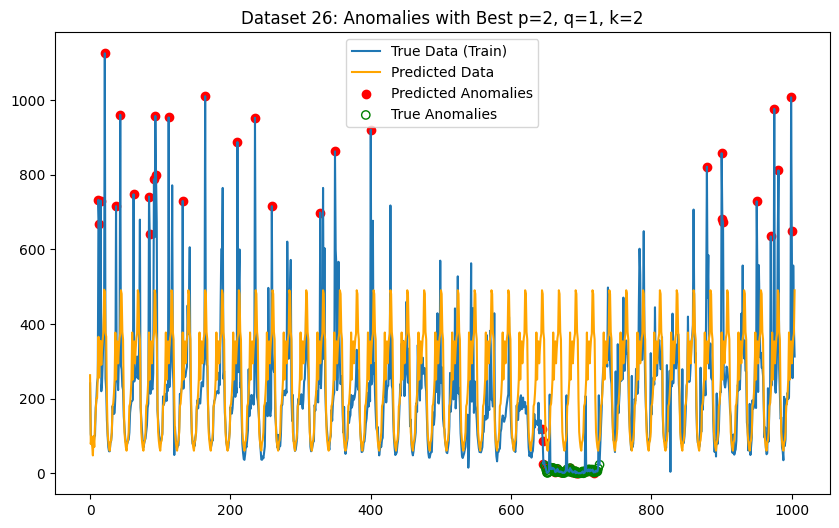

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 37: Best p=1, q=1, k=2.5, MAE=53.91, Precision=0.64, Recall=0.47, F1=0.57


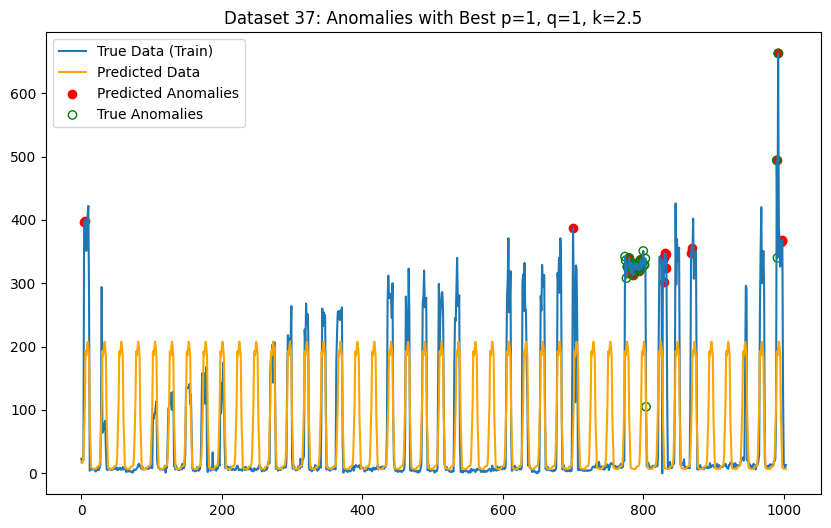

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 40: Best p=2, q=2, k=1.5, MAE=132.79, Precision=0.31, Recall=0.05, F1=0.60


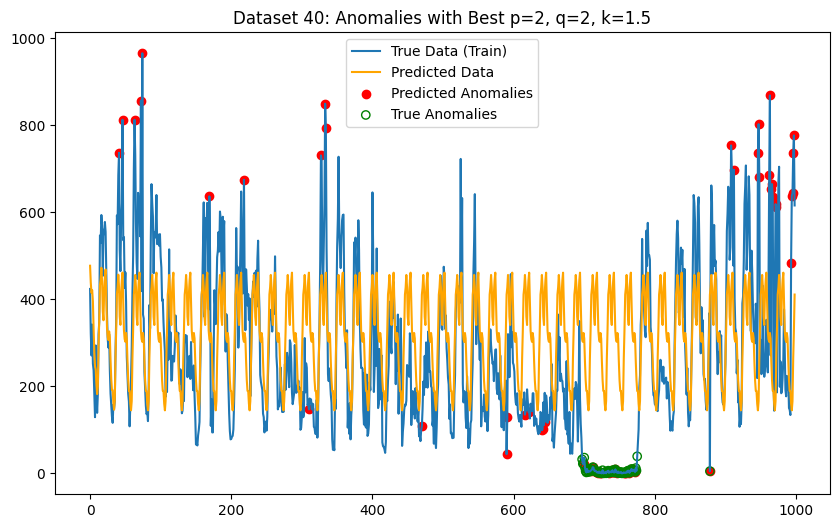

Dataset 47: Best p=2, q=1, k=3, MAE=1732.36, Precision=0.71, Recall=0.50, F1=0.59


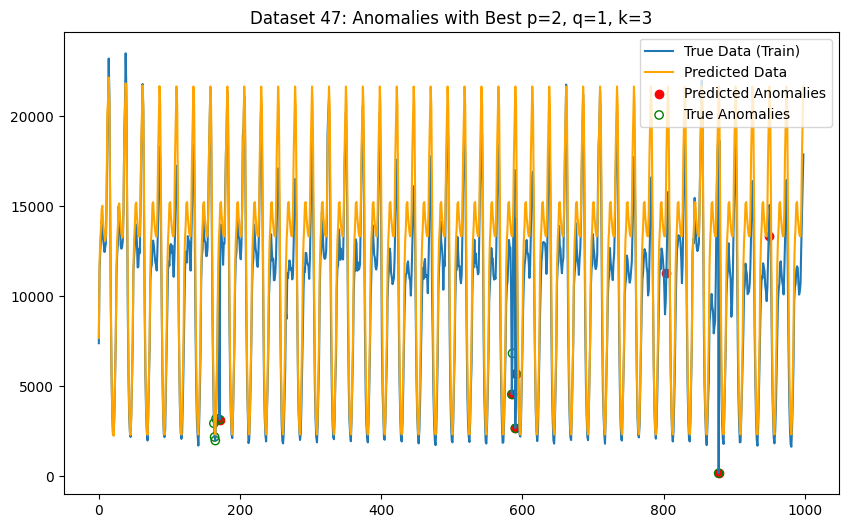


Average Metrics Across All Datasets:
Average MAE=611.70
Average Precision=0.66
Average Recall=0.22
Average F1-Score=0.59
All F1 Scores for each dataset: 0.7102, 0.6242, 0.4317, 0.5672, 0.5988, 0.5882


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets to process
A1C = [17, 19, 26, 37, 40, 47]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# Storage for average MAE values
all_mae_scores = []

# Parameters to iterate over
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
possible_ks = [1.5, 2, 2.5, 3]

for i in A1C:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    # Split data into 30% fit and 70% train
    split_index = int(len(data) * 0.3)
    fit_data = data[:split_index]
    train_data = data[split_index:]
    train_labels = labels[split_index:]

    best_p = None
    best_q = None
    best_k = None
    best_mae = float('inf')
    best_model = None
    best_residuals = None
    best_f1 = -1
    best_predicted_anomalies = None

    # Iterate over different values of p and q
    for p in p_values:
        for q in q_values:
            try:
                # Fit SARIMAX model on the fit_data
                sarimax_model = SARIMAX(fit_data,
                                        order=(p, d, q),
                                        seasonal_order=(P, D, Q, m),
                                        enforce_stationarity=False,
                                        enforce_invertibility=False)
                model_fit = sarimax_model.fit(disp=False)

                # Forecast on train_data
                forecast = model_fit.get_forecast(steps=len(train_data))
                forecasted_values = forecast.predicted_mean

                # Calculate MAE on the forecast
                mae = mean_absolute_error(train_data, forecasted_values)

                # Check for the best MAE
                if mae < best_mae:
                    best_mae = mae
                    best_p = p
                    best_q = q
                    best_model = model_fit
                    best_residuals = np.abs(train_data - forecasted_values)

            except Exception as e:
                print(f"Error with p={p}, q={q} for dataset {i}: {e}")

    # Iterate over different values of k to find the optimal threshold multiplier
    for k in possible_ks:
        residuals = best_residuals
        mean_resid = np.mean(residuals)
        std_resid = np.std(residuals)
        threshold = mean_resid + k * std_resid
        predicted_anomalies = (residuals > threshold).astype(int)

        # Compute metrics
        precision = precision_score(train_labels, predicted_anomalies)
        recall = recall_score(train_labels, predicted_anomalies)
        f1 = f1_score(train_labels, predicted_anomalies)

        # Check if this k is the best so far
        if f1 > best_f1:
            best_f1 = f1
            best_k = k
            best_predicted_anomalies = predicted_anomalies

    # Store metrics
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)
    all_mae_scores.append(best_mae)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, k={best_k}, MAE={best_mae:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(train_data, label='True Data (Train)')
    plt.plot(forecasted_values, label='Predicted Data', color='orange')
    anomaly_indices = np.where(best_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, train_data[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(train_labels == 1)[0], train_data[train_labels == 1], color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best p={best_p}, q={best_q}, k={best_k}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)
average_mae = np.mean(all_mae_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average MAE={average_mae:.2f}")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

## dynamic

Dataset 17: Best p=1, q=1, Best k=1.50, Best Window=500, MAE=1603.10, Precision=0.93, Recall=0.23, F1=0.69


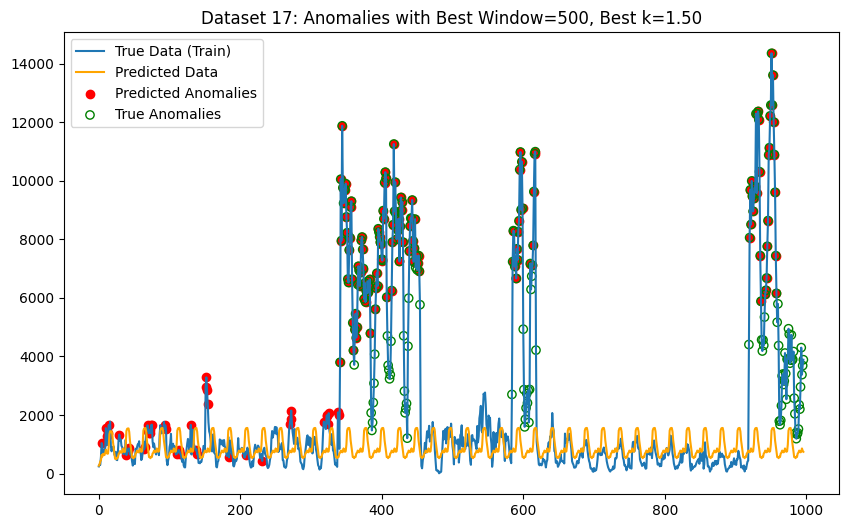

Dataset 19: Best p=2, q=1, Best k=1.50, Best Window=500, MAE=47.50, Precision=0.76, Recall=0.23, F1=0.63


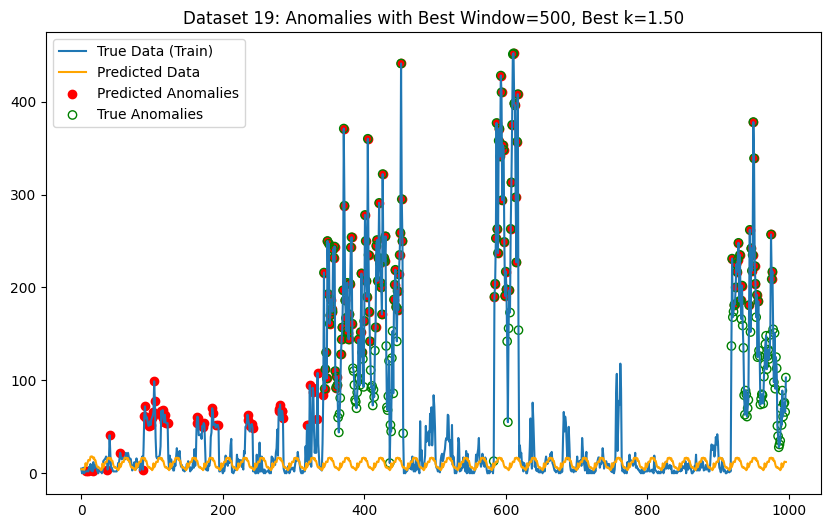

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 26: Best p=2, q=1, Best k=1.50, Best Window=500, MAE=100.57, Precision=0.29, Recall=0.08, F1=0.43


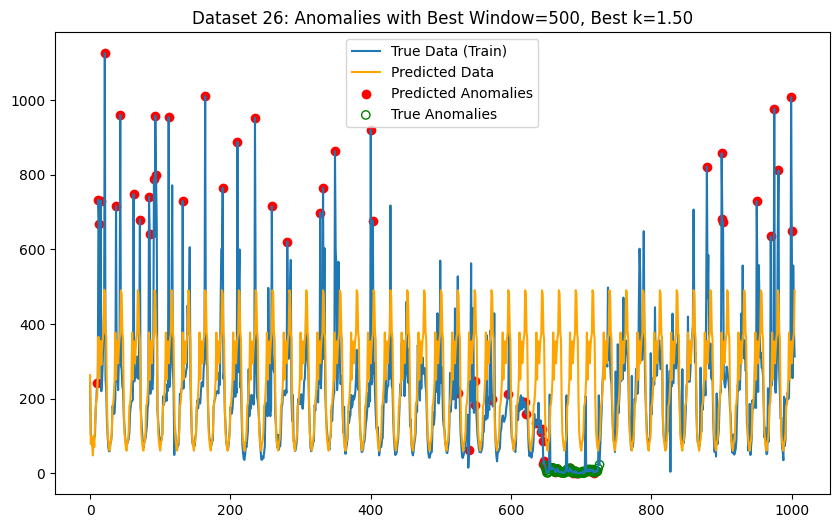

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 37: Best p=1, q=1, Best k=3.00, Best Window=500, MAE=53.91, Precision=0.65, Recall=0.50, F1=0.57


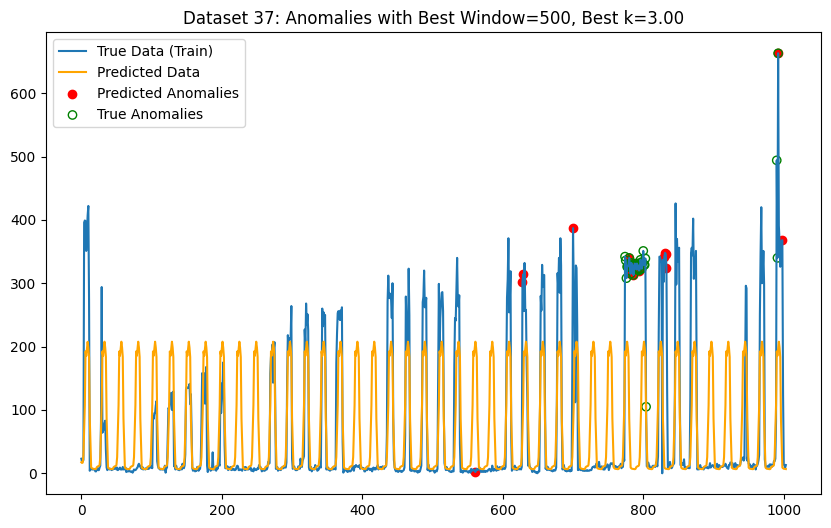

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 40: Best p=2, q=2, Best k=1.50, Best Window=500, MAE=132.79, Precision=0.52, Recall=0.15, F1=0.49


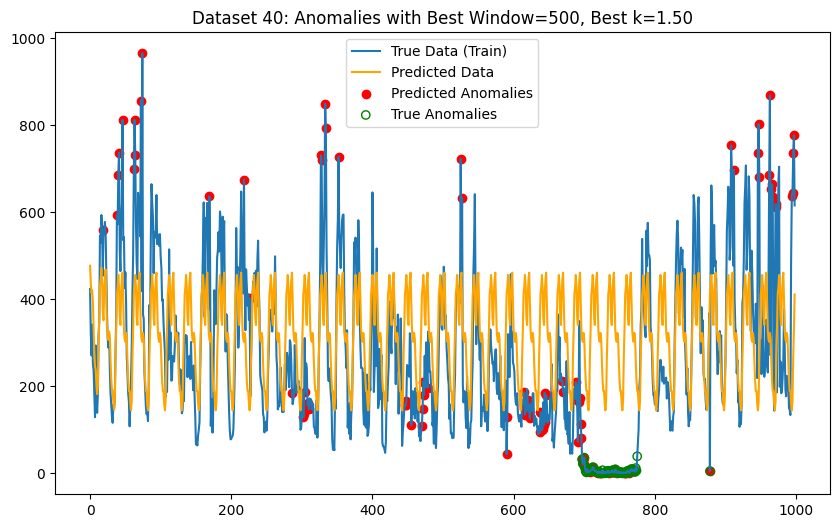

Dataset 47: Best p=2, q=1, Best k=3.00, Best Window=200, MAE=1732.36, Precision=0.24, Recall=0.60, F1=0.39


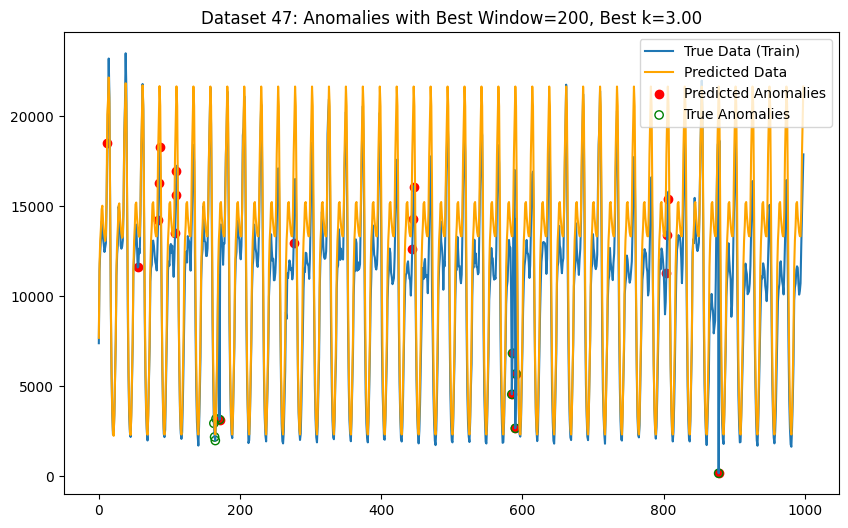


Average Metrics Across All Datasets:
Average MAE=611.70
Average Precision=0.56
Average Recall=0.30
Average F1-Score=0.53
All F1 Scores for each dataset: 0.6938, 0.6259, 0.4321, 0.5667, 0.4906, 0.3871


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets to process
A1C = [17, 19, 26, 37, 40, 47]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# Storage for average MAE values
all_mae_scores = []

# Parameters to iterate over
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
window_sizes = [100, 200, 300 , 500]  # Rolling window sizes to test
k_values = [1.5, 2, 2.5, 3]  # Threshold multipliers to test

for i in A1C:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    # Split data into 30% fit and 70% train
    split_index = int(len(data) * 0.3)
    fit_data = data[:split_index]
    train_data = data[split_index:]
    train_labels = labels[split_index:]

    best_p = None
    best_q = None
    best_k = None
    best_window = None
    best_mae = float('inf')
    best_f1 = -1
    best_predicted_anomalies = None

    try:
        # Iterate over different values of p and q
        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the fit_data
                    sarimax_model = SARIMAX(fit_data,
                                            order=(p, d, q),
                                            seasonal_order=(P, D, Q, m),
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)
                    model_fit = sarimax_model.fit(disp=False)

                    # Forecast on train_data
                    forecast = model_fit.get_forecast(steps=len(train_data))
                    forecasted_values = forecast.predicted_mean

                    # Calculate MAE on the forecast
                    mae = mean_absolute_error(train_data, forecasted_values)

                    # Store the residuals
                    residuals = np.abs(train_data - forecasted_values)

                    if mae < best_mae:
                        best_mae = mae
                        best_p = p
                        best_q = q
                        best_residuals = residuals

                except Exception as e:
                    print(f"Error with p={p}, q={q} for dataset {i}: {e}")

        # Iterate over different window sizes and k values for dynamic threshold
        for window_size in window_sizes:
            rolling_residuals = pd.Series(best_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            for k in k_values:
                # Dynamic threshold
                threshold = mean_residuals + k * std_residuals
                predicted_anomalies = (best_residuals > threshold).astype(int)

                # Compute metrics
                precision = precision_score(train_labels, predicted_anomalies)
                recall = recall_score(train_labels, predicted_anomalies)
                f1 = f1_score(train_labels, predicted_anomalies)

                # Check if this combination of window size and k is the best so far
                if f1 > best_f1:
                    best_f1 = f1
                    best_k = k
                    best_window = window_size
                    best_predicted_anomalies = predicted_anomalies

    except Exception as e:
        print(f"Error processing dataset {i}: {e}")

    # Store metrics
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)
    all_mae_scores.append(best_mae)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k:.2f}, Best Window={best_window}, "
          f"MAE={best_mae:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(train_data, label='True Data (Train)')
    plt.plot(forecasted_values, label='Predicted Data', color='orange')
    anomaly_indices = np.where(best_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, train_data[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(train_labels == 1)[0], train_data[train_labels == 1], color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Anomalies with Best Window={best_window}, Best k={best_k:.2f}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)
average_mae = np.mean(all_mae_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average MAE={average_mae:.2f}")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores = [f"{score:.4f}" for score in all_f1_scores]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores)}")

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 17: Best p=2, q=2, Best k=1.50, Precision=1.00, Recall=0.11, F1=0.73


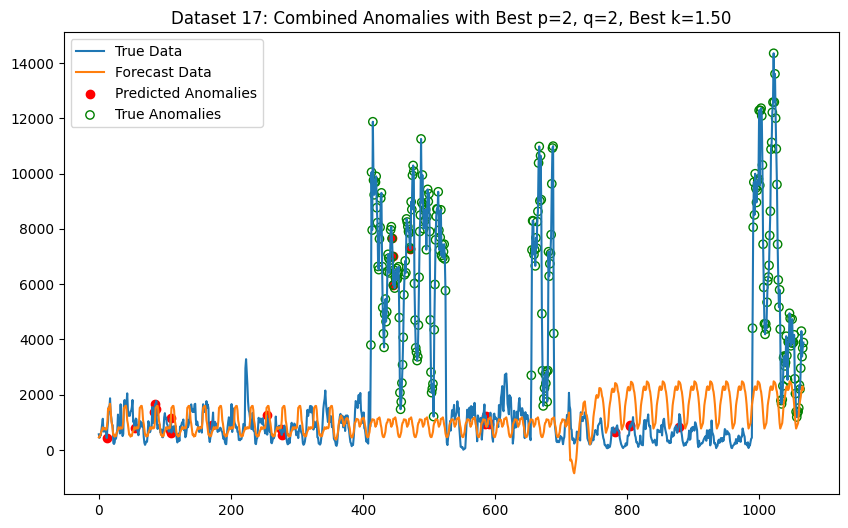

Dataset 17: Best p=2, q=2, Best k=1.50, Best Window=500, Precision=0.89, Recall=0.24, F1=0.68


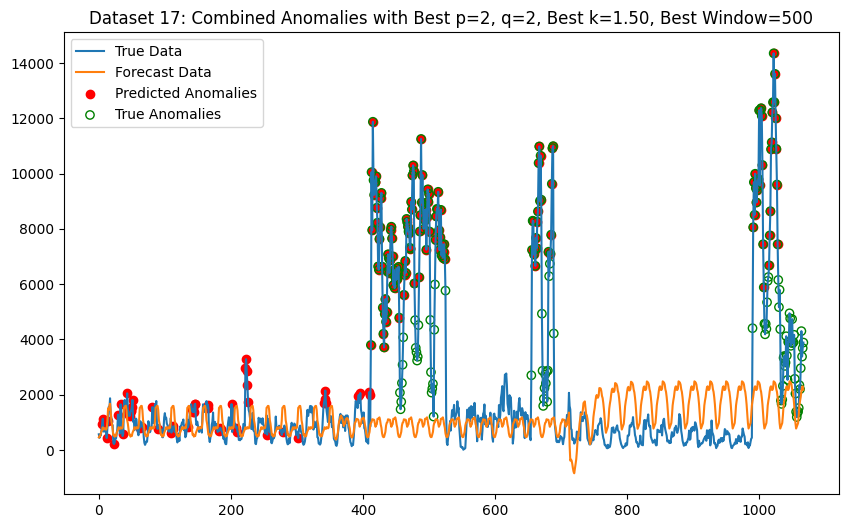

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 19: Best p=1, q=2, Best k=1.50, Precision=1.00, Recall=0.11, F1=0.52


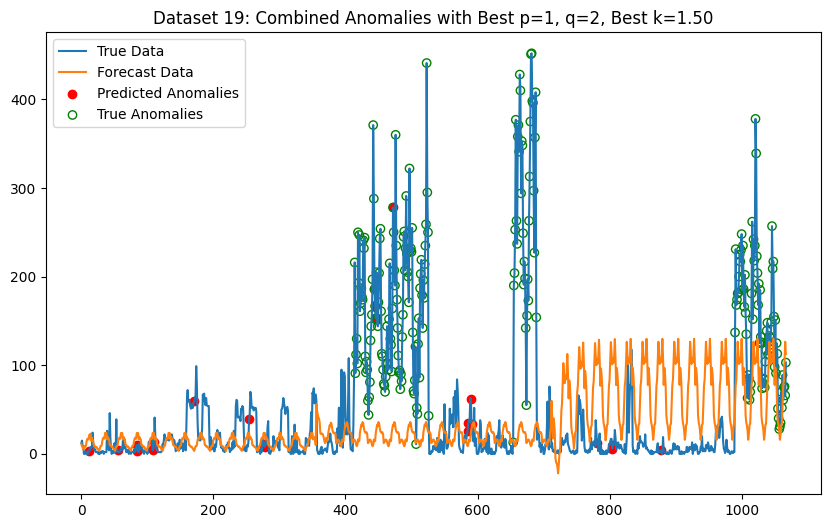

Dataset 19: Best p=1, q=2, Best k=1.50, Best Window=500, Precision=0.73, Recall=0.25, F1=0.53


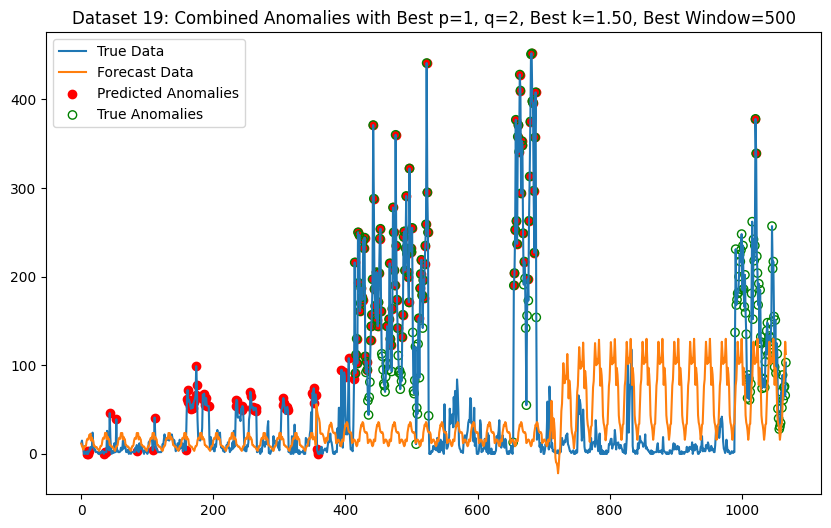

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 26: Best p=1, q=1, Best k=1.50, Precision=0.00, Recall=0.00, F1=0.07


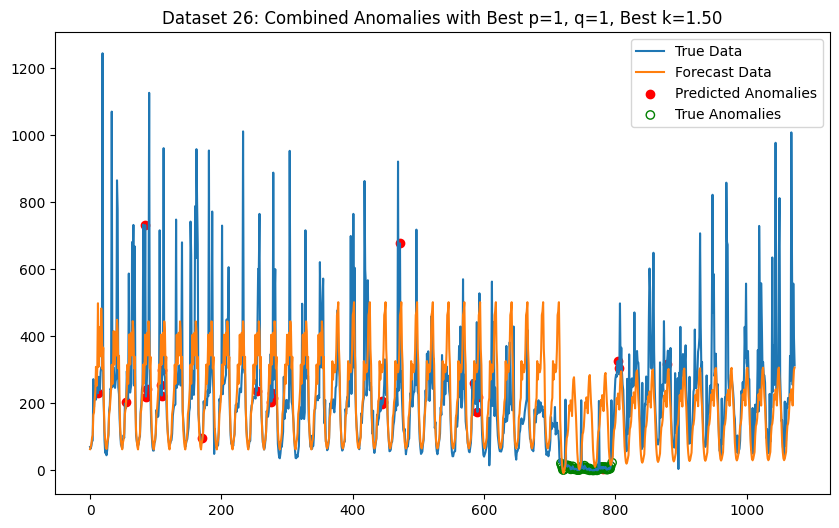

Dataset 26: Best p=1, q=1, Best k=1.50, Best Window=500, Precision=0.00, Recall=0.00, F1=0.13


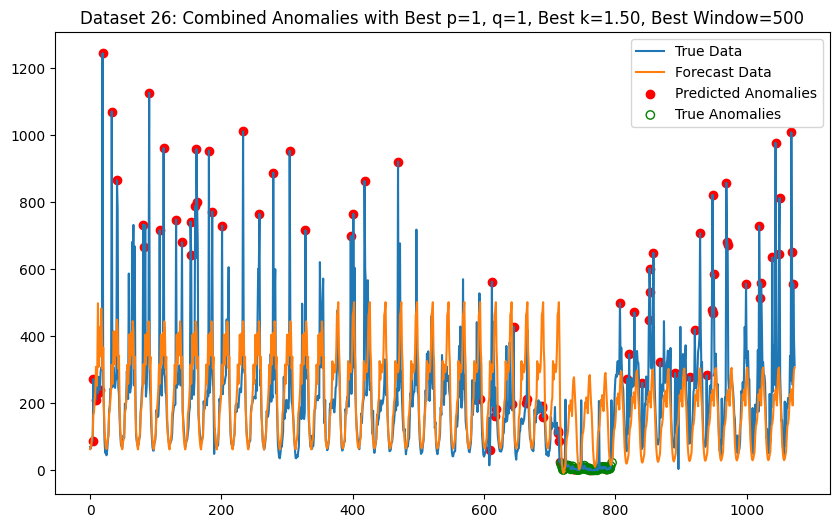

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 37: Best p=1, q=2, Best k=2.50, Precision=0.53, Recall=0.47, F1=0.52


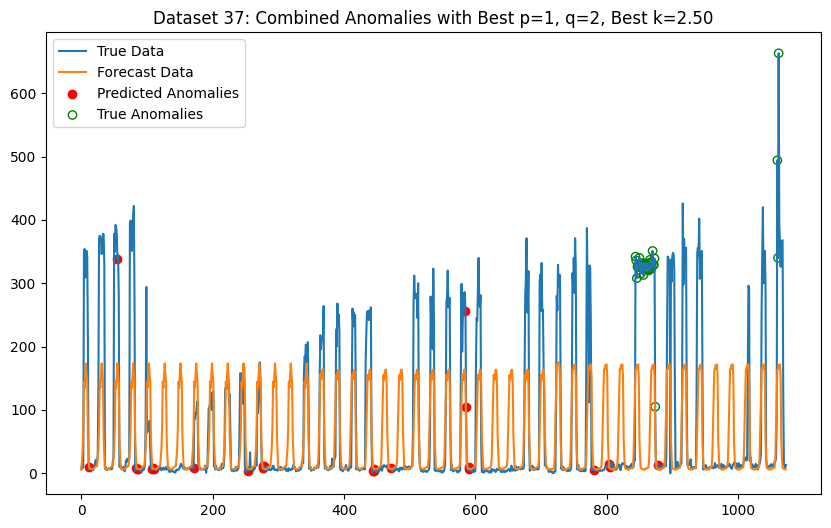

Dataset 37: Best p=1, q=2, Best k=3.00, Best Window=500, Precision=0.62, Recall=0.53, F1=0.57


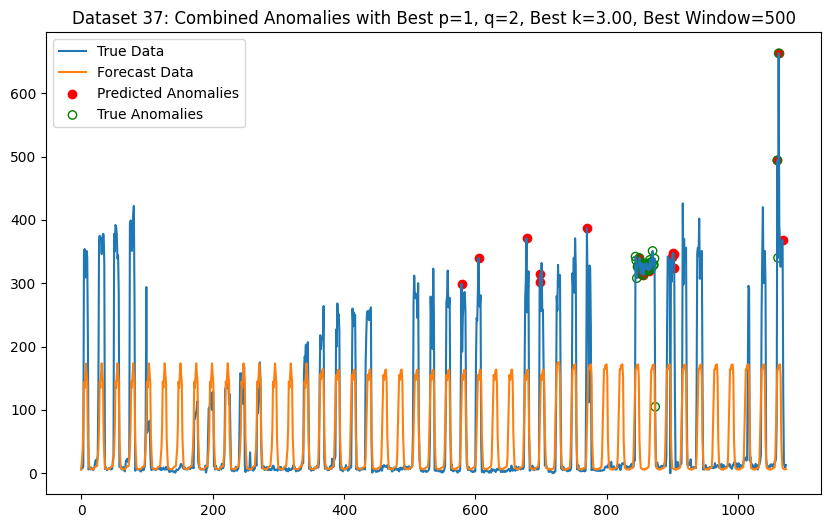

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 40: Best p=1, q=1, Best k=1.50, Precision=0.26, Recall=0.06, F1=0.49


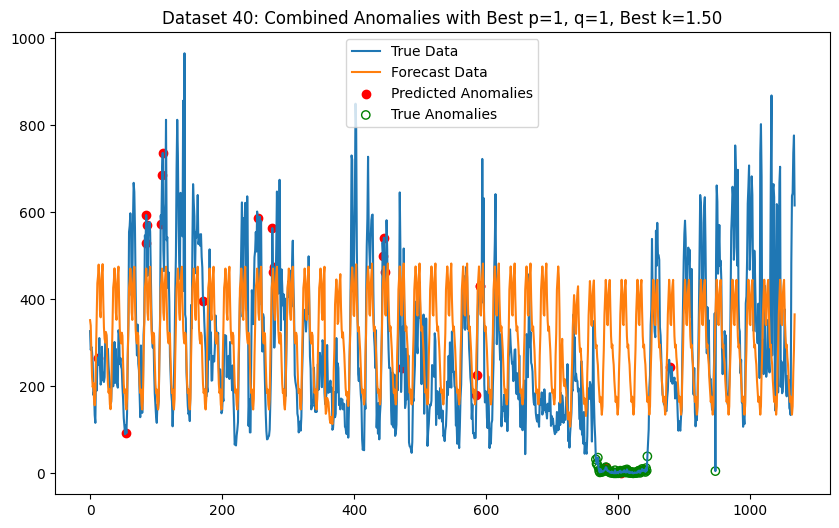

Dataset 40: Best p=1, q=1, Best k=1.50, Best Window=500, Precision=0.46, Recall=0.16, F1=0.42


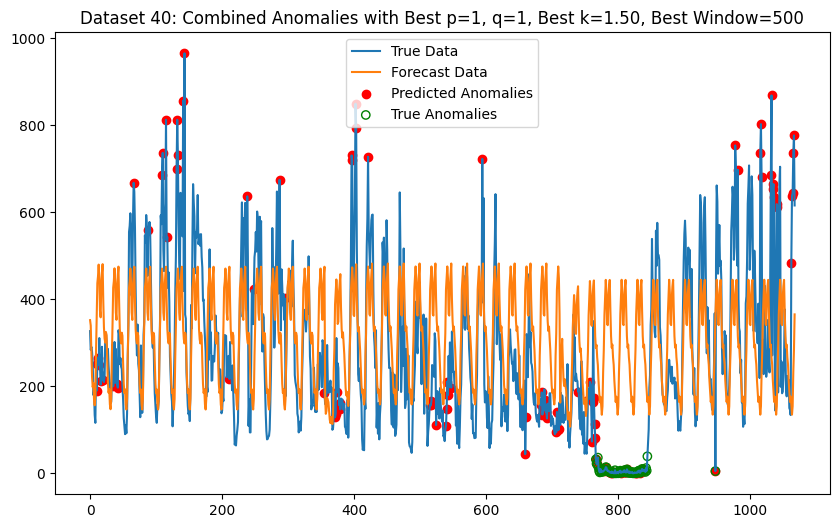

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Dataset 47: Best p=2, q=1, Best k=3.00, Precision=0.75, Recall=0.60, F1=0.67


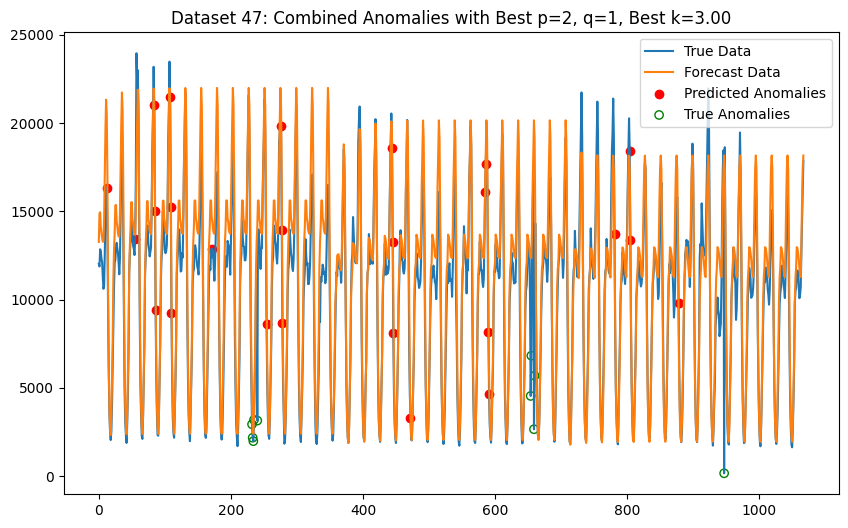

Dataset 47: Best p=2, q=1, Best k=3.00, Best Window=300, Precision=0.67, Recall=0.60, F1=0.63


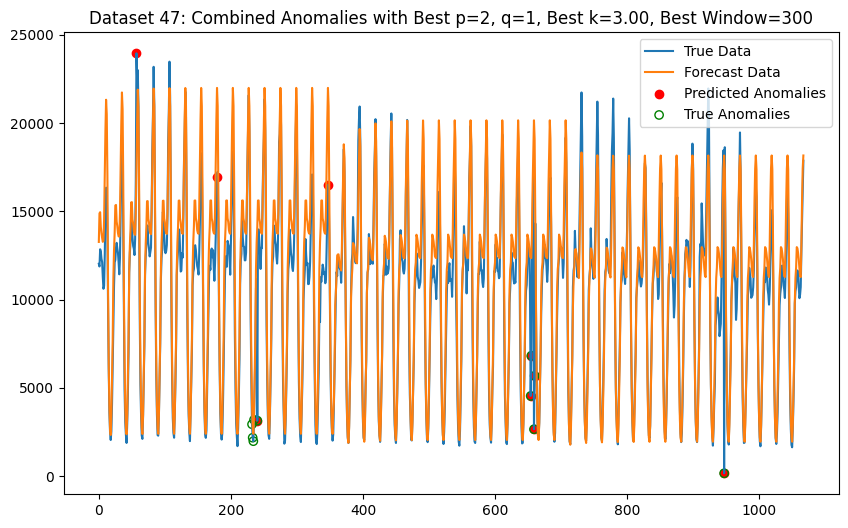


Average Metrics Across All Datasets:
Average Precision=0.59
Average Recall=0.23
Average F1-Score=0.50
All F1 Scores for each dataset: 0.7318, 0.5212, 0.0658, 0.5205, 0.4910, 0.6667

Average Metrics Across All Datasets:
Average Precision=0.56
Average Recall=0.30
Average F1-Score=0.49
All F1 Scores for each dataset: 0.6760, 0.5266, 0.1310, 0.5714, 0.4206, 0.6316


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets
A1C = [17, 19, 26, 37, 40, 47]

# Storage for metrics
all_precisions_sw = []
all_recalls_sw = []
all_f1_scores_sw = []
all_precisions_dw = []
all_recalls_dw = []
all_f1_scores_dw = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=3)

# Parameters for SARIMAX and thresholds
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1C:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Find the best SARIMAX model for this split
        best_p, best_q = None, None
        best_mae = float('inf')
        best_model_fit = None
        forecast = None

        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the training data
                    model = SARIMAX(y_train,
                                    order=(p, d, q),
                                    seasonal_order=(P, D, Q, m),
                                    enforce_stationarity=False,
                                    enforce_invertibility=False)
                    model_fit = model.fit(disp=False)

                    # Forecast on the test data
                    forecast_temp = model_fit.get_forecast(steps=len(y_test)).predicted_mean

                    # Calculate MAE
                    mae = np.mean(np.abs(y_test - forecast_temp))

                    if mae < best_mae:
                        best_mae = mae
                        best_p, best_q = p, q
                        best_model_fit = model_fit
                        forecast = forecast_temp

                except Exception as e:
                    print(f"Error with SARIMAX(p={p}, q={q}): {e}")

        # Calculate residuals for the best SARIMAX model
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

###
# stat win
###

    # Find the optimal k using combined residuals for a static threshold
    best_k_sw = None
    best_f1_sw = -1
    best_combined_predicted_anomalies_sw = None

    # Calculate static mean and std of residuals
    mean_residuals = np.mean(combined_residuals)
    std_residuals = np.std(combined_residuals)

    for k in k_values:
        # Static threshold
        threshold = mean_residuals + k * std_residuals
        predicted_anomalies_sw = (np.array(combined_residuals) > threshold).astype(int)

        # Compute F1 score for the current k
        precision = precision_score(combined_true_anomalies, predicted_anomalies_sw)
        recall = recall_score(combined_true_anomalies, predicted_anomalies_sw)
        f1 = f1_score(combined_true_anomalies, predicted_anomalies_sw)

        # Check if this k is the best so far
        if f1 > best_f1_sw:
            best_f1_sw = f1
            best_k_sw = k
            best_combined_predicted_anomalies_sw = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions_sw.append(precision)
    all_recalls_sw.append(recall)
    all_f1_scores_sw.append(best_f1_sw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_sw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_sw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}")
    plt.show()

###
# dyn win
###

# Find the optimal combination of window size and k using combined residuals
    best_window = None
    best_k_dw = None
    best_f1_dw = -1
    best_combined_predicted_anomalies_dw = None

    for window_size in window_sizes:
        for k in k_values:
            # Calculate rolling statistics for dynamic threshold
            rolling_residuals = pd.Series(combined_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            # Determine anomalies using dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies_dw = (pd.Series(combined_residuals) > threshold).astype(int)

            # Compute F1 score for the current window size and k
            precision = precision_score(combined_true_anomalies, predicted_anomalies_dw)
            recall = recall_score(combined_true_anomalies, predicted_anomalies_dw)
            f1 = f1_score(combined_true_anomalies, predicted_anomalies_dw)

            # Check if this combination of window size and k is the best so far
            if f1 > best_f1_dw:
                best_f1_dw = f1
                best_k_dw = k
                best_window = window_size
                best_combined_predicted_anomalies_dw = predicted_anomalies_dw

    # Store the best metrics for this dataset
    all_precisions_dw.append(precision)
    all_recalls_dw.append(recall)
    all_f1_scores_dw.append(best_f1_dw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_dw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_dw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}")
    plt.show()

###
# avg metrics
###

# Calculate and display average metrics
average_precision_sw = np.mean(all_precisions_sw)
average_recall_sw = np.mean(all_recalls_sw)
average_f1_score_sw = np.mean(all_f1_scores_sw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_sw:.2f}")
print(f"Average Recall={average_recall_sw:.2f}")
print(f"Average F1-Score={average_f1_score_sw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_sw = [f"{score:.4f}" for score in all_f1_scores_sw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_sw)}")

# Calculate and display average metrics
average_precision_dw = np.mean(all_precisions_dw)
average_recall_dw = np.mean(all_recalls_dw)
average_f1_score_dw = np.mean(all_f1_scores_dw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_dw:.2f}")
print(f"Average Recall={average_recall_dw:.2f}")
print(f"Average F1-Score={average_f1_score_dw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_dw = [f"{score:.4f}" for score in all_f1_scores_dw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_dw)}")

## A1D

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/sta

Dataset 28: Best p=2, q=2, Best k=2.50, Precision=0.07, Recall=0.02, F1=0.05


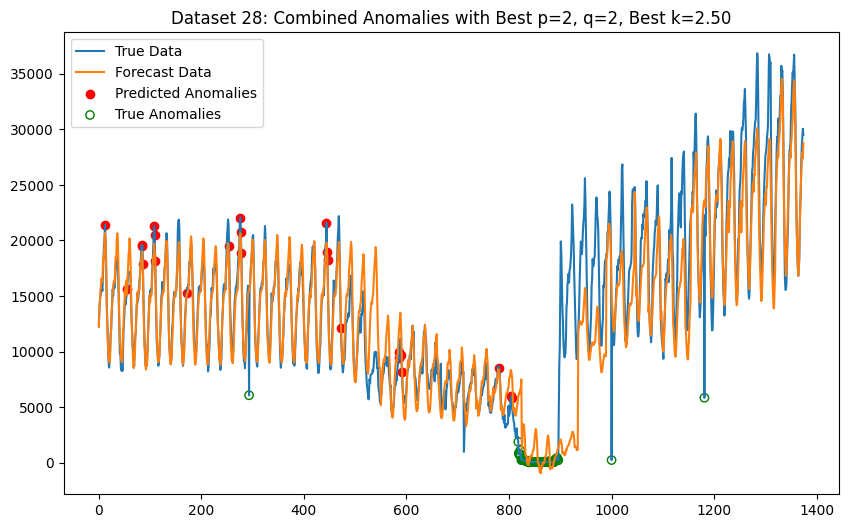

Dataset 28: Best p=2, q=2, Best k=3.00, Best Window=100, Precision=0.08, Recall=0.06, F1=0.15


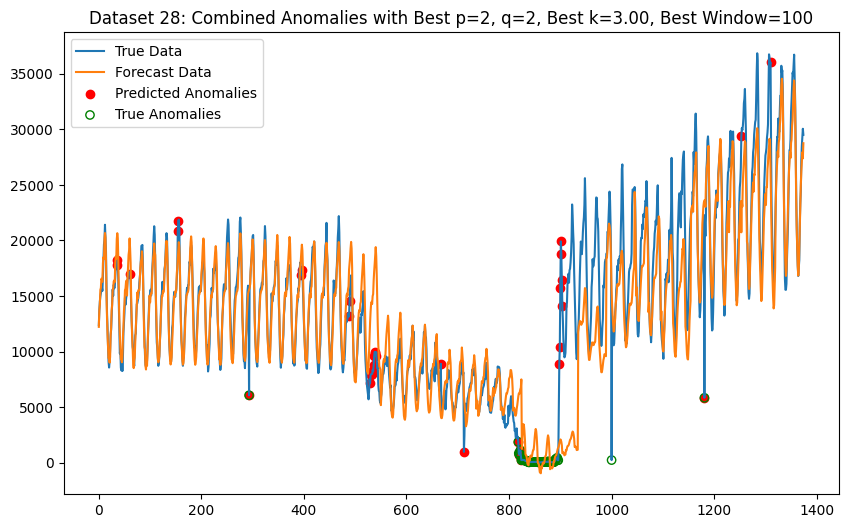

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/sta

Dataset 43: Best p=1, q=1, Best k=1.50, Precision=0.00, Recall=0.00, F1=0.00


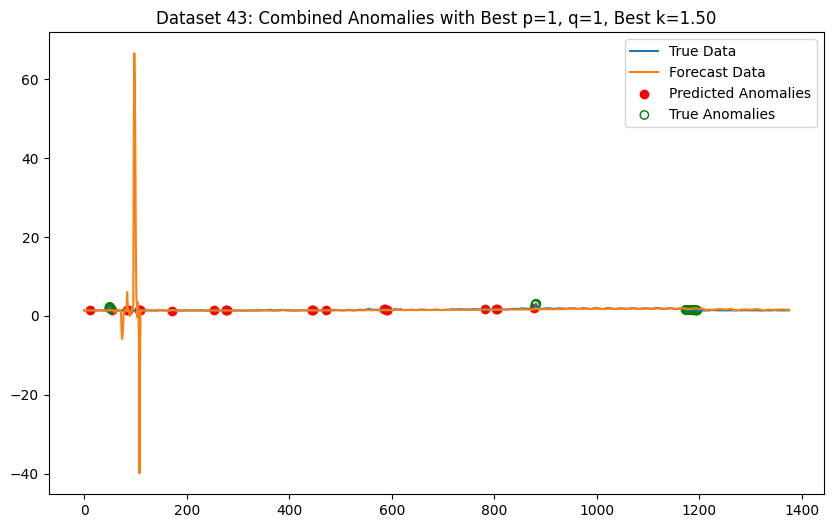

Dataset 43: Best p=1, q=1, Best k=3.00, Best Window=200, Precision=0.56, Recall=0.47, F1=0.71


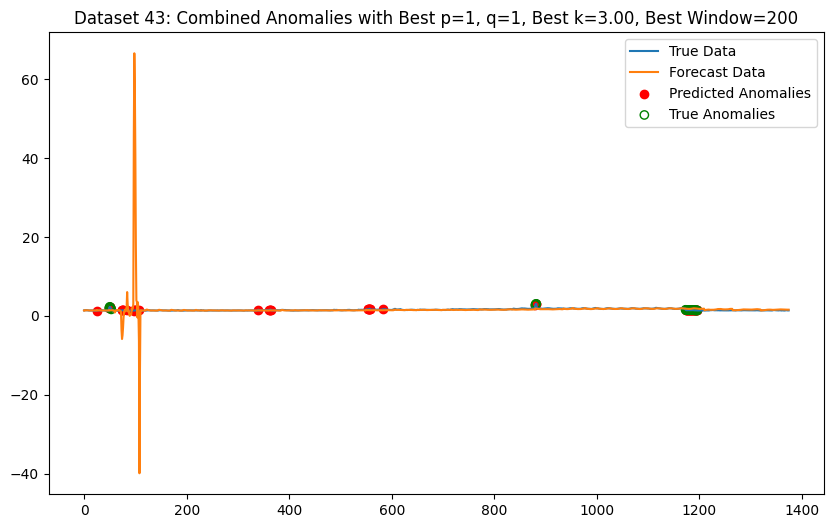

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/sta

Dataset 46: Best p=2, q=1, Best k=3.00, Precision=0.06, Recall=0.02, F1=0.03


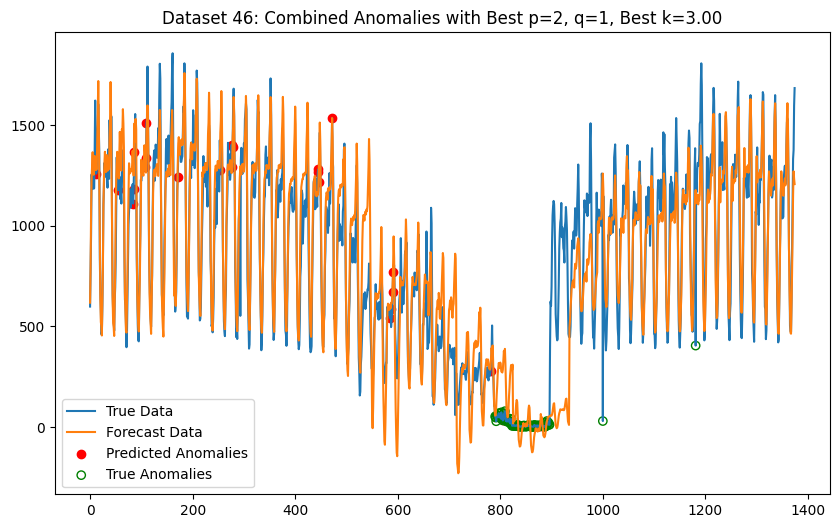

Dataset 46: Best p=2, q=1, Best k=1.50, Best Window=100, Precision=0.02, Recall=0.01, F1=0.06


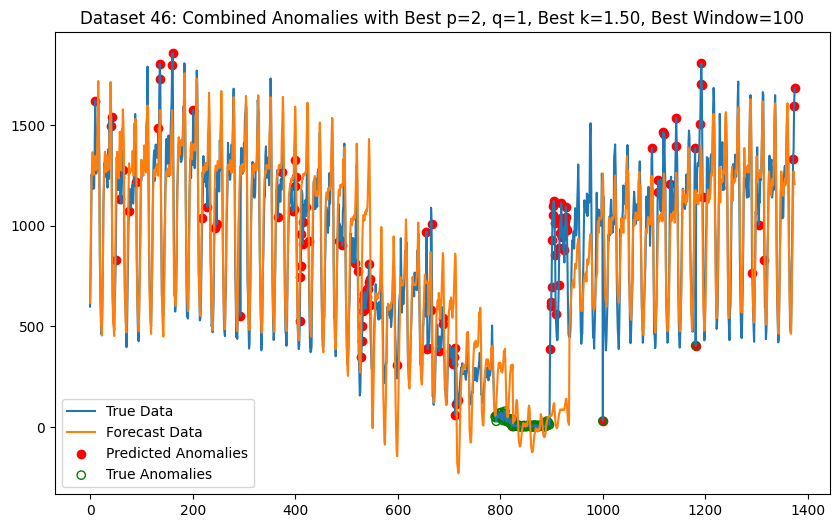

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/sta

Dataset 55: Best p=2, q=1, Best k=3.00, Precision=0.33, Recall=0.80, F1=0.47


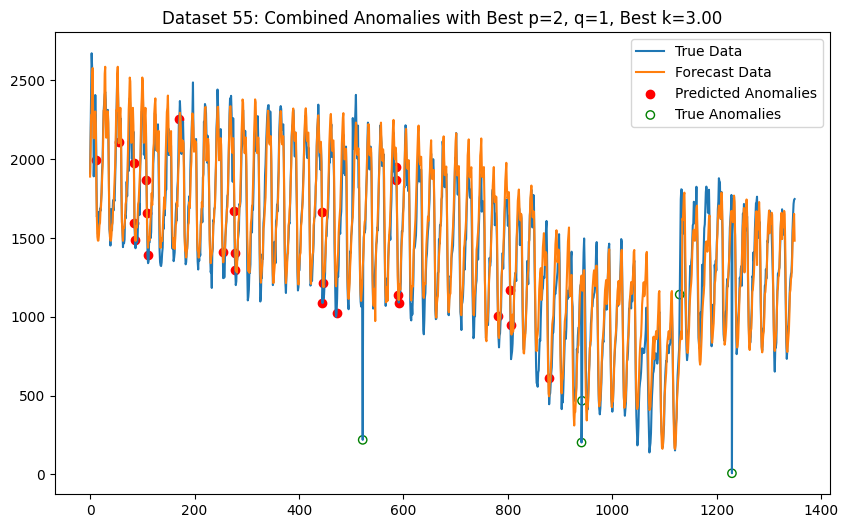

Dataset 55: Best p=2, q=1, Best k=3.00, Best Window=500, Precision=0.17, Recall=0.80, F1=0.28


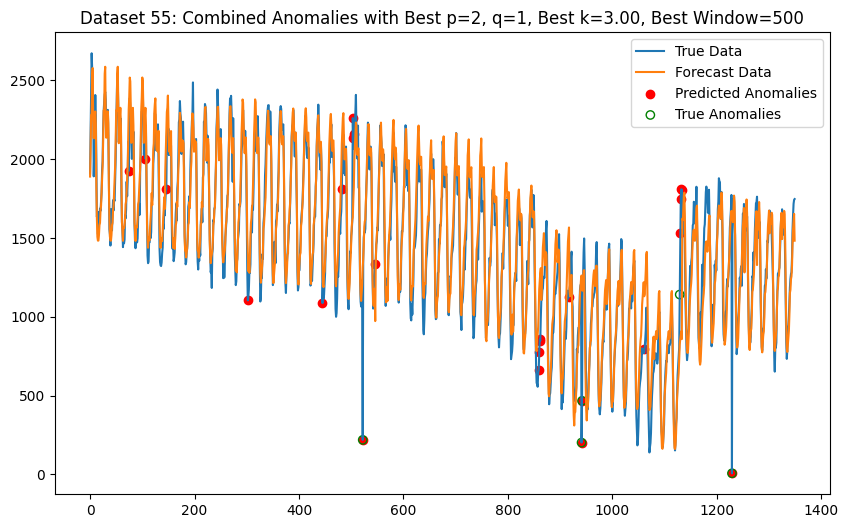

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


KeyboardInterrupt: 

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets
A1D = [28,43,46,55,56,65]

# Storage for metrics
all_precisions_sw = []
all_recalls_sw = []
all_f1_scores_sw = []
all_precisions_dw = []
all_recalls_dw = []
all_f1_scores_dw = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=25)

# Parameters for SARIMAX and thresholds
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1D:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Find the best SARIMAX model for this split
        best_p, best_q = None, None
        best_mae = float('inf')
        best_model_fit = None
        forecast = None

        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the training data
                    model = SARIMAX(y_train,
                                    order=(p, d, q),
                                    seasonal_order=(P, D, Q, m),
                                    enforce_stationarity=False,
                                    enforce_invertibility=False)
                    model_fit = model.fit(disp=False)

                    # Forecast on the test data
                    forecast_temp = model_fit.get_forecast(steps=len(y_test)).predicted_mean

                    # Calculate MAE
                    mae = np.mean(np.abs(y_test - forecast_temp))

                    if mae < best_mae:
                        best_mae = mae
                        best_p, best_q = p, q
                        best_model_fit = model_fit
                        forecast = forecast_temp

                except Exception as e:
                    print(f"Error with SARIMAX(p={p}, q={q}): {e}")

        # Calculate residuals for the best SARIMAX model
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

###
# stat win
###

    # Find the optimal k using combined residuals for a static threshold
    best_k_sw = None
    best_f1_sw = -1
    best_combined_predicted_anomalies_sw = None

    # Calculate static mean and std of residuals
    mean_residuals = np.mean(combined_residuals)
    std_residuals = np.std(combined_residuals)

    for k in k_values:
        # Static threshold
        threshold = mean_residuals + k * std_residuals
        predicted_anomalies_sw = (np.array(combined_residuals) > threshold).astype(int)

        # Compute F1 score for the current k
        precision = precision_score(combined_true_anomalies, predicted_anomalies_sw)
        recall = recall_score(combined_true_anomalies, predicted_anomalies_sw)
        f1 = f1_score(combined_true_anomalies, predicted_anomalies_sw)

        # Check if this k is the best so far
        if f1 > best_f1_sw:
            best_f1_sw = f1
            best_k_sw = k
            best_combined_predicted_anomalies_sw = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions_sw.append(precision)
    all_recalls_sw.append(recall)
    all_f1_scores_sw.append(best_f1_sw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_sw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_sw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}")
    plt.show()

###
# dyn win
###

# Find the optimal combination of window size and k using combined residuals
    best_window = None
    best_k_dw = None
    best_f1_dw = -1
    best_combined_predicted_anomalies_dw = None

    for window_size in window_sizes:
        for k in k_values:
            # Calculate rolling statistics for dynamic threshold
            rolling_residuals = pd.Series(combined_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            # Determine anomalies using dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies_dw = (pd.Series(combined_residuals) > threshold).astype(int)

            # Compute F1 score for the current window size and k
            precision = precision_score(combined_true_anomalies, predicted_anomalies_dw)
            recall = recall_score(combined_true_anomalies, predicted_anomalies_dw)
            f1 = f1_score(combined_true_anomalies, predicted_anomalies_dw)

            # Check if this combination of window size and k is the best so far
            if f1 > best_f1_dw:
                best_f1_dw = f1
                best_k_dw = k
                best_window = window_size
                best_combined_predicted_anomalies_dw = predicted_anomalies_dw

    # Store the best metrics for this dataset
    all_precisions_dw.append(precision)
    all_recalls_dw.append(recall)
    all_f1_scores_dw.append(best_f1_dw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_dw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_dw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}")
    plt.show()

###
# avg metrics
###

# Calculate and display average metrics
average_precision_sw = np.mean(all_precisions_sw)
average_recall_sw = np.mean(all_recalls_sw)
average_f1_score_sw = np.mean(all_f1_scores_sw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_sw:.2f}")
print(f"Average Recall={average_recall_sw:.2f}")
print(f"Average F1-Score={average_f1_score_sw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_sw = [f"{score:.4f}" for score in all_f1_scores_sw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_sw)}")

# Calculate and display average metrics
average_precision_dw = np.mean(all_precisions_dw)
average_recall_dw = np.mean(all_recalls_dw)
average_f1_score_dw = np.mean(all_f1_scores_dw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_dw:.2f}")
print(f"Average Recall={average_recall_dw:.2f}")
print(f"Average F1-Score={average_f1_score_dw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_dw = [f"{score:.4f}" for score in all_f1_scores_dw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_dw)}")

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/sta

Dataset 56: Best p=2, q=1, Best k=3.00, Precision=0.19, Recall=0.80, F1=0.31


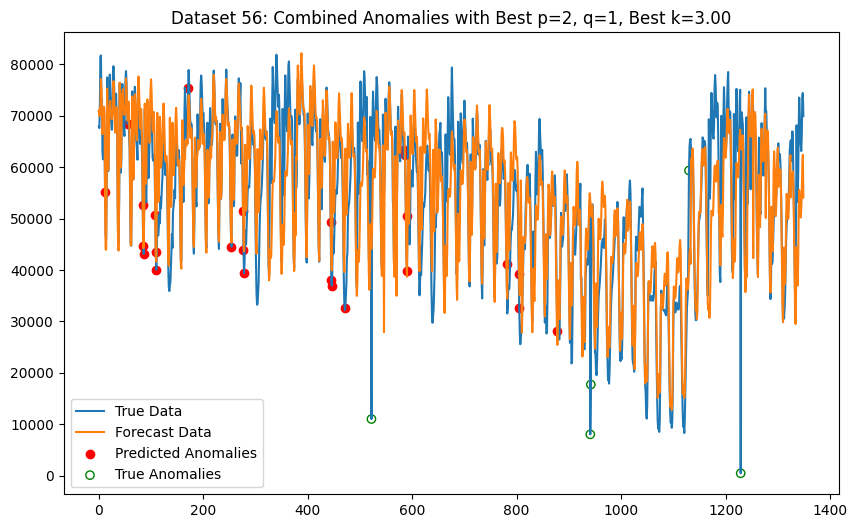

Dataset 56: Best p=2, q=1, Best k=3.00, Best Window=300, Precision=0.10, Recall=0.80, F1=0.23


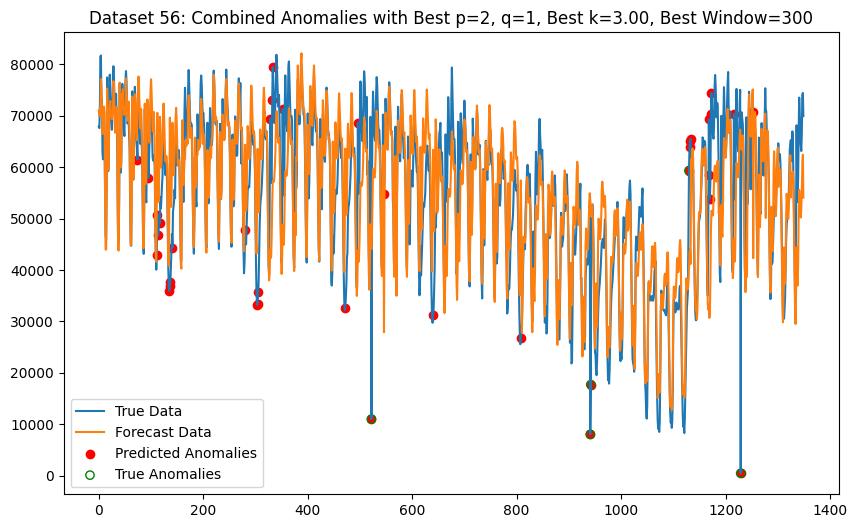

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/sta

Dataset 65: Best p=1, q=1, Best k=1.50, Precision=0.41, Recall=0.41, F1=0.51


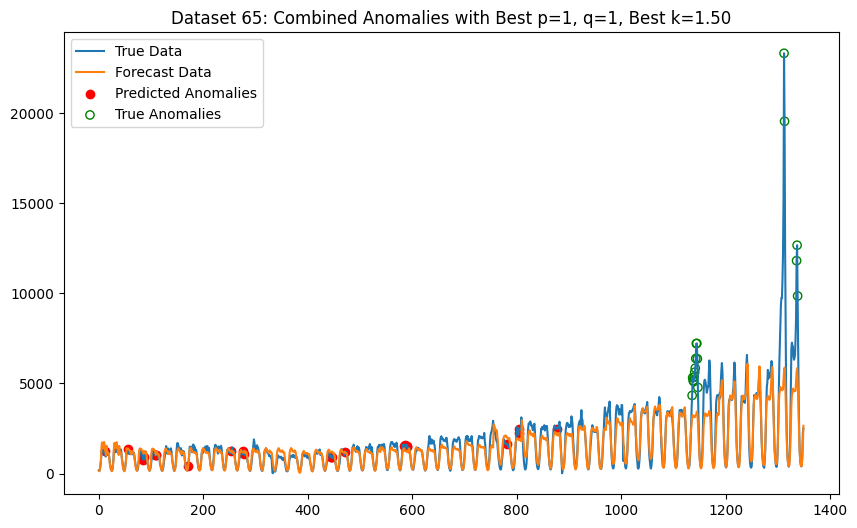

Dataset 65: Best p=1, q=1, Best k=3.00, Best Window=100, Precision=0.27, Recall=0.94, F1=0.52


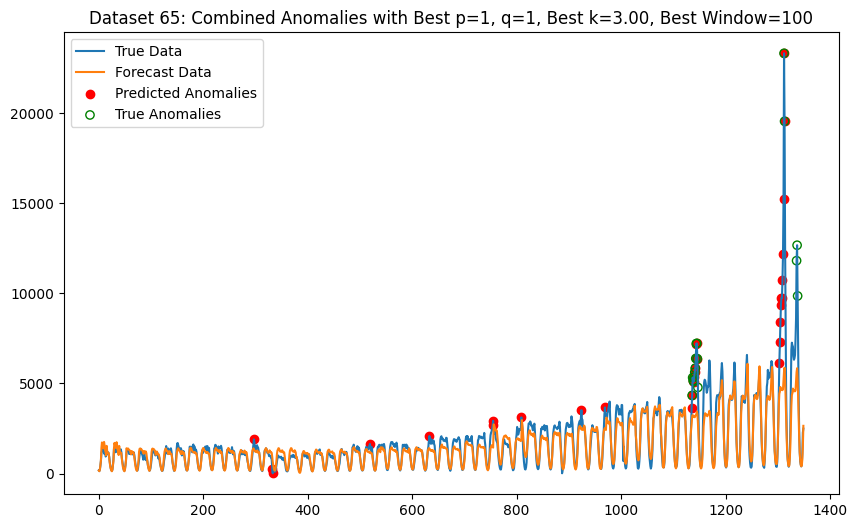


Average Metrics Across All Datasets:
Average Precision=0.30
Average Recall=0.61
Average F1-Score=0.41
All F1 Scores for each dataset: 0.3077, 0.5079

Average Metrics Across All Datasets:
Average Precision=0.18
Average Recall=0.87
Average F1-Score=0.38
All F1 Scores for each dataset: 0.2326, 0.5200


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets
A1D = [56,65]

# Storage for metrics
all_precisions_sw = []
all_recalls_sw = []
all_f1_scores_sw = []
all_precisions_dw = []
all_recalls_dw = []
all_f1_scores_dw = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=25)

# Parameters for SARIMAX and thresholds
p_values = [1, 2]
q_values = [1, 2]
d = 0
m = 24
P = 1
D = 1
Q = 1
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1D:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Find the best SARIMAX model for this split
        best_p, best_q = None, None
        best_mae = float('inf')
        best_model_fit = None
        forecast = None

        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the training data
                    model = SARIMAX(y_train,
                                    order=(p, d, q),
                                    seasonal_order=(P, D, Q, m),
                                    enforce_stationarity=False,
                                    enforce_invertibility=False)
                    model_fit = model.fit(disp=False)

                    # Forecast on the test data
                    forecast_temp = model_fit.get_forecast(steps=len(y_test)).predicted_mean

                    # Calculate MAE
                    mae = np.mean(np.abs(y_test - forecast_temp))

                    if mae < best_mae:
                        best_mae = mae
                        best_p, best_q = p, q
                        best_model_fit = model_fit
                        forecast = forecast_temp

                except Exception as e:
                    print(f"Error with SARIMAX(p={p}, q={q}): {e}")

        # Calculate residuals for the best SARIMAX model
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

###
# stat win
###

    # Find the optimal k using combined residuals for a static threshold
    best_k_sw = None
    best_f1_sw = -1
    best_combined_predicted_anomalies_sw = None

    # Calculate static mean and std of residuals
    mean_residuals = np.mean(combined_residuals)
    std_residuals = np.std(combined_residuals)

    for k in k_values:
        # Static threshold
        threshold = mean_residuals + k * std_residuals
        predicted_anomalies_sw = (np.array(combined_residuals) > threshold).astype(int)

        # Compute F1 score for the current k
        precision = precision_score(combined_true_anomalies, predicted_anomalies_sw)
        recall = recall_score(combined_true_anomalies, predicted_anomalies_sw)
        f1 = f1_score(combined_true_anomalies, predicted_anomalies_sw)

        # Check if this k is the best so far
        if f1 > best_f1_sw:
            best_f1_sw = f1
            best_k_sw = k
            best_combined_predicted_anomalies_sw = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions_sw.append(precision)
    all_recalls_sw.append(recall)
    all_f1_scores_sw.append(best_f1_sw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_sw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_sw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_sw:.2f}")
    plt.show()

###
# dyn win
###

# Find the optimal combination of window size and k using combined residuals
    best_window = None
    best_k_dw = None
    best_f1_dw = -1
    best_combined_predicted_anomalies_dw = None

    for window_size in window_sizes:
        for k in k_values:
            # Calculate rolling statistics for dynamic threshold
            rolling_residuals = pd.Series(combined_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            # Determine anomalies using dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies_dw = (pd.Series(combined_residuals) > threshold).astype(int)

            # Compute F1 score for the current window size and k
            precision = precision_score(combined_true_anomalies, predicted_anomalies_dw)
            recall = recall_score(combined_true_anomalies, predicted_anomalies_dw)
            f1 = f1_score(combined_true_anomalies, predicted_anomalies_dw)

            # Check if this combination of window size and k is the best so far
            if f1 > best_f1_dw:
                best_f1_dw = f1
                best_k_dw = k
                best_window = window_size
                best_combined_predicted_anomalies_dw = predicted_anomalies_dw

    # Store the best metrics for this dataset
    all_precisions_dw.append(precision)
    all_recalls_dw.append(recall)
    all_f1_scores_dw.append(best_f1_dw)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1_dw:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies_dw == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k_dw:.2f}, Best Window={best_window}")
    plt.show()

###
# avg metrics
###

# Calculate and display average metrics
average_precision_sw = np.mean(all_precisions_sw)
average_recall_sw = np.mean(all_recalls_sw)
average_f1_score_sw = np.mean(all_f1_scores_sw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_sw:.2f}")
print(f"Average Recall={average_recall_sw:.2f}")
print(f"Average F1-Score={average_f1_score_sw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_sw = [f"{score:.4f}" for score in all_f1_scores_sw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_sw)}")

# Calculate and display average metrics
average_precision_dw = np.mean(all_precisions_dw)
average_recall_dw = np.mean(all_recalls_dw)
average_f1_score_dw = np.mean(all_f1_scores_dw)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision_dw:.2f}")
print(f"Average Recall={average_recall_dw:.2f}")
print(f"Average F1-Score={average_f1_score_dw:.2f}")
# Print each F1 score formatted individually
formatted_f1_scores_dw = [f"{score:.4f}" for score in all_f1_scores_dw]
print(f"All F1 Scores for each dataset: {', '.join(formatted_f1_scores_dw)}")

## static

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 28: Best p=1, q=1, Best k=1.50, Precision=0.05, Recall=0.02, F1=0.06


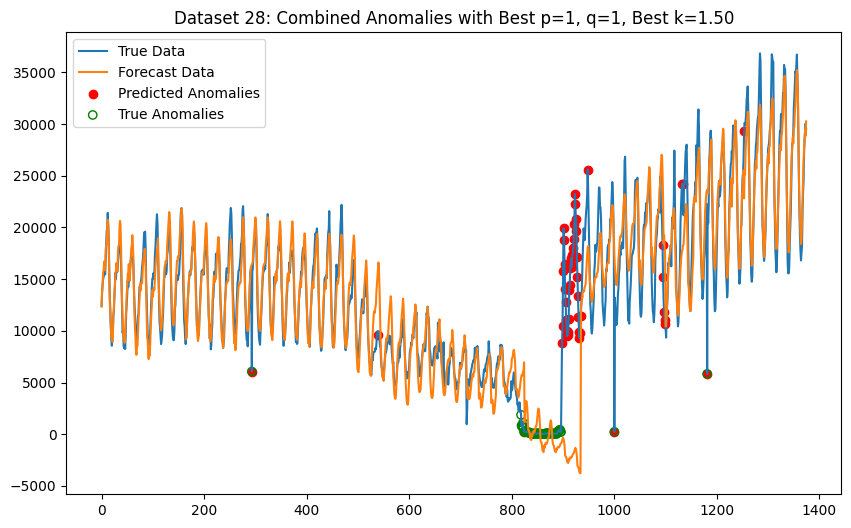

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 43: Best p=1, q=2, Best k=1.50, Precision=0.00, Recall=0.00, F1=0.13


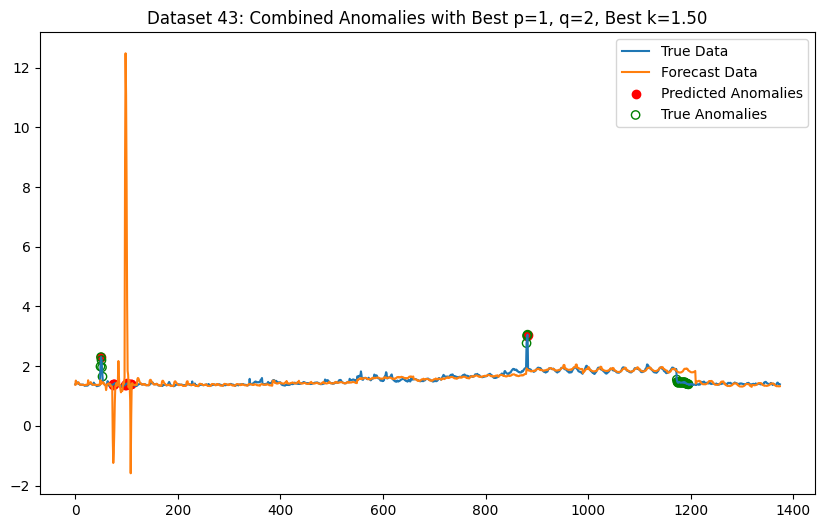

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 46: Best p=1, q=1, Best k=3.00, Precision=0.06, Recall=0.02, F1=0.03


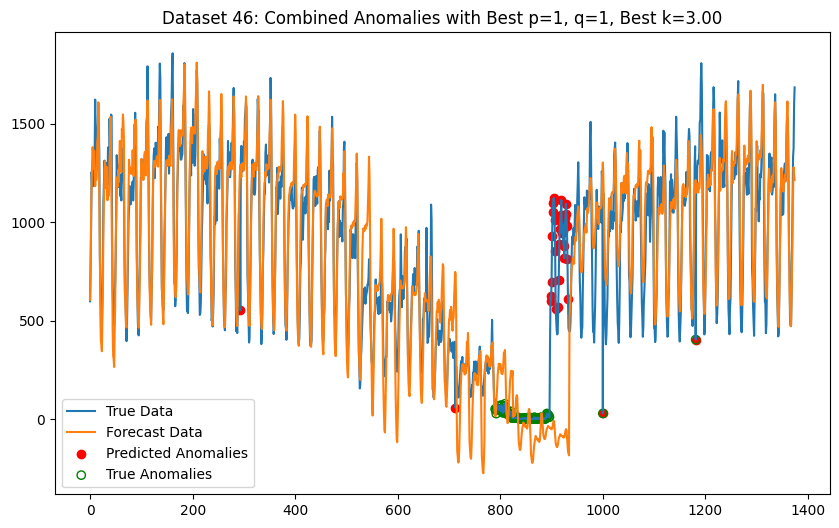

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 55: Best p=1, q=1, Best k=3.00, Precision=0.38, Recall=1.00, F1=0.56


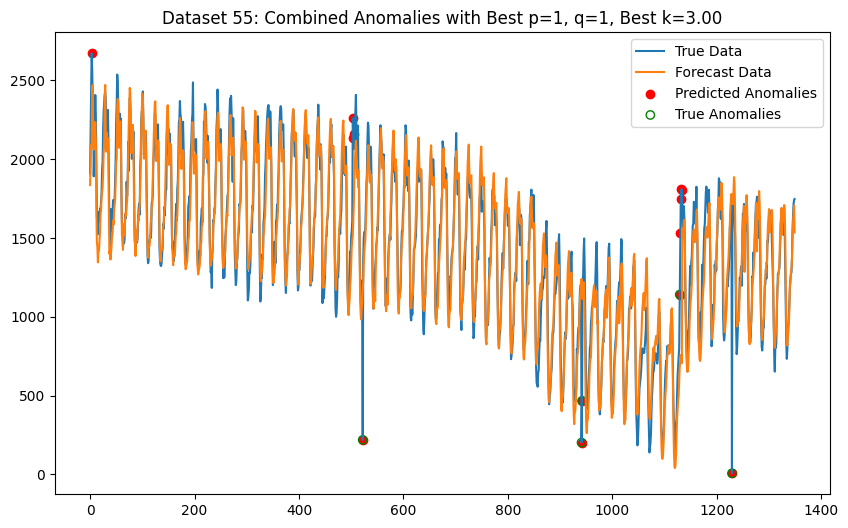

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


Dataset 56: Best p=1, q=1, Best k=3.00, Precision=0.31, Recall=1.00, F1=0.48


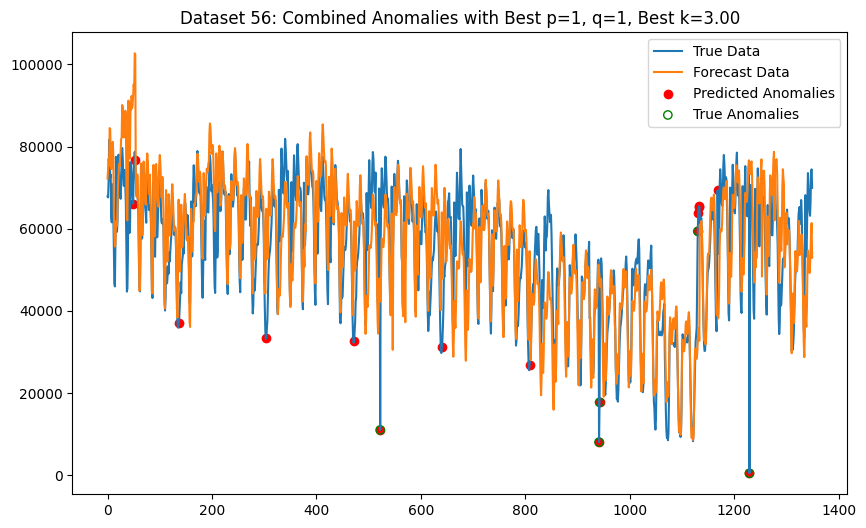

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 65: Best p=2, q=2, Best k=1.50, Precision=0.41, Recall=0.41, F1=0.56


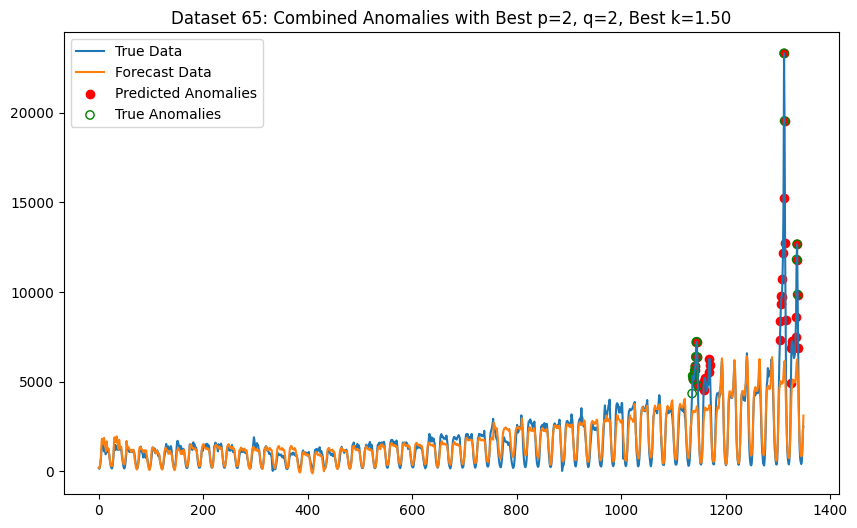


Average Metrics Across All Datasets:
Average Precision=0.20
Average Recall=0.41
Average F1-Score=0.30


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets
A1D = [28,43,46,55,56,65]


# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=25)

# Parameters for SARIMAX and thresholds
p_values = [1, 2]
q_values = [1, 2]
d = 1
m = 24
P = 1
D = 1
Q = 1
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1D:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Find the best SARIMAX model for this split
        best_p, best_q = None, None
        best_mae = float('inf')
        best_model_fit = None
        forecast = None

        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the training data
                    model = SARIMAX(y_train,
                                    order=(p, d, q),
                                    seasonal_order=(P, D, Q, m),
                                    enforce_stationarity=False,
                                    enforce_invertibility=False)
                    model_fit = model.fit(disp=False)

                    # Forecast on the test data
                    forecast_temp = model_fit.get_forecast(steps=len(y_test)).predicted_mean

                    # Calculate MAE
                    mae = np.mean(np.abs(y_test - forecast_temp))

                    if mae < best_mae:
                        best_mae = mae
                        best_p, best_q = p, q
                        best_model_fit = model_fit
                        forecast = forecast_temp

                except Exception as e:
                    print(f"Error with SARIMAX(p={p}, q={q}): {e}")

        # Calculate residuals for the best SARIMAX model
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

    # Find the optimal k using combined residuals for a static threshold
    best_k = None
    best_f1 = -1
    best_combined_predicted_anomalies = None

    # Calculate static mean and std of residuals
    mean_residuals = np.mean(combined_residuals)
    std_residuals = np.std(combined_residuals)

    for k in k_values:
        # Static threshold
        threshold = mean_residuals + k * std_residuals
        predicted_anomalies = (np.array(combined_residuals) > threshold).astype(int)

        # Compute F1 score for the current k
        precision = precision_score(combined_true_anomalies, predicted_anomalies)
        recall = recall_score(combined_true_anomalies, predicted_anomalies)
        f1 = f1_score(combined_true_anomalies, predicted_anomalies)

        # Check if this k is the best so far
        if f1 > best_f1:
            best_f1 = f1
            best_k = k
            best_combined_predicted_anomalies = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k:.2f}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")


## dynamic

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 28: Best p=1, q=1, Best k=3.00, Best Window=100, Precision=0.15, Recall=0.11, F1=0.14


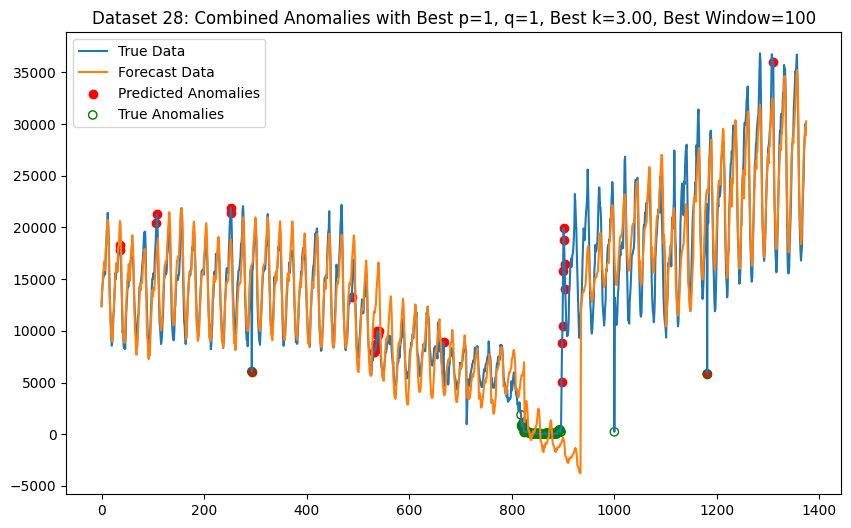

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 43: Best p=1, q=2, Best k=3.00, Best Window=200, Precision=0.53, Recall=0.72, F1=0.66


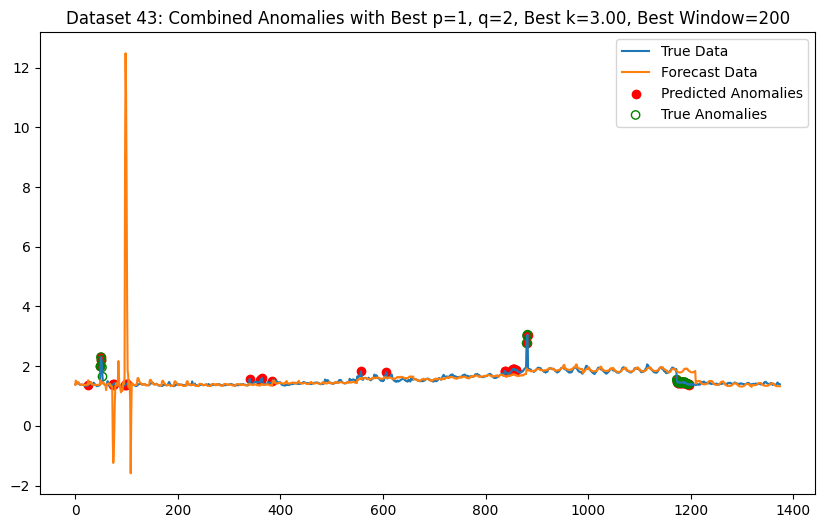

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 46: Best p=1, q=1, Best k=1.50, Best Window=500, Precision=0.02, Recall=0.01, F1=0.03


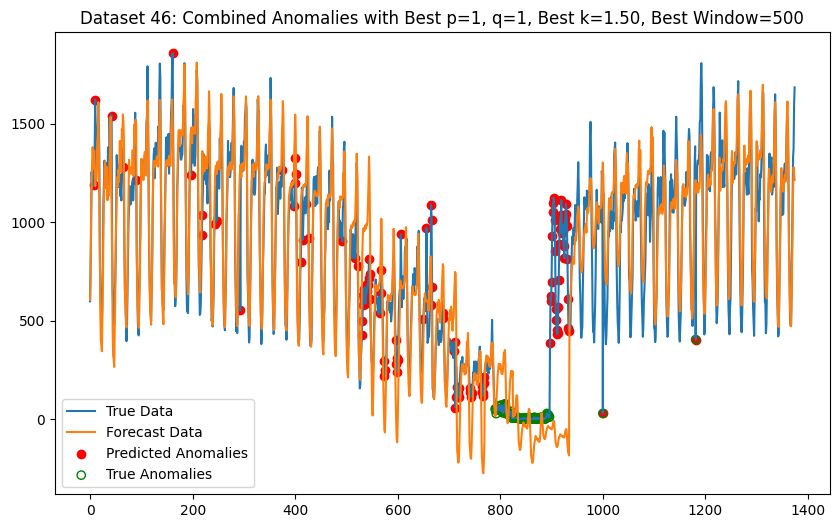

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 55: Best p=1, q=1, Best k=3.00, Best Window=500, Precision=0.38, Recall=1.00, F1=0.56


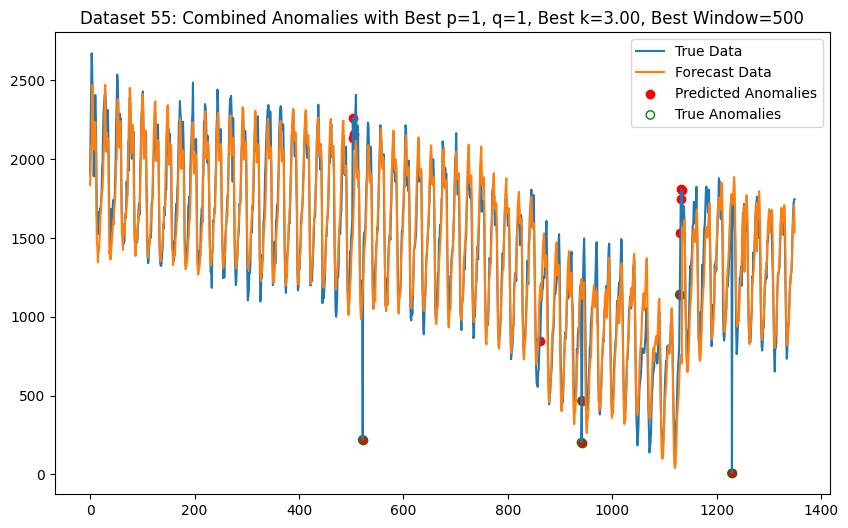

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


Dataset 56: Best p=1, q=1, Best k=3.00, Best Window=300, Precision=0.29, Recall=1.00, F1=0.48


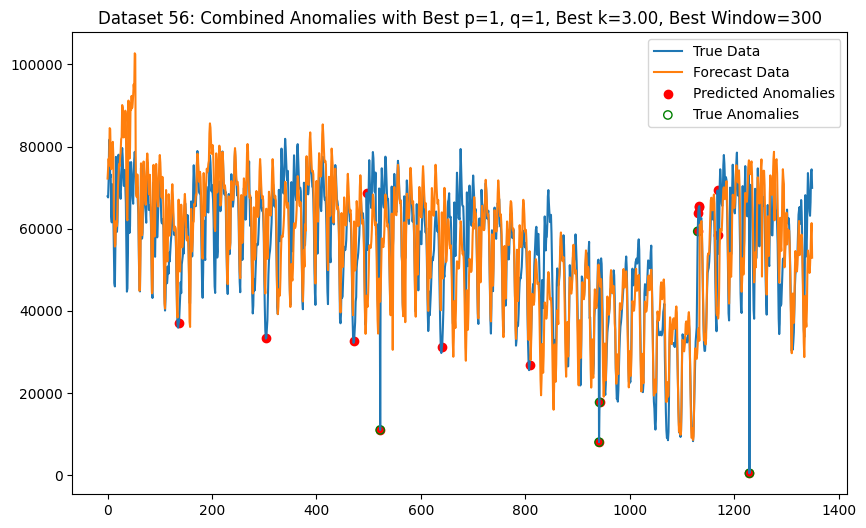

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/sta

Dataset 65: Best p=2, q=2, Best k=3.00, Best Window=100, Precision=0.26, Recall=0.94, F1=0.47


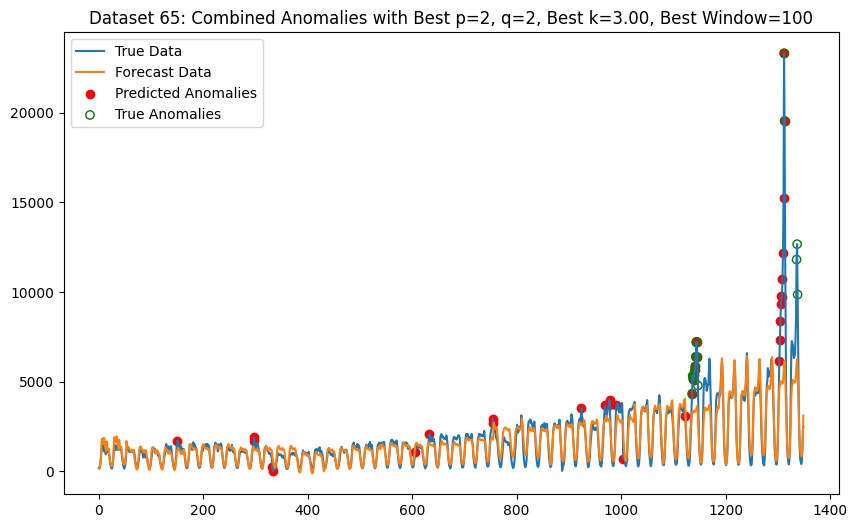


Average Metrics Across All Datasets:
Average Precision=0.27
Average Recall=0.63
Average F1-Score=0.39


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Datasets
A1D = [28,43,46,55,56,65]

# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=25)

# Parameters for SARIMAX and thresholds
p_values = [1, 2]
q_values = [1, 2]
d = 1
m = 24
P = 1
D = 1
Q = 1
window_sizes = [100, 200, 300, 500]  # Rolling window sizes to test
k_values = [1.5, 2, 2.5, 3]  # Test k values

for i in A1D:
    # Extract data and labels
    data = dfsA1[i][f'value_{i}'].values.astype(float)
    labels = dfsA1[i]['label'].values.astype(int)  # True anomaly labels (0 or 1)

    combined_residuals = []
    combined_forecast = []
    combined_y_test = []
    combined_true_anomalies = []

    for train_index, test_index in tscv.split(data):
        y_train, y_test = data[train_index], data[test_index]
        true_anomalies = labels[test_index]  # True labels for test set

        # Find the best SARIMAX model for this split
        best_p, best_q = None, None
        best_mae = float('inf')
        best_model_fit = None
        forecast = None

        for p in p_values:
            for q in q_values:
                try:
                    # Fit SARIMAX model on the training data
                    model = SARIMAX(y_train,
                                    order=(p, d, q),
                                    seasonal_order=(P, D, Q, m),
                                    enforce_stationarity=False,
                                    enforce_invertibility=False)
                    model_fit = model.fit(disp=False)

                    # Forecast on the test data
                    forecast_temp = model_fit.get_forecast(steps=len(y_test)).predicted_mean

                    # Calculate MAE
                    mae = np.mean(np.abs(y_test - forecast_temp))

                    if mae < best_mae:
                        best_mae = mae
                        best_p, best_q = p, q
                        best_model_fit = model_fit
                        forecast = forecast_temp

                except Exception as e:
                    print(f"Error with SARIMAX(p={p}, q={q}): {e}")

        # Calculate residuals for the best SARIMAX model
        residuals = np.abs(y_test - forecast)

        # Append data for combined evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(y_test)
        combined_true_anomalies.extend(true_anomalies)

    # Find the optimal combination of window size and k using combined residuals
    best_window = None
    best_k = None
    best_f1 = -1
    best_combined_predicted_anomalies = None

    for window_size in window_sizes:
        for k in k_values:
            # Calculate rolling statistics for dynamic threshold
            rolling_residuals = pd.Series(combined_residuals).rolling(window=window_size, min_periods=1)
            mean_residuals = rolling_residuals.mean()
            std_residuals = rolling_residuals.std()

            # Determine anomalies using dynamic threshold
            threshold = mean_residuals + k * std_residuals
            predicted_anomalies = (pd.Series(combined_residuals) > threshold).astype(int)

            # Compute F1 score for the current window size and k
            precision = precision_score(combined_true_anomalies, predicted_anomalies)
            recall = recall_score(combined_true_anomalies, predicted_anomalies)
            f1 = f1_score(combined_true_anomalies, predicted_anomalies)

            # Check if this combination of window size and k is the best so far
            if f1 > best_f1:
                best_f1 = f1
                best_k = k
                best_window = window_size
                best_combined_predicted_anomalies = predicted_anomalies

    # Store the best metrics for this dataset
    all_precisions.append(precision)
    all_recalls.append(recall)
    all_f1_scores.append(best_f1)

    print(f"Dataset {i}: Best p={best_p}, q={best_q}, Best k={best_k:.2f}, Best Window={best_window}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

    # Plot the combined testing section for the dataset
    plt.figure(figsize=(10, 6))
    plt.plot(combined_y_test, label='True Data')
    plt.plot(combined_forecast, label='Forecast Data')
    anomaly_indices = np.where(best_combined_predicted_anomalies == 1)[0]
    plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
    plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
                color='green', label='True Anomalies', facecolors="none", marker='o')
    plt.legend()
    plt.title(f"Dataset {i}: Combined Anomalies with Best p={best_p}, q={best_q}, Best k={best_k:.2f}, Best Window={best_window}")
    plt.show()

# Calculate and display average metrics
average_precision = np.mean(all_precisions)
average_recall = np.mean(all_recalls)
average_f1_score = np.mean(all_f1_scores)

print("\nAverage Metrics Across All Datasets:")
print(f"Average Precision={average_precision:.2f}")
print(f"Average Recall={average_recall:.2f}")
print(f"Average F1-Score={average_f1_score:.2f}")


In [ ]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=pd.errors.SettingWithCopyWarning)


data = {}
path = '/content/drive/My Drive/NAB/data'

def addFolderAndReadAll(f_name):
    data[f_name] = {}
    csvs = os.listdir(path + '/' + f_name)
    csvs_num = 0
    for csv in csvs:
        data[f_name][csv] = pd.read_csv(path + '/' + f_name + '/' + csv)
        csvs_num += 1
    return csvs_num

csvs_num = sum([addFolderAndReadAll(f_name) for f_name in os.listdir(path)])

with open('/content/drive//My Drive/NAB/labels/combined_windows.json', 'r') as file:
    labels = json.load(file)

for key1 in data:
    for key2 in data[key1]:
        one_csv_labels = labels[key1+'/'+key2]
        data[key1][key2]['label'] = np.array(0)
        num = 0
        for interval in one_csv_labels:
            #print(key2, interval, num)
            index1 = list(data[key1][key2]['timestamp']).index(interval[0][:19])
            index2 = list(data[key1][key2]['timestamp']).index(interval[1][:19])
            data[key1][key2]['label'][num] = slice(index1, index2)
            #data[key1][key2]['label'] = data[key1][key2]['label'].apply(lambda x: 1 if isinstance(x, slice) else 0)
            num += 1

import os
import pandas as pd
import numpy as np
import json

data = {}
path = '/content/drive/My Drive/NAB/data'

# Load all CSV files into a nested dictionary
def addFolderAndReadAll(f_name):
    data[f_name] = {}
    csvs = os.listdir(path + '/' + f_name)
    csvs_num = 0
    for csv in csvs:
        data[f_name][csv] = pd.read_csv(path + '/' + f_name + '/' + csv)
        csvs_num += 1
    return csvs_num

# Read data from all folders
csvs_num = sum([addFolderAndReadAll(f_name) for f_name in os.listdir(path)])

# Load anomaly intervals from JSON
with open('/content/drive/My Drive/NAB/labels/combined_windows.json', 'r') as file:
    labels = json.load(file)

# Process each CSV and assign binary labels
for key1 in data:
    for key2 in data[key1]:
        one_csv_labels = labels[key1 + '/' + key2]
        df = data[key1][key2]
        df['label'] = 0  # Initialize label column with 0

        # Mark intervals as anomalies
        for interval in one_csv_labels:
            index1 = list(df['timestamp']).index(interval[0][:19])
            index2 = list(df['timestamp']).index(interval[1][:19])
            df.loc[index1:index2, 'label'] = 1  # Set rows within interval to 1

        # Update the DataFrame back into the data dictionary
        data[key1][key2] = df

# All `data` dictionaries now have binary labels.

In [ ]:
import math

def sigmoid(x):
    """Standard sigmoid function."""
    return 1 / (1 + math.exp(-x))

def sigmoid_score(t, A_tp, A_fp):
    """
    Calculate the scaled sigmoid score for a detection.
    @param t: Relative position of the detection:
              - t = -1 is far left of the window, t = 0 is the right edge.
              - t > 0 considers detections outside the window.
    @param A_tp: Reward for true positives.
    @param A_fp: Penalty for false positives.
    """
    if t > 3.0:
        return -1.0  # Assign -1 for detections too far after the window
    elif 0 < t <= 3.0:
        return  2* (1 / (1 + math.exp(5 * t))) - 1.0  # Sigmoid scaling
    else:
        return  2* (1 / (1 + math.exp(5 * t))) - 1.0  # Normal sigmoid for in-window cases

def compute_raw_score_debug(detections, anomaly_windows, A_tp, A_fp, A_fn):
    """
    Compute the raw NAB score for a dataset with detailed debugging.
    Also computes S_perfect and S_null for comparison.
    @param detections: List of detected anomaly timestamps.
    @param anomaly_windows: List of anomaly windows (start_time, end_time).
    @param A_tp: Reward for true positives.
    @param A_fp: Penalty for false positives.
    @param A_fn: Penalty for missed anomaly windows (false negatives).

    @return: Raw NAB score, S_perfect, S_null.
    """
    score = 0
    missed_windows = 0


    # Sort detections and anomaly windows
    detections = sorted(detections)
    anomaly_windows = sorted(anomaly_windows, key=lambda x: x[0])

    # Compute the actual score
    for i, window in enumerate(anomaly_windows):
        start_time, end_time = window
        window_length = end_time - start_time

        # Find detections within or after the current window
        detections_in_window = [d for d in detections if d >= start_time]

        if detections_in_window and start_time <= detections_in_window[0] <= end_time:
            # Detection within the window
            first_detection = detections_in_window[0]
            t = -3 + 2 * (first_detection - start_time) / window_length
            contribution = sigmoid_score(t, A_tp, A_fp)
            print(f"Window {i}: {window}, Detection t={t:.3f}, Contribution={contribution:.3f}")
            score += contribution
            # Remove the detection
            detections.remove(first_detection)
            detections_in_window = [d for d in detections if start_time <= d <= end_time]
            for d in detections_in_window:
                detections.remove(d)


        elif detections_in_window:
            # Check all detections just outside the current window
            near_miss_detections = [d for d in detections_in_window if 0 < (d - end_time) <= 3.0]

            for near_detection in near_miss_detections:
                t = (near_detection - end_time)  # Relative position after the window
                contribution = sigmoid_score(t, A_tp, A_fp)
                print(f"Window {i}: {window}, Near-miss detection t={t:.3f}, Contribution={contribution:.3f}")
                score += contribution
                # Remove the detection after scoring it
                detections.remove(near_detection)
        else:
            # No detections in this window - count as a false negative
            print(f"Window {i}: {window}, Missed anomaly window. Penalty={A_fn:.3f}")
            score += A_fn
            missed_windows += 1

    # Handle remaining detections as false positives or outside windows
    for detection in detections:
        # Check if detection is close to the end of any window
        near_miss_found = False
        for window in anomaly_windows:
            _, end_time = window
            if 0 < (detection - end_time) <= 3.0:
                t = (detection - end_time)
                contribution = sigmoid_score(t, A_tp, A_fp)
                print(f"Detection {detection} near-miss outside any window. t={t:.3f}, Contribution={contribution:.3f}")
                score += contribution
                near_miss_found = True
                break

        if not near_miss_found:
            # Treat as a false positive
            contribution = sigmoid_score(3.0, A_tp, A_fp)  # Use t=3.0 for far detections
            print(f"False positive detection at {detection}, Contribution={contribution:.3f}")
            score += contribution

    print(f"Raw score for dataset: {score:.3f}")

    return score

In [ ]:
def create_anomaly_windows(binary_labels):
    """
    Generate an array of anomaly windows (start, end) tuples from binary labels.

    @param binary_labels: List or array of binary labels (0s and 1s).
                          1 indicates an anomaly, 0 indicates normal.

    @return: List of tuples where each tuple is (start_index, end_index) for an anomaly window.
    """
    anomaly_windows = []
    in_window = False
    start_index = None

    for i, label in enumerate(binary_labels):
        if label == 1 and not in_window:
            # Start of a new anomaly window
            start_index = i
            in_window = True
        elif label == 0 and in_window:
            # End of the current anomaly window
            end_index = i - 1
            anomaly_windows.append((start_index, end_index))
            in_window = False

    # If the last label is part of an anomaly window, close it
    if in_window:
        anomaly_windows.append((start_index, len(binary_labels) - 1))

    return anomaly_windows


In [ ]:
anomaly_windows = {}
binary_labels = data["realKnownCause"]["nyc_taxi.csv"]["label"]
# Generate the anomaly windows for the current labels
anomaly_windows["nyc_taxi.csv"] = create_anomaly_windows(binary_labels)

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

Dataset NYC: Best k=1.00, Precision=0.95, Recall=0.02, F1=0.19


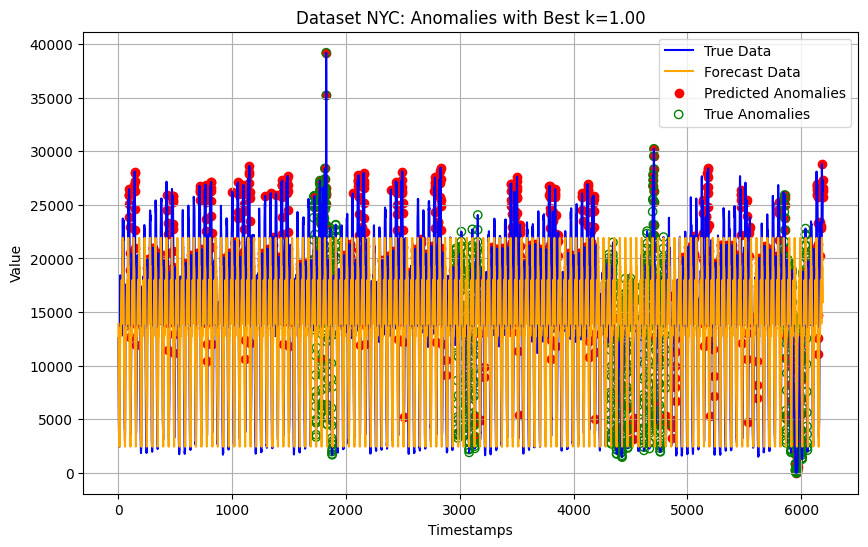

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Extract data and labels
data1 = data['realKnownCause']["nyc_taxi.csv"]["value"].values.astype(float)
labels = data['realKnownCause']["nyc_taxi.csv"]['label'].values.astype(int)  # True anomaly labels (0 or 1)

# Simple train-test split
train_size = int(len(data1) * 0.4)  # 40% train, 60% test
y_train, y_test = data1[:train_size], data1[train_size:]
true_anomalies = labels[train_size:]  # True labels for test set

best_k = None
best_f1 = -1
best_predicted_anomalies = None

# Iterate over different values of k
for k in np.arange(1, 4.5, 0.5):  # Test k values from 1 to 4.5 in 0.5 steps
    # Apply exponential smoothing on the training data
    model = ExponentialSmoothing(y_train, trend=None, seasonal="add", seasonal_periods=48, initialization_method="estimated")
    model_fit = model.fit()

    # Forecast on the test data
    forecast = model_fit.forecast(steps=len(y_test))

    # Calculate residuals
    residuals = np.abs(y_test - forecast)

    # Determine anomalies using mean+k*std threshold
    mean_resid = np.mean(residuals)
    std_resid = np.std(residuals)
    threshold = mean_resid + k * std_resid

    predicted_anomalies = (residuals > threshold).astype(int)

    # Compute F1 score for the current k
    precision = precision_score(true_anomalies, predicted_anomalies)
    recall = recall_score(true_anomalies, predicted_anomalies)
    f1 = f1_score(true_anomalies, predicted_anomalies)

    # Check if this k is the best so far
    if f1 > best_f1:
        best_f1 = f1
        best_k = k
        best_predicted_anomalies = predicted_anomalies

print(f"Dataset NYC: Best k={best_k:.2f}, Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}")

# Plot the testing section for the dataset
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='True Data', color='blue')
plt.plot(forecast, label='Forecast Data', color='orange')
anomaly_indices = np.where(np.array(best_predicted_anomalies) == 1)[0]
plt.scatter(anomaly_indices, np.array(y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
plt.scatter(np.where(np.array(true_anomalies) == 1)[0], np.array(y_test)[np.where(np.array(true_anomalies) == 1)[0]],
            color='green', label='True Anomalies', facecolors="none", marker='o')
plt.legend()
plt.title(f"Dataset NYC: Anomalies with Best k={best_k:.2f}")
plt.xlabel('Timestamps')
plt.ylabel('Value')
plt.grid()
plt.show()


In [ ]:
data['realKnownCause']["nyc_taxi.csv"].shape

(10320, 3)

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

10000
Window 0: (5839, 6045), Detection t=-2.155, Contribution=1.000
Window 3: (8731, 8937), Detection t=-2.010, Contribution=1.000
Window 4: (9977, 10183), Detection t=-2.107, Contribution=1.000
False positive detection at 589, Contribution=-1.000
False positive detection at 590, Contribution=-1.000
False positive detection at 591, Contribution=-1.000
False positive detection at 592, Contribution=-1.000
False positive detection at 593, Contribution=-1.000
False positive detection at 594, Contribution=-1.000
False positive detection at 595, Contribution=-1.000
False positive detection at 928, Contribution=-1.000
False positive detection at 929, Contribution=-1.000
False positive detection at 1215, Contribution=-1.000
False positive detection at 1216, Contribution=-1.000
False positive detection at 1549, Contribution=-1.000
False positive detection at 1550, Contribution=-1.000
False positive detection at 1551, Contribution=-1.000
False positive detection at 1552, Contribution=-1.000
Fal

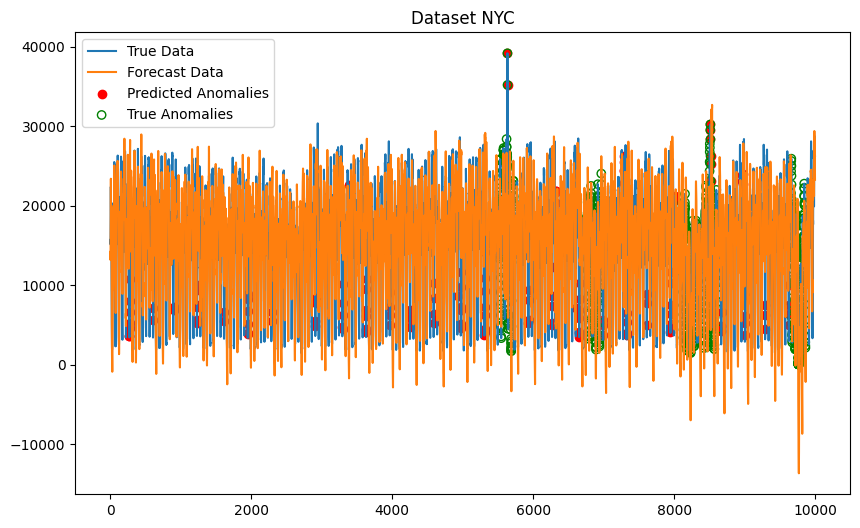

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.holtwinters import ExponentialSmoothing


# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=500)

# Extract data and labels
data1 = data['realKnownCause']["nyc_taxi.csv"]["value"].values.astype(float)
labels = data['realKnownCause']["nyc_taxi.csv"]['label'].values.astype(int)  # True anomaly labels (0 or 1)

combined_residuals = []
combined_forecast = []
combined_y_test = []
combined_true_anomalies = []

for train_index, test_index in tscv.split(data1):
    y_train, y_test = data1[train_index], data1[test_index]
    true_anomalies = labels[test_index]  # True labels for test set

    # Apply exponential smoothing on the training data
    model = ExponentialSmoothing(y_train, trend=None, seasonal="add", seasonal_periods=48, initialization_method="estimated")
    model_fit = model.fit()

    # Forecast on the test data
    forecast = model_fit.forecast(steps=len(y_test))

    # Calculate residuals
    residuals = np.abs(y_test - forecast)

    # Append data for combined evaluation
    combined_residuals.extend(residuals)
    combined_forecast.extend(forecast)
    combined_y_test.extend(y_test)
    combined_true_anomalies.extend(true_anomalies)

# Calculate static mean and std of residuals
mean_residuals = np.mean(combined_residuals)
std_residuals = np.std(combined_residuals)

# Static threshold
threshold = mean_residuals + 3 * std_residuals
predicted_anomalies = (np.array(combined_residuals) > threshold).astype(int)
print(len(predicted_anomalies))

# Convert binary predictions to detection timestamps
detections = [i + 320 for i, x in enumerate(predicted_anomalies) if x == 1]

# Compute the NAB score
nab_score = compute_raw_score_debug(detections, anomaly_windows["nyc_taxi.csv"], A_tp = 1.0, A_fp = -0.11, A_fn = -1.0)


# Compute F1 score for the current k
precision = precision_score(combined_true_anomalies, predicted_anomalies)
recall = recall_score(combined_true_anomalies, predicted_anomalies)
f1 = f1_score(combined_true_anomalies, predicted_anomalies)

print(f"Dataset NYC:  Precision={precision:.2f}, Recall={recall:.2f}, F1={best_f1:.2f}, NAB Score: {nab_score}")

# Plot the combined testing section for the dataset
plt.figure(figsize=(10, 6))
plt.plot(combined_y_test, label='True Data')
plt.plot(combined_forecast, label='Forecast Data')
anomaly_indices = np.where(predicted_anomalies == 1)[0]
plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
            color='green', label='True Anomalies', facecolors="none", marker='o')
plt.legend()
plt.title(f"Dataset NYC")
plt.show()




/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_

5000
Window 0: (5839, 6045), Detection t=-1.883, Contribution=1.000
Window 4: (9977, 10183), Detection t=-1.408, Contribution=0.998
False positive detection at 10189, Contribution=-1.000
False positive detection at 10190, Contribution=-1.000
False positive detection at 10191, Contribution=-1.000
False positive detection at 10192, Contribution=-1.000
False positive detection at 10193, Contribution=-1.000
False positive detection at 10194, Contribution=-1.000
False positive detection at 10195, Contribution=-1.000
False positive detection at 10196, Contribution=-1.000
False positive detection at 10237, Contribution=-1.000
False positive detection at 10238, Contribution=-1.000
False positive detection at 10239, Contribution=-1.000
False positive detection at 10240, Contribution=-1.000
False positive detection at 10241, Contribution=-1.000
False positive detection at 10242, Contribution=-1.000
False positive detection at 10243, Contribution=-1.000
False positive detection at 10244, Contribu

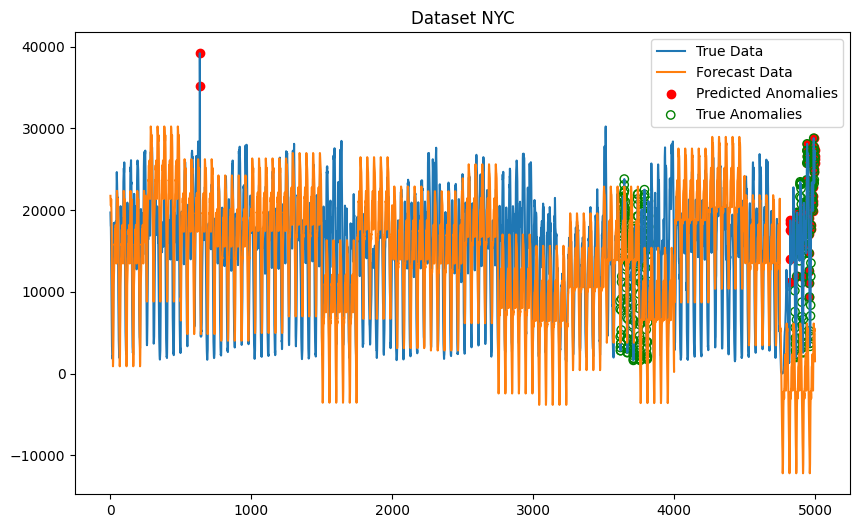

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.holtwinters import ExponentialSmoothing


# Storage for metrics
all_precisions = []
all_recalls = []
all_f1_scores = []

# TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=20,test_size=250)

# Extract data and labels
data1 = data['realKnownCause']["nyc_taxi.csv"]["value"].values.astype(float)
labels = data['realKnownCause']["nyc_taxi.csv"]['label'].values.astype(int)  # True anomaly labels (0 or 1)

# Train-Test Split
train_size = int(len(data1) * 0.3)
train_data = data1[:train_size]
test_data = data1[train_size:]
test_labels = labels[train_size:]

combined_residuals = []
combined_forecast = []
combined_y_test = []
combined_true_anomalies = []

for train_index, test_index in tscv.split(test_data):
    y_train, y_test = test_data[train_index], test_data[test_index]
    true_anomalies = labels[test_index]  # True labels for test set

    # Apply exponential smoothing on the training data
    model = ExponentialSmoothing(y_train, trend=None, seasonal="add", seasonal_periods=48, initialization_method="estimated")
    model_fit = model.fit()

    # Forecast on the test data
    forecast = model_fit.forecast(steps=len(y_test))

    # Calculate residuals
    residuals = np.abs(y_test - forecast)

    # Append data for combined evaluation
    combined_residuals.extend(residuals)
    combined_forecast.extend(forecast)
    combined_y_test.extend(y_test)
    combined_true_anomalies.extend(true_anomalies)

# Calculate static mean and std of residuals
mean_residuals = np.mean(combined_residuals)
std_residuals = np.std(combined_residuals)

# Static threshold
threshold = mean_residuals + 3 * std_residuals
predicted_anomalies = (np.array(combined_residuals) > threshold).astype(int)
print(len(predicted_anomalies))

# Convert binary predictions to detection timestamps
detections = [i + 5320 for i, x in enumerate(predicted_anomalies) if x == 1]

# Compute the NAB score
nab_score = compute_raw_score_debug(detections, anomaly_windows["nyc_taxi.csv"], A_tp = 1.0, A_fp = -0.11, A_fn = -1.0)


# Compute F1 score for the current k
precision = precision_score(combined_true_anomalies, predicted_anomalies)
recall = recall_score(combined_true_anomalies, predicted_anomalies)
f1 = f1_score(combined_true_anomalies, predicted_anomalies)

print(f"Dataset NYC:  Precision={precision:.2f}, Recall={recall:.2f}, F1={f1:.2f}, NAB Score: {nab_score}")

# Plot the combined testing section for the dataset
plt.figure(figsize=(10, 6))
plt.plot(combined_y_test, label='True Data')
plt.plot(combined_forecast, label='Forecast Data')
anomaly_indices = np.where(predicted_anomalies == 1)[0]
plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
            color='green', label='True Anomalies', facecolors="none", marker='o')
plt.legend()
plt.title(f"Dataset NYC")
plt.show()




## SARIMA

In [ ]:
data['realKnownCause']["nyc_taxi.csv"].shape[0]

10320

In [ ]:
0.7*10320-5000

2223.999999999999

In [ ]:
0.3*10320

3096.0

Best SARIMA Order (Training): (2, 0, 1)
Training MAE: 596.8657
Window 0: (5839, 6045), Detection t=-2.388, Contribution=1.000
Window 2: (8423, 8629), Missed anomaly window. Penalty=-1.000
Window 3: (8731, 8937), Missed anomaly window. Penalty=-1.000
Window 4: (9977, 10183), Missed anomaly window. Penalty=-1.000
False positive detection at 6950, Contribution=-1.000
False positive detection at 8247, Contribution=-1.000
False positive detection at 8248, Contribution=-1.000
Raw score for dataset: -5.000
Precision: 0.50, Recall: 0.00, F1: 0.01, NAB Score: -5.0000


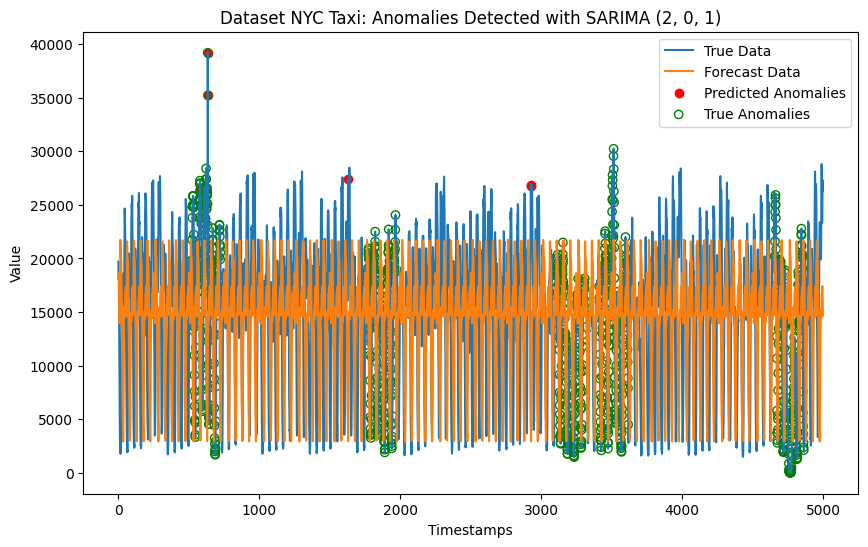

In [ ]:
import numpy as np
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
import matplotlib.pyplot as plt

# Extract data and labels
data1 = data['realKnownCause']["nyc_taxi.csv"]["value"].values.astype(float)
labels = data['realKnownCause']["nyc_taxi.csv"]['label'].values.astype(int)  # True anomaly labels (0 or 1)

# Train-Test Split
train_size = int(len(data1) * 0.3)
train_data = data1[:train_size]
test_data = data1[train_size:]
test_labels = labels[train_size:]

# SARIMA Parameters
p_values = [2]
q_values = [1]
seasonal_params = (2, 1, 1, 48)  # Seasonal P, Q, D, m (48 corresponds to daily seasonality for 30-min data)

# Train the SARIMA model on the training data
best_mae_train = float("inf")
best_order_train = None
best_model_train = None

for p in p_values:
    for q in q_values:
        try:
            model = SARIMAX(
                train_data,
                order=(p, 0, q),
                seasonal_order=seasonal_params,
                enforce_stationarity=False,
                enforce_invertibility=False,
            )
            results = model.fit(disp=False)
            mae = mean_absolute_error(train_data, results.fittedvalues)

            if mae < best_mae_train:
                best_mae_train = mae
                best_order_train = (p, 0, q)
                best_model_train = results
        except Exception as e:
            print(f"Error for SARIMA({p}, 0, {q}): {e}")

print(f"Best SARIMA Order (Training): {best_order_train}")
print(f"Training MAE: {best_mae_train:.4f}")

# Evaluate the model on the test data using TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=20, test_size=250)
combined_residuals = []
combined_forecast = []
combined_y_test = []
combined_true_anomalies = []

for train_idx, val_idx in tscv.split(test_data):
    fold_train, fold_val = test_data[train_idx], test_data[val_idx]
    true_anomalies = test_labels[val_idx]  # True labels for the validation set

    # Forecast using the trained model
    forecast = best_model_train.get_forecast(steps=len(fold_val)).predicted_mean

    # Calculate residuals
    residuals = np.abs(fold_val - forecast)

    # Append data for evaluation
    combined_residuals.extend(residuals)
    combined_forecast.extend(forecast)
    combined_y_test.extend(fold_val)
    combined_true_anomalies.extend(true_anomalies)

# Determine threshold for anomalies
mean_residuals = np.mean(combined_residuals)
std_residuals = np.std(combined_residuals)
threshold = mean_residuals + 3 * std_residuals

# Anomaly detection
predicted_anomalies = (np.array(combined_residuals) > threshold).astype(int)

# Compute NAB score
detections = [i + 5320 for i, x in enumerate(predicted_anomalies) if x == 1]
nab_score = compute_raw_score_debug(detections, anomaly_windows["nyc_taxi.csv"], A_tp=1.0, A_fp=-0.11, A_fn=-1.0)

# Evaluate performance
precision = precision_score(combined_true_anomalies, predicted_anomalies)
recall = recall_score(combined_true_anomalies, predicted_anomalies)
f1 = f1_score(combined_true_anomalies, predicted_anomalies)

print(f"Precision: {precision:.2f}, Recall: {recall:.2f}, F1: {f1:.2f}, NAB Score: {nab_score:.4f}")

# Plot results
plt.figure(figsize=(10, 6))
plt.plot(combined_y_test, label='True Data')
plt.plot(combined_forecast, label='Forecast Data')
anomaly_indices = np.where(predicted_anomalies == 1)[0]
plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
            color='green', label='True Anomalies', facecolors="none", marker='o')
plt.legend()
plt.title(f"Dataset NYC Taxi: Anomalies Detected with SARIMA {best_order_train}")
plt.xlabel('Timestamps')
plt.ylabel('Value')
plt.show()


In [ ]:
import numpy as np
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
import matplotlib.pyplot as plt

# Extract data and labels
data1 = data['realKnownCause']["nyc_taxi.csv"]["value"].values.astype(float)
labels = data['realKnownCause']["nyc_taxi.csv"]['label'].values.astype(int)  # True anomaly labels (0 or 1)

# Train-Test Split
train_size = int(len(data1) * 0.3)
train_data = data1[:train_size]
test_data = data1[train_size:]
test_labels = labels[train_size:]

# SARIMA Parameters
p_values = [2]
q_values = [1]
seasonal_params = (2, 1, 1, 48)  # Seasonal P, Q, D, m (48 corresponds to daily seasonality for 30-min data)

# Train the SARIMA model on the training data
best_mae_train = float("inf")
best_order_train = None
best_model_train = None

for p in p_values:
    for q in q_values:
        try:
            model = SARIMAX(
                train_data,
                order=(p, 0, q),
                seasonal_order=seasonal_params,
                enforce_stationarity=False,
                enforce_invertibility=False,
            )
            results = model.fit(disp=False)
            mae = mean_absolute_error(train_data, results.fittedvalues)

            if mae < best_mae_train:
                best_mae_train = mae
                best_order_train = (p, 0, q)
                best_model_train = results
        except Exception as e:
            print(f"Error for SARIMA({p}, 0, {q}): {e}")

print(f"Best SARIMA Order (Training): {best_order_train}")
print(f"Training MAE: {best_mae_train:.4f}")

# Evaluate the model on the test data using TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=25, test_size=200)
combined_residuals = []
combined_forecast = []
combined_y_test = []
combined_true_anomalies = []

for train_idx, val_idx in tscv.split(test_data):
    fold_train, fold_val = test_data[train_idx], test_data[val_idx]
    true_anomalies = test_labels[val_idx]  # True labels for the validation set

    # Forecast using the trained model
    forecast = best_model_train.get_forecast(steps=len(fold_val)).predicted_mean

    # Calculate residuals
    residuals = np.abs(fold_val - forecast)

    # Append data for evaluation
    combined_residuals.extend(residuals)
    combined_forecast.extend(forecast)
    combined_y_test.extend(fold_val)
    combined_true_anomalies.extend(true_anomalies)

# Determine threshold for anomalies
mean_residuals = np.mean(combined_residuals)
std_residuals = np.std(combined_residuals)
threshold = mean_residuals + 3 * std_residuals

# Anomaly detection
predicted_anomalies = (np.array(combined_residuals) > threshold).astype(int)

# Compute NAB score
detections = [i + 5320 for i, x in enumerate(predicted_anomalies) if x == 1]
nab_score = compute_raw_score_debug(detections, anomaly_windows["nyc_taxi.csv"], A_tp=1.0, A_fp=-0.11, A_fn=-1.0)

# Evaluate performance
precision = precision_score(combined_true_anomalies, predicted_anomalies)
recall = recall_score(combined_true_anomalies, predicted_anomalies)
f1 = f1_score(combined_true_anomalies, predicted_anomalies)

print(f"Precision: {precision:.2f}, Recall: {recall:.2f}, F1: {f1:.2f}, NAB Score: {nab_score:.4f}")

# Plot results
plt.figure(figsize=(10, 6))
plt.plot(combined_y_test, label='True Data')
plt.plot(combined_forecast, label='Forecast Data')
anomaly_indices = np.where(predicted_anomalies == 1)[0]
plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
            color='green', label='True Anomalies', facecolors="none", marker='o')
plt.legend()
plt.title(f"Dataset NYC Taxi: Anomalies Detected with SARIMA {best_order_train}")
plt.xlabel('Timestamps')
plt.ylabel('Value')
plt.show()


In [ ]:
import numpy as np
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.model_selection import TimeSeriesSplit
import matplotlib.pyplot as plt

# ✅ Extract data and labels properly
df = data["realKnownCause"]["nyc_taxi.csv"]
data1 = df["value"].values.astype(float)
labels = df["label"].values.astype(int)  # True anomaly labels (0 or 1)

# ✅ SARIMA Parameters
p, d, q = 2, 0, 1
P, D, Q, m = 2, 1, 1, 48  # Seasonal (P, D, Q, m)

# ✅ TimeSeriesSplit for cross-validation
tscv = TimeSeriesSplit(n_splits=20, test_size=250)

# ✅ Store results
combined_residuals = []
combined_forecast = []
combined_y_test = []
combined_true_anomalies = []

# ✅ Perform SARIMA training and forecasting in each TSCV split
for train_idx, val_idx in tscv.split(data1):
    train_data, val_data = data1[train_idx], data1[val_idx]
    true_anomalies = labels[val_idx]  # True labels for validation

    # ✅ Train SARIMA on each fold
    try:
        model = SARIMAX(
            train_data,
            order=(p, d, q),
            seasonal_order=(P, D, Q, m),
            enforce_stationarity=False,
            enforce_invertibility=False,
        )
        results = model.fit(disp=False)

        # ✅ Forecast using trained model
        forecast = results.forecast(steps=len(val_data))

        # ✅ Calculate residuals (absolute errors)
        residuals = np.abs(val_data - forecast)

        # ✅ Store results for later evaluation
        combined_residuals.extend(residuals)
        combined_forecast.extend(forecast)
        combined_y_test.extend(val_data)
        combined_true_anomalies.extend(true_anomalies)

    except Exception as e:
        print(f"Error in fold {len(combined_residuals)//250 + 1}: {e}")
        continue  # Skip problematic fold

# ✅ Determine threshold for anomalies (Mean + 3 * Std)
mean_residuals = np.mean(combined_residuals)
std_residuals = np.std(combined_residuals)
threshold = mean_residuals + 3 * std_residuals

# ✅ Anomaly Detection
predicted_anomalies = (np.array(combined_residuals) > threshold).astype(int)

# Compute NAB score
detections = [i for i, x in enumerate(predicted_anomalies) if x == 1]
nab_score = compute_raw_score_debug(detections, anomaly_windows["nyc_taxi.csv"], A_tp=1.0, A_fp=-0.11, A_fn=-1.0)

# Evaluate performance
precision = precision_score(combined_true_anomalies, predicted_anomalies)
recall = recall_score(combined_true_anomalies, predicted_anomalies)
f1 = f1_score(combined_true_anomalies, predicted_anomalies)

print(f"Precision: {precision:.2f}, Recall: {recall:.2f}, F1: {f1:.2f}, NAB Score: {nab_score:.4f}")

# Plot results
plt.figure(figsize=(10, 6))
plt.plot(combined_y_test, label='True Data')
plt.plot(combined_forecast, label='Forecast Data')
anomaly_indices = np.where(predicted_anomalies == 1)[0]
plt.scatter(anomaly_indices, np.array(combined_y_test)[anomaly_indices], color='red', label='Predicted Anomalies')
plt.scatter(np.where(np.array(combined_true_anomalies) == 1)[0], np.array(combined_y_test)[np.where(np.array(combined_true_anomalies) == 1)[0]],
            color='green', label='True Anomalies', facecolors="none", marker='o')
plt.legend()
plt.title(f"Dataset NYC Taxi: Anomalies Detected with SARIMA {best_order_train}")
plt.xlabel('Timestamps')
plt.ylabel('Value')
plt.show()


In [ ]:
len(predicted_anomalies)

5000

In [ ]:
(10320*0.6)/10

619.2

In [ ]:
import warnings                                  # `do not disturbe` mode
warnings.filterwarnings('ignore')

import numpy as np                               # vectors and matrices
import pandas as pd                              # tables and data manipulations
import matplotlib.pyplot as plt                  # plots
import seaborn as sns                            # more plots

from dateutil.relativedelta import relativedelta # working with dates with style
from scipy.optimize import minimize              # for function minimization

import statsmodels.formula.api as smf            # statistics and econometrics
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs

from itertools import product                    # some useful functions
from tqdm import tqdm_notebook

%matplotlib inline

def tsplot(y, lags=None, figsize=(12, 7), style='bmh'):
    """
        Plot time series, its ACF and PACF, calculate Dickey–Fuller test

        y - timeseries
        lags - how many lags to include in ACF, PACF calculation
    """
    if not isinstance(y, pd.Series):
        y = pd.Series(y)

    with plt.style.context(style):
        fig = plt.figure(figsize=figsize)
        layout = (2, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))

        y.plot(ax=ts_ax)
        p_value = sm.tsa.stattools.adfuller(y)[1]
        ts_ax.set_title('Time Series Analysis Plots\n Dickey-Fuller: p={0:.5f}'.format(p_value))
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax)
        plt.tight_layout()

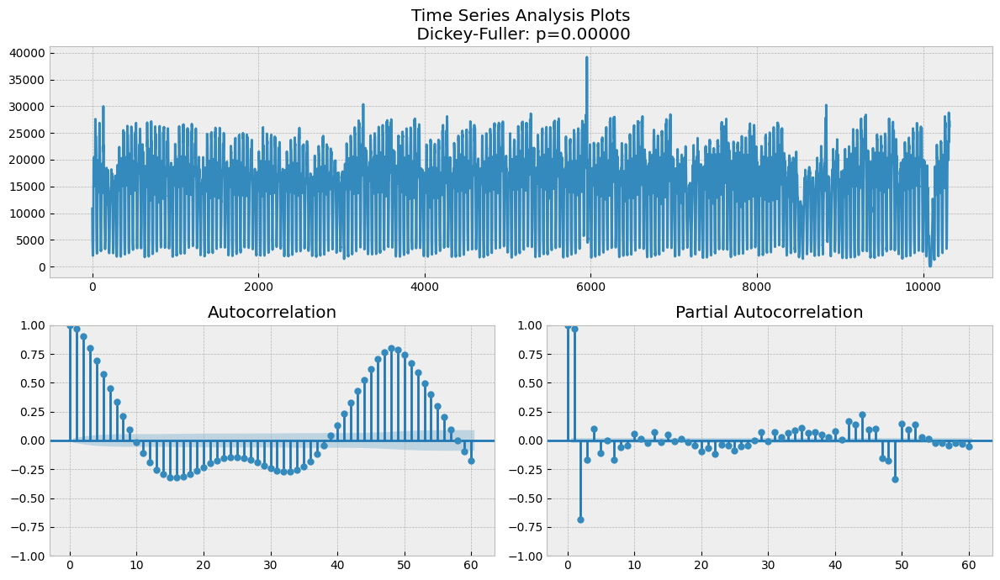

In [ ]:
nyc = data['realKnownCause']["nyc_taxi.csv"]["value"]
tsplot(nyc, 60)

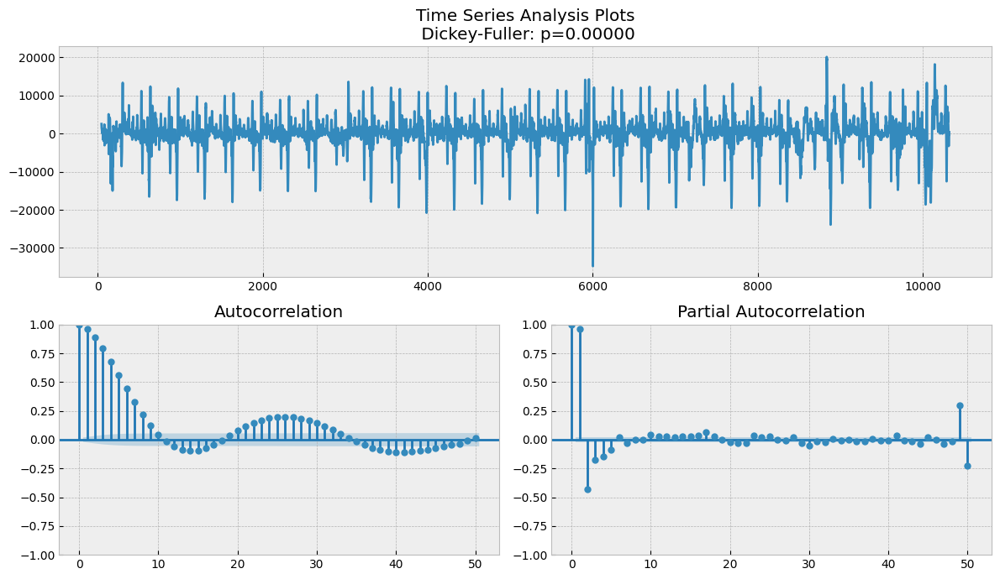

In [ ]:
nyc_diff = nyc - nyc.shift(48)
tsplot(nyc_diff[48:], lags=50)

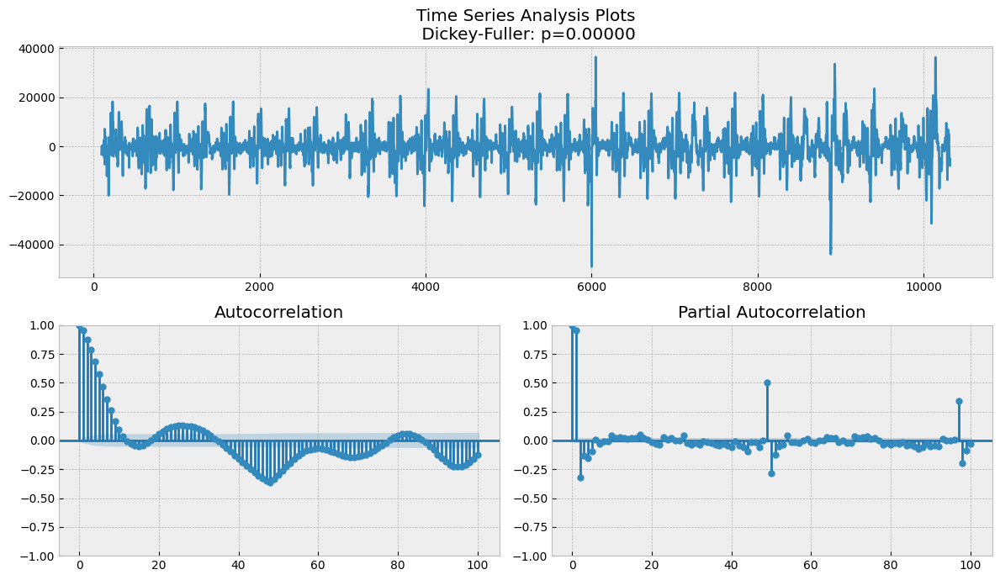

In [ ]:
nyc_diff2 = nyc_diff - nyc_diff.shift(48)
tsplot(nyc_diff2[(48+48):], lags=100)

In [ ]:
import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error

candidate_models = [
    (2, 0, 0, 1, 1, 1, 48),  # (p, d, q, P, D, Q, m)
    (2, 0, 0, 1, 1, 1, 48),
    (2, 0, 1, 2, 1, 1, 48),
    (2, 0, 1, 2, 1, 2, 48)
]

y = data['realKnownCause']["nyc_taxi.csv"]["value"].values.astype(float)

# Define train and test set (90% train, 10% test)
train_size = int(len(y) * 0.4)
half_data = int(len(y)* 0.5)
y_train, y_test = y[:train_size], y[train_size:half_data]

# Store model results
model_performance = {}

# Evaluate each SARIMA model
for p, d, q, P, D, Q, m in candidate_models:
    print(f"Evaluating SARIMA({p},{d},{q})({P},{D},{Q},{m})")

    # Fit SARIMA model
    model = sm.tsa.statespace.SARIMAX(y_train,
                                      order=(p, d, q),
                                      seasonal_order=(P, D, Q, m),
                                      enforce_stationarity=False,
                                      enforce_invertibility=False)

    results = model.fit(disp=False)

    # Make predictions on last 10% test set
    y_pred = results.predict(start=len(y_train), end=half_data-1, dynamic=False)

    # Compute MAE
    mae = mean_absolute_error(y_test, y_pred)
    print(f"MAE: {mae:.4f}")

    # Store results
    model_performance[(p, d, q, P, D, Q, m)] = mae

# Select the best SARIMA model
best_model_params = min(model_performance, key=model_performance.get)
best_mae = model_performance[best_model_params]

print("\nBest SARIMA Model:", best_model_params)
print("Best Model MAE:", best_mae)


Evaluating SARIMA(2,0,0)(1,1,1,48)
MAE: 2669.8414
Evaluating SARIMA(2,0,0)(1,1,1,48)
MAE: 2669.8414
Evaluating SARIMA(2,0,1)(2,1,1,48)


In [ ]:
import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error

candidate_models = [
    (2, 0, 1, 2, 1, 1, 48)
]

y = data['realKnownCause']["nyc_taxi.csv"]["value"].values.astype(float)

# Define train and test set (90% train, 10% test)
train_size = int(len(y) * 0.4)
half_data = int(len(y)* 0.5)
y_train, y_test = y[:train_size], y[train_size:half_data]

# Store model results
model_performance = {}

# Evaluate each SARIMA model
for p, d, q, P, D, Q, m in candidate_models:
    print(f"Evaluating SARIMA({p},{d},{q})({P},{D},{Q},{m})")

    # Fit SARIMA model
    model = sm.tsa.statespace.SARIMAX(y_train,
                                      order=(p, d, q),
                                      seasonal_order=(P, D, Q, m),
                                      enforce_stationarity=False,
                                      enforce_invertibility=False)

    results = model.fit(disp=False)

    # Make predictions on last 10% test set
    y_pred = results.predict(start=len(y_train), end=half_data-1, dynamic=False)

    # Compute MAE
    mae = mean_absolute_error(y_test, y_pred)
    print(f"MAE: {mae:.4f}")

    # Store results
    model_performance[(p, d, q, P, D, Q, m)] = mae

# Select the best SARIMA model
best_model_params = min(model_performance, key=model_performance.get)
best_mae = model_performance[best_model_params]

print("\nBest SARIMA Model:", best_model_params)
print("Best Model MAE:", best_mae)


Evaluating SARIMA(2,0,1)(2,1,1,48)
MAE: 2626.4012

Best SARIMA Model: (2, 0, 1, 2, 1, 1, 48)
Best Model MAE: 2626.401226654998


In [ ]:
import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error

candidate_models = [
    (2, 0, 1, 2, 1, 2, 48)
]

y = data['realKnownCause']["nyc_taxi.csv"]["value"].values.astype(float)

# Define train and test set (90% train, 10% test)
train_size = int(len(y) * 0.4)
half_data = int(len(y)* 0.5)
y_train, y_test = y[:train_size], y[train_size:half_data]

# Store model results
model_performance = {}

# Evaluate each SARIMA model
for p, d, q, P, D, Q, m in candidate_models:
    print(f"Evaluating SARIMA({p},{d},{q})({P},{D},{Q},{m})")

    # Fit SARIMA model
    model = sm.tsa.statespace.SARIMAX(y_train,
                                      order=(p, d, q),
                                      seasonal_order=(P, D, Q, m),
                                      enforce_stationarity=False,
                                      enforce_invertibility=False)

    results = model.fit(disp=False)

    # Make predictions on last 10% test set
    y_pred = results.predict(start=len(y_train), end=half_data-1, dynamic=False)

    # Compute MAE
    mae = mean_absolute_error(y_test, y_pred)
    print(f"MAE: {mae:.4f}")

    # Store results
    model_performance[(p, d, q, P, D, Q, m)] = mae

# Select the best SARIMA model
best_model_params = min(model_performance, key=model_performance.get)
best_mae = model_performance[best_model_params]

print("\nBest SARIMA Model:", best_model_params)
print("Best Model MAE:", best_mae)


Evaluating SARIMA(2,0,1)(2,1,2,48)


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
